In [46]:
# ============================== loading libraries ===========================================
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")

import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cross_validation import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score
from sklearn.cross_validation import cross_val_score
from collections import Counter
from sklearn.metrics import accuracy_score
from sklearn import cross_validation
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import f1_score
from sklearn.model_selection import GridSearchCV
from sklearn.datasets import *
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import classification_report
from prettytable import PrettyTable
import random
from scipy.stats import uniform
from sklearn.metrics import roc_curve, auc
from sklearn.learning_curve import validation_curve
from sklearn.metrics import fbeta_score, make_scorer
from sklearn.metrics import precision_score, recall_score,roc_auc_score
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from sklearn.feature_selection import SelectFromModel
from sklearn.preprocessing import StandardScaler
from sklearn.calibration import CalibratedClassifierCV
import joblib
from sklearn.svm import SVC
from sklearn import svm
from sklearn import linear_model
from scipy import stats
import scikitplot as skplt
from wordcloud import WordCloud, STOPWORDS 

import sqlite3
import pandas as pd
import numpy as np
import nltk
import string
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import DBSCAN


from sklearn.ensemble import RandomForestClassifier

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics import confusion_matrix
from sklearn import metrics
from sklearn.metrics import roc_curve, auc
from nltk.stem.porter import PorterStemmer

#import nltk
#nltk.download('stopwords')

import re
# Tutorial about Python regular expressions: https://pymotw.com/2/re/
import string
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.stem.wordnet import WordNetLemmatizer

#from gensim.models import KeyedVectors
#model = KeyedVectors.load_word2vec_format(‘GoogleNews-vectors-negative300.bin.gz’,binary=True)

#import gensim
from gensim.models import Word2Vec
from gensim.models import KeyedVectors
from sklearn.decomposition import TruncatedSVD
from sklearn import tree
import graphviz 

import xgboost as xgb

# =============================================================================================

In [47]:
fileObject = open("./train_to_file.pkl",'rb') # we open the file for reading 
X_train = pickle.load(fileObject) # load the object from the file

fileObject = open("./x_cv_to_file.pkl",'rb') # we open the file for reading 
X_cv = pickle.load(fileObject) # load the object from the file

fileObject = open("./x_test_to_file.pkl",'rb') # we open the file for reading 
X_test = pickle.load(fileObject) # load the object from the file

fileObject = open("./y_train_to_file.pkl",'rb') # we open the file for reading 
y_train = pickle.load(fileObject) # load the object from the file

fileObject = open("./y_cv_to_file.pkl",'rb') # we open the file for reading 
y_cv = pickle.load(fileObject) # load the object from the file

fileObject = open("./y_test_to_file.pkl",'rb') # we open the file for reading 
y_test = pickle.load(fileObject) # load the object from the file

In [48]:
fileObject = open("./final_to_file2.pkl",'rb') # we open the file for reading 
final2 = pickle.load(fileObject) # load the object from the file

In [49]:
final2

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,CleanedText
138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,1,939340800,EVERY book is educational,this witty little book makes my son laugh at l...,witti littl book make son laugh loud recit car...
138683,150501,0006641040,AJ46FKXOVC7NR,Nicholas A Mesiano,2,2,1,940809600,This whole series is great way to spend time w...,I can remember seeing the show when it aired o...,rememb see show air televis year ago child sis...
417839,451856,B00004CXX9,AIUWLEQ1ADEG5,Elizabeth Medina,0,0,1,944092800,Entertainingl Funny!,Beetlejuice is a well written movie ..... ever...,beetlejuic well written movi everyth excel act...
417859,451878,B00004CXX9,A344SMIA5JECGM,Vincent P. Ross,1,2,1,944438400,A modern day fairy tale,"A twist of rumplestiskin captured on film, sta...",twist rumplestiskin captur film star michael k...
417838,451855,B00004CXX9,AJH6LUC1UT1ON,The Phantom of the Opera,0,0,1,946857600,FANTASTIC!,Beetlejuice is an excellent and funny movie. K...,beetlejuic excel funni movi keaton hilari wack...
417927,451949,B00004CXX9,A1048CYU0OV4O8,Judy L. Eans,2,2,1,947376000,GREAT,THIS IS ONE MOVIE THAT SHOULD BE IN YOUR MOVIE...,one movi movi collect fill comedi action whate...
417847,451864,B00004CXX9,A1B2IZU1JLZA6,Wes,19,23,0,948240000,WARNING: CLAMSHELL EDITION IS EDITED TV VERSION,"I, myself always enjoyed this movie, it's very...",alway enjoy movi funni entertain didnt hesit p...
70688,76882,B00002N8SM,A32DW342WBJ6BX,Buttersugar,0,0,1,948672000,A sure death for flies,I bought a few of these after my apartment was...,bought apart infest fruit fli hour trap mani f...
346141,374450,B00004CI84,ACJR7EQF9S6FP,Jeremy Robertson,2,3,1,951523200,Bettlejuice...Bettlejuice...BETTLEJUICE!,What happens when you say his name three times...,happen say name three time michael keaten star...
417883,451903,B00004CXX9,A2DEE7F9XKP3ZR,jerome,0,1,1,959990400,Research,I'm getting crazy.<p>Is it really impossible t...,get crazi realli imposs today find french vhs ...


## BoW

In [50]:
#Appling BoW to fit and transform
count_vect =  CountVectorizer()
bow_NB = count_vect.fit(X_train[:,9])
train_bow_nstd = count_vect.transform(X_train[:,9])
cv_bow_nstd = count_vect.transform(X_cv[:,9]) 
test_bow_nstd = count_vect.transform(X_test[:,9]) 

print("the type of count vectorizer ",type(train_bow_nstd))
print("the number of unique words ", test_bow_nstd.get_shape()[1])

print(train_bow_nstd.shape)
print(cv_bow_nstd.shape)
print(test_bow_nstd.shape)
print(y_train.shape)
print(y_cv.shape)
print(y_test.shape)

the type of count vectorizer  <class 'scipy.sparse.csr.csr_matrix'>
the number of unique words  37996
(38400, 37996)
(9600, 37996)
(12000, 37996)
(38400,)
(9600,)
(12000,)


In [51]:
# Column Standardization of the BoW non-standard vector
std_scal = StandardScaler(with_mean=False)
std_scal.fit(train_bow_nstd)
train_bow = std_scal.transform(train_bow_nstd)
cv_bow = std_scal.transform(cv_bow_nstd)
test_bow = std_scal.transform(test_bow_nstd)

## TF-IDF

In [265]:
#tf-idf on train data
tf_idf_vect = TfidfVectorizer(ngram_range=(1,1)) #considering only uni-gram as I was getting memory error
train_tf_idf_nstd = tf_idf_vect.fit_transform(X_train[:,9]) #sparse matrix
cv_tfidf_nstd = tf_idf_vect.transform(X_cv[:,9])
test_tfidf_nstd = tf_idf_vect.transform(X_test[:,9])
print(train_tf_idf_nstd.shape)
print(cv_tfidf_nstd.shape)
print(test_tfidf_nstd.shape)

(38400, 37996)
(9600, 37996)
(12000, 37996)


In [266]:
# Column Standardization of the tfidf non-standard vector
std_scal = StandardScaler(with_mean=False)
std_scal.fit(train_tf_idf_nstd)
train_tfidf = std_scal.transform(train_tf_idf_nstd)
cv_tfidf = std_scal.transform(cv_tfidf_nstd)
test_tfidf = std_scal.transform(test_tfidf_nstd)

## Avg W2V

In [284]:
fileObject = open("./final_to_file2.pkl",'rb') # we open the file for reading 
final = pickle.load(fileObject) # load the object from the file

In [285]:
#w2v
# Train your own Word2Vec model using your own text corpus
i=0
list_of_sent=[]
for sent in final['CleanedText'].values:
    list_of_sent.append(sent.split())
    
print(type(list_of_sent))
print(final['CleanedText'].values[0])
print("*****************************************************************")
print(list_of_sent[0])

<class 'list'>
witti littl book make son laugh loud recit car drive along alway sing refrain hes learn whale india droop love new word book introduc silli classic book will bet son still abl recit memori colleg
*****************************************************************
['witti', 'littl', 'book', 'make', 'son', 'laugh', 'loud', 'recit', 'car', 'drive', 'along', 'alway', 'sing', 'refrain', 'hes', 'learn', 'whale', 'india', 'droop', 'love', 'new', 'word', 'book', 'introduc', 'silli', 'classic', 'book', 'will', 'bet', 'son', 'still', 'abl', 'recit', 'memori', 'colleg']


In [286]:
w2v_model=Word2Vec(list_of_sent,min_count=5,size=50, workers=4)
w2v_words = list(w2v_model.wv.vocab)

In [287]:
# average Word2Vec
# compute average word2vec for each review.
sent_vectors = []; # the avg-w2v for each sentence/review is stored in this list
for sent in list_of_sent: # for each review/sentence
    sent_vec = np.zeros(50) # as word vectors are of zero length
    cnt_words =0; # num of words with a valid vector in the sentence/review
    for word in sent: # for each word in a review/sentence
        if word in w2v_words:
            vec = w2v_model.wv[word]
            sent_vec += vec
            cnt_words += 1
    if cnt_words != 0:
        sent_vec /= cnt_words
    sent_vectors.append(sent_vec)
print(len(sent_vectors))
#print(len(sent_vectors[0]))
print(type(sent_vectors))

60000
<class 'list'>


In [288]:
# create design matrix X and target vector y
X = np.array(sent_vectors[::]) # end index is exclusive
y = np.array(final['Score']) # showing you two ways of indexing a pandas df

In [289]:
X_train_nstd = X[0:38400:1]
X_cv_nstd = X[38400:48000:1]
X_test_nstd = X[48000:60000:1]

y_train_nstd = y[0:38400:1]
y_cv_nstd = y[38400:48000:1]
y_test_nstd =y[48000:60000:1]

print(X_train_nstd.shape)
print(X_cv_nstd.shape)
print(X_test_nstd.shape)
print(y_train_nstd.shape)
print(y_cv_nstd.shape)
print(y_test_nstd.shape)

(38400, 50)
(9600, 50)
(12000, 50)
(38400,)
(9600,)
(12000,)


In [290]:
# Column Standardization of the tfidf non-standard vector
std_scal = StandardScaler(with_mean=False)
std_scal.fit(X_train_nstd)
train_avgw2v = std_scal.transform(X_train_nstd)
cv_avgw2v = std_scal.transform(X_cv_nstd)
test_avgw2v = std_scal.transform(X_test_nstd)

## tfidf-W-w2v

In [291]:
# S = ["abc def pqr", "def def def abc", "pqr pqr def"]
model = TfidfVectorizer()
tf_idf_matrix = model.fit_transform(final['CleanedText'].values)
# we are converting a dictionary with word as a key, and the idf as a value
dictionary = dict(zip(model.get_feature_names(), list(model.idf_)))

In [292]:
# TF-IDF weighted Word2Vec
tfidf_feat = model.get_feature_names() # tfidf words/col-names
# final_tf_idf is the sparse matrix with row= sentence, col=word and cell_val = tfidf

tfidf_sent_vectors = []; # the tfidf-w2v for each sentence/review is stored in this list
row=0;
for sent in (list_of_sent): # for each review/sentence 
    sent_vec = np.zeros(50) # as word vectors are of zero length
    weight_sum =0; # num of words with a valid vector in the sentence/review
    for word in sent: # for each word in a review/sentence
        if word in w2v_words:
            vec = w2v_model.wv[word]
#             tf_idf = tf_idf_matrix[row, tfidf_feat.index(word)]
            # to reduce the computation we are 
            # dictionary[word] = idf value of word in whole courpus
            # sent.count(word) = tf valeus of word in this review
            tf_idf = dictionary[word]*(sent.count(word)/len(sent))
            sent_vec += (vec * tf_idf)
            weight_sum += tf_idf
    if weight_sum != 0:
        sent_vec /= weight_sum
    tfidf_sent_vectors.append(sent_vec)
    row += 1

In [293]:
print(len(tfidf_sent_vectors))
print(np.shape(tfidf_sent_vectors))
print(type(tfidf_sent_vectors))

60000
(60000, 50)
<class 'list'>


In [294]:
# create design matrix X and target vector y
X = np.array(sent_vectors[::]) # end index is exclusive
y = np.array(final['Score']) # showing you two ways of indexing a pandas df

In [295]:
X_train_nstd = X[0:38400:1]
X_cv_nstd = X[38400:48000:1]
X_test_nstd = X[48000:60000:1]

y_train_nstd = y[0:38400:1]
y_cv_nstd = y[38400:48000:1]
y_test_nstd =y[48000:60000:1]

print(X_train_nstd.shape)
print(X_cv_nstd.shape)
print(X_test_nstd.shape)
print(y_train_nstd.shape)
print(y_cv_nstd.shape)
print(y_test_nstd.shape)

(38400, 50)
(9600, 50)
(12000, 50)
(38400,)
(9600,)
(12000,)


In [296]:
# Column Standardization of the tfidf non-standard vector
std_scal = StandardScaler(with_mean=False)
std_scal.fit(X_train_nstd)
train_tfidfww2v = std_scal.transform(X_train_nstd)
cv_tfidfww2v = std_scal.transform(X_cv_nstd)
test_tfidfww2v = std_scal.transform(X_test_nstd)

## K-Means on BoW

<function matplotlib.pyplot.show(*args, **kw)>

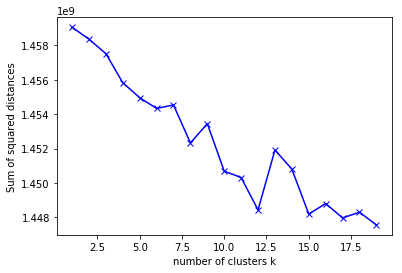

In [35]:
sum_squared_dist = []
K = range(1,20)
for k in K:
    km_bow = KMeans(n_clusters=k, random_state=0)
    km_bow = km_bow.fit(train_bow, y_train)
    sum_squared_dist.append(km_bow.inertia_)
plt.plot(K, sum_squared_dist, 'bx-')
plt.xlabel('number of clusters k')
plt.ylabel('Sum of squared distances')
plt.show

In [43]:
joblib.dump(sum_squared_dist,"sum_squared_dist.pkl")
joblib.dump(km_bow,"km_bow.pkl")

['km_bow.pkl']

In [66]:
sum_squared_dist = joblib.load("sum_squared_dist.pkl")
km_bow = joblib.load("km_bow.pkl")

In [187]:
#taking K=6 in for BoW
km_bow_best = KMeans(n_clusters=6, random_state=0)
km_bow_best = km_bow_best.fit(train_bow, y_train)

In [262]:
joblib.dump(km_bow_best,"km_bow_best.pkl")

['km_bow_best.pkl']

In [263]:
km_bow_best = joblib.load("km_bow_best.pkl")

In [188]:
labels = km_bow_best.labels_ 
print(np.shape(labels))
print(type(labels))
labels_df = pd.DataFrame(labels)
print(type(labels_df))
print(np.shape(labels_df))

(38400,)
<class 'numpy.ndarray'>
<class 'pandas.core.frame.DataFrame'>
(38400, 1)


In [189]:
#matching the number of rows
final3 = final2[0:38400]
print(type(final3))
print(final3.shape)
#final3

<class 'pandas.core.frame.DataFrame'>
(38400, 11)


In [196]:
#adding the values of labels in the data frame
final4 = final3
print(type(final4))
final4.reindex(columns=[*final4.columns.tolist(), 'labels'],fill_value=1)
final4['labels']=labels_df.values
final4

<class 'pandas.core.frame.DataFrame'>


,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,CleanedText,labels
138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,1,939340800,EVERY book is educational,this witty little book makes my son laugh at l...,witti littl book make son laugh loud recit car...,3
138683,150501,0006641040,AJ46FKXOVC7NR,Nicholas A Mesiano,2,2,1,940809600,This whole series is great way to spend time w...,I can remember seeing the show when it aired o...,rememb see show air televis year ago child sis...,3
417839,451856,B00004CXX9,AIUWLEQ1ADEG5,Elizabeth Medina,0,0,1,944092800,Entertainingl Funny!,Beetlejuice is a well written movie ..... ever...,beetlejuic well written movi everyth excel act...,3
417859,451878,B00004CXX9,A344SMIA5JECGM,Vincent P. Ross,1,2,1,944438400,A modern day fairy tale,"A twist of rumplestiskin captured on film, sta...",twist rumplestiskin captur film star michael k...,3
417838,451855,B00004CXX9,AJH6LUC1UT1ON,The Phantom of the Opera,0,0,1,946857600,FANTASTIC!,Beetlejuice is an excellent and funny movie. K...,beetlejuic excel funni movi keaton hilari wack...,3
417927,451949,B00004CXX9,A1048CYU0OV4O8,Judy L. Eans,2,2,1,947376000,GREAT,THIS IS ONE MOVIE THAT SHOULD BE IN YOUR MOVIE...,one movi movi collect fill comedi action whate...,3
417847,451864,B00004CXX9,A1B2IZU1JLZA6,Wes,19,23,0,948240000,WARNING: CLAMSHELL EDITION IS EDITED TV VERSION,"I, myself always enjoyed this movie, it's very...",alway enjoy movi funni entertain didnt hesit p...,3
70688,76882,B00002N8SM,A32DW342WBJ6BX,Buttersugar,0,0,1,948672000,A sure death for flies,I bought a few of these after my apartment was...,bought apart infest fruit fli hour trap mani f...,3
346141,374450,B00004CI84,ACJR7EQF9S6FP,Jeremy Robertson,2,3,1,951523200,Bettlejuice...Bettlejuice...BETTLEJUICE!,What happens when you say his name three times...,happen say name three time michael keaten star...,3
417883,451903,B00004CXX9,A2DEE7F9XKP3ZR,jerome,0,1,1,959990400,Research,I'm getting crazy.<p>Is it really impossible t...,get crazi realli imposs today find french vhs ...,3


In [191]:
#reseting the index (not required now)
final4 = final4.reset_index()
final4

,index,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,CleanedText,labels
0,138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,1,939340800,EVERY book is educational,this witty little book makes my son laugh at l...,witti littl book make son laugh loud recit car...,3
1,138683,150501,0006641040,AJ46FKXOVC7NR,Nicholas A Mesiano,2,2,1,940809600,This whole series is great way to spend time w...,I can remember seeing the show when it aired o...,rememb see show air televis year ago child sis...,3
2,417839,451856,B00004CXX9,AIUWLEQ1ADEG5,Elizabeth Medina,0,0,1,944092800,Entertainingl Funny!,Beetlejuice is a well written movie ..... ever...,beetlejuic well written movi everyth excel act...,3
3,417859,451878,B00004CXX9,A344SMIA5JECGM,Vincent P. Ross,1,2,1,944438400,A modern day fairy tale,"A twist of rumplestiskin captured on film, sta...",twist rumplestiskin captur film star michael k...,3
4,417838,451855,B00004CXX9,AJH6LUC1UT1ON,The Phantom of the Opera,0,0,1,946857600,FANTASTIC!,Beetlejuice is an excellent and funny movie. K...,beetlejuic excel funni movi keaton hilari wack...,3
5,417927,451949,B00004CXX9,A1048CYU0OV4O8,Judy L. Eans,2,2,1,947376000,GREAT,THIS IS ONE MOVIE THAT SHOULD BE IN YOUR MOVIE...,one movi movi collect fill comedi action whate...,3
6,417847,451864,B00004CXX9,A1B2IZU1JLZA6,Wes,19,23,0,948240000,WARNING: CLAMSHELL EDITION IS EDITED TV VERSION,"I, myself always enjoyed this movie, it's very...",alway enjoy movi funni entertain didnt hesit p...,3
7,70688,76882,B00002N8SM,A32DW342WBJ6BX,Buttersugar,0,0,1,948672000,A sure death for flies,I bought a few of these after my apartment was...,bought apart infest fruit fli hour trap mani f...,3
8,346141,374450,B00004CI84,ACJR7EQF9S6FP,Jeremy Robertson,2,3,1,951523200,Bettlejuice...Bettlejuice...BETTLEJUICE!,What happens when you say his name three times...,happen say name three time michael keaten star...,3
9,417883,451903,B00004CXX9,A2DEE7F9XKP3ZR,jerome,0,1,1,959990400,Research,I'm getting crazy.<p>Is it really impossible t...,get crazi realli imposs today find french vhs ...,3


In [247]:
clean_text_all = list()

#copying all the data rows with label=0
clean_text_cat_0 = list()
for loop1 in range(0,38400):
    if (((final4['labels'].values)[loop1]) == 0):
        clean_text_cat_0.append(((final4['CleanedText'].values)[loop1]))     
clean_text_all.append(clean_text_cat_0)

#copying all the data rows with label=1
clean_text_cat_1 = list()
for loop1 in range(0,38400):
    if (((final4['labels'].values)[loop1]) == 1):
        clean_text_cat_1.append(((final4['CleanedText'].values)[loop1]))
clean_text_all.append(clean_text_cat_1)

#copying all the data rows with label=2
clean_text_cat_2 = list()
for loop1 in range(0,38400):
    if (((final4['labels'].values)[loop1]) == 2):
        clean_text_cat_2.append(((final4['CleanedText'].values)[loop1]))
clean_text_all.append(clean_text_cat_2)

#copying all the data rows with label=3
clean_text_cat_3 = list()
for loop1 in range(0,38400):
    if (((final4['labels'].values)[loop1]) == 3):
        clean_text_cat_3.append(((final4['CleanedText'].values)[loop1]))
clean_text_all.append(clean_text_cat_3)

#copying all the data rows with label=4
clean_text_cat_4 = list()
for loop1 in range(0,38400):
    if (((final4['labels'].values)[loop1]) == 4):
        clean_text_cat_4.append(((final4['CleanedText'].values)[loop1]))
clean_text_all.append(clean_text_cat_4)

#copying all the data rows with label=5
clean_text_cat_5 = list()
for loop1 in range(0,38400):
    if (((final4['labels'].values)[loop1]) == 5):
        clean_text_cat_5.append(((final4['CleanedText'].values)[loop1]))
clean_text_all.append(clean_text_cat_5)

#copying all the data rows with label=6
clean_text_cat_6 = list()
for loop1 in range(0,38400):
    if (((final4['labels'].values)[loop1]) == 6):
        clean_text_cat_6.append(((final4['CleanedText'].values)[loop1]))
clean_text_all.append(clean_text_cat_6)

In [258]:
def wordcloud_print(clean_text):
#source: https://www.geeksforgeeks.org/generating-word-cloud-python/
    comment_words = ' '
    stopwords = set(STOPWORDS) 

    for j in clean_text:
    # iterate through the csv file 
        for val in (j): 
      
        # typecaste each val to string 
            val = str(val) 
  
        # split the value 
            tokens = val.split() 
      
        # Converts each token into lowercase 
            for i in range(len(tokens)): 
                tokens[i] = tokens[i].lower() 
          
            for words in tokens: 
                comment_words = comment_words + words + ' '
  
  
        wordcloud = WordCloud(width = 800, height = 800, 
                background_color ='white', 
                stopwords = stopwords, 
                min_font_size = 10).generate(comment_words) 
  
        # plot the WordCloud image                        
        plt.figure(figsize = (8, 8), facecolor = None) 
        plt.imshow(wordcloud) 
        plt.axis("off") 
        plt.tight_layout(pad = 0) 
  
        plt.show()
        comment_words = ' '

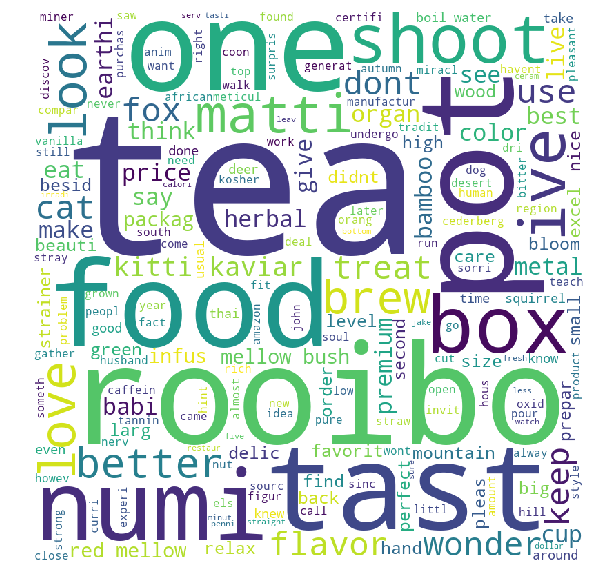

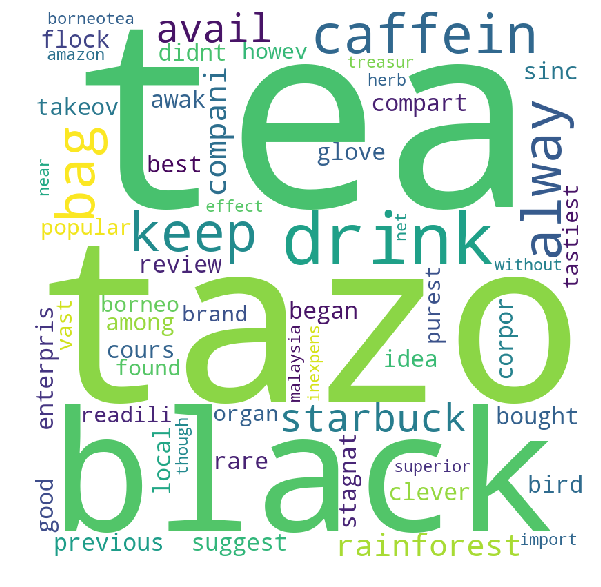

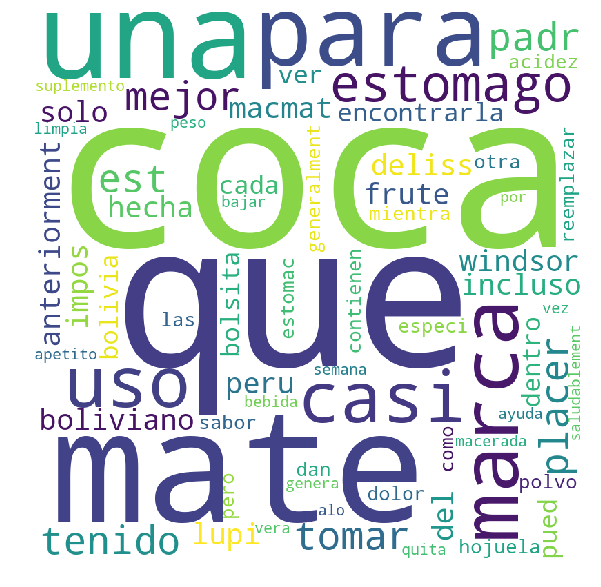

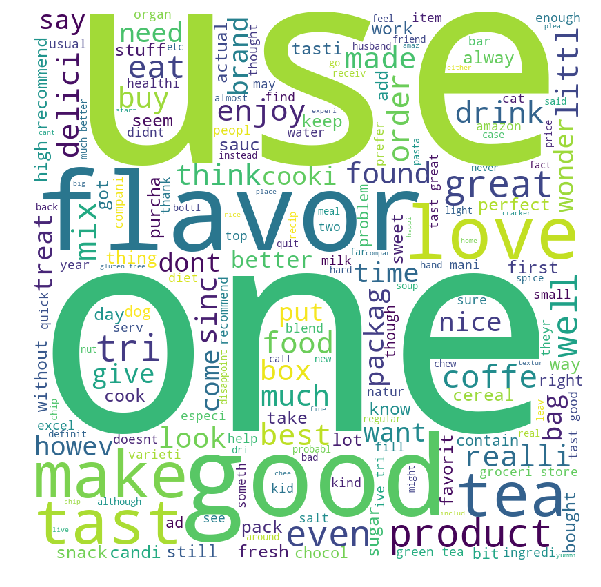

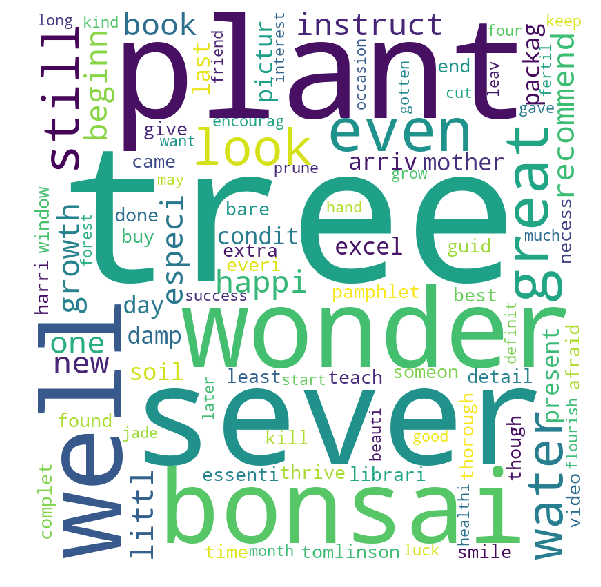

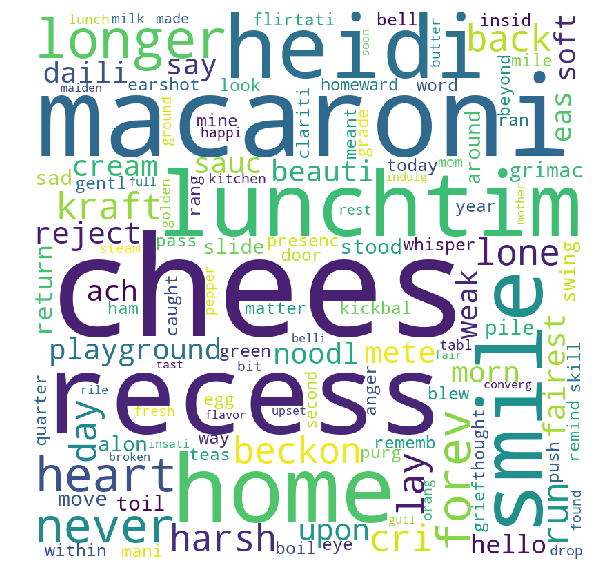

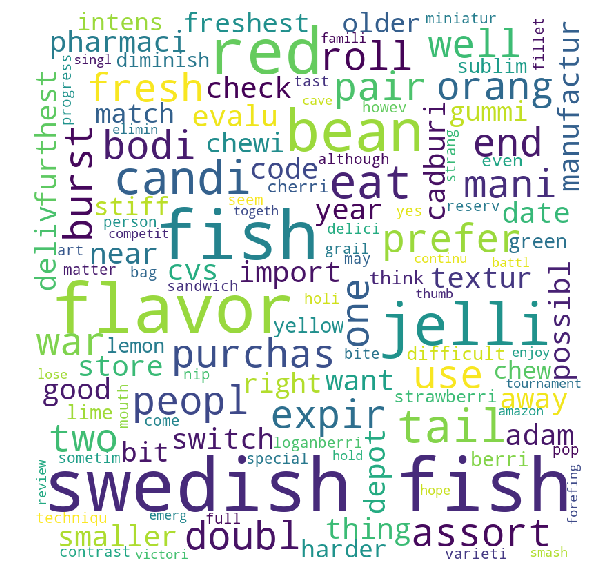

In [260]:
wordcloud_print(clean_text_all)

## K-Means of tfidf

<function matplotlib.pyplot.show(*args, **kw)>

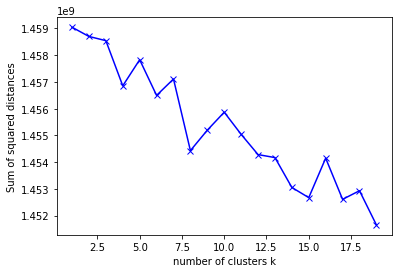

In [37]:
sum_squared_dist_tfidf = []
K = range(1,20)
for k in K:
    km_tfidf = KMeans(n_clusters=k, random_state=0)
    km_tfidf = km_tfidf.fit(train_tfidf, y_train)
    sum_squared_dist_tfidf.append(km_tfidf.inertia_)
plt.plot(K, sum_squared_dist_tfidf, 'bx-')
plt.xlabel('number of clusters k')
plt.ylabel('Sum of squared distances')
plt.show

In [42]:
joblib.dump(sum_squared_dist_tfidf,"sum_squared_dist_tfidf.pkl")
joblib.dump(km_tfidf,"km_tfidf.pkl")

['km_tfidf.pkl']

In [164]:
sum_squared_dist_tfidf = joblib.load("sum_squared_dist_tfidf.pkl")
km_tfidf = joblib.load("km_tfidf.pkl")

In [267]:
#taking K=6 in for tfidf
km_tfidf_best = KMeans(n_clusters=6, random_state=0)
km_tfidf_best = km_tfidf_best.fit(train_tfidf, y_train)

In [268]:
joblib.dump(km_tfidf_best,"km_tfidf_best.pkl")

['km_tfidf_best.pkl']

In [269]:
km_tfidf_best = joblib.load("km_tfidf_best.pkl")

In [270]:
labels_tfidf = km_tfidf_best.labels_ 
print(np.shape(labels_tfidf))
print(type(labels_tfidf))
labels_tfidf_df = pd.DataFrame(labels_tfidf)
print(type(labels_tfidf_df))
print(np.shape(labels_tfidf_df))

(38400,)
<class 'numpy.ndarray'>
<class 'pandas.core.frame.DataFrame'>
(38400, 1)


In [271]:
#matching the number of rows
final3 = final2[0:38400]
print(type(final3))
print(final3.shape)
#final3

<class 'pandas.core.frame.DataFrame'>
(38400, 11)


In [272]:
#adding the values of labels in the data frame
final4 = final3
print(type(final4))
final4.reindex(columns=[*final4.columns.tolist(), 'labels'],fill_value=1)
final4['labels']=labels_tfidf_df.values
final4

<class 'pandas.core.frame.DataFrame'>


,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,CleanedText,labels
138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,1,939340800,EVERY book is educational,this witty little book makes my son laugh at l...,witti littl book make son laugh loud recit car...,0
138683,150501,0006641040,AJ46FKXOVC7NR,Nicholas A Mesiano,2,2,1,940809600,This whole series is great way to spend time w...,I can remember seeing the show when it aired o...,rememb see show air televis year ago child sis...,0
417839,451856,B00004CXX9,AIUWLEQ1ADEG5,Elizabeth Medina,0,0,1,944092800,Entertainingl Funny!,Beetlejuice is a well written movie ..... ever...,beetlejuic well written movi everyth excel act...,0
417859,451878,B00004CXX9,A344SMIA5JECGM,Vincent P. Ross,1,2,1,944438400,A modern day fairy tale,"A twist of rumplestiskin captured on film, sta...",twist rumplestiskin captur film star michael k...,0
417838,451855,B00004CXX9,AJH6LUC1UT1ON,The Phantom of the Opera,0,0,1,946857600,FANTASTIC!,Beetlejuice is an excellent and funny movie. K...,beetlejuic excel funni movi keaton hilari wack...,0
417927,451949,B00004CXX9,A1048CYU0OV4O8,Judy L. Eans,2,2,1,947376000,GREAT,THIS IS ONE MOVIE THAT SHOULD BE IN YOUR MOVIE...,one movi movi collect fill comedi action whate...,0
417847,451864,B00004CXX9,A1B2IZU1JLZA6,Wes,19,23,0,948240000,WARNING: CLAMSHELL EDITION IS EDITED TV VERSION,"I, myself always enjoyed this movie, it's very...",alway enjoy movi funni entertain didnt hesit p...,0
70688,76882,B00002N8SM,A32DW342WBJ6BX,Buttersugar,0,0,1,948672000,A sure death for flies,I bought a few of these after my apartment was...,bought apart infest fruit fli hour trap mani f...,0
346141,374450,B00004CI84,ACJR7EQF9S6FP,Jeremy Robertson,2,3,1,951523200,Bettlejuice...Bettlejuice...BETTLEJUICE!,What happens when you say his name three times...,happen say name three time michael keaten star...,0
417883,451903,B00004CXX9,A2DEE7F9XKP3ZR,jerome,0,1,1,959990400,Research,I'm getting crazy.<p>Is it really impossible t...,get crazi realli imposs today find french vhs ...,0


In [274]:
clean_text_all_tfidf = list()

#copying all the data rows with label=0
clean_text_cat_0 = list()
for loop1 in range(0,38400):
    if (((final4['labels'].values)[loop1]) == 0):
        clean_text_cat_0.append(((final4['CleanedText'].values)[loop1]))     
clean_text_all_tfidf.append(clean_text_cat_0)

#copying all the data rows with label=1
clean_text_cat_1 = list()
for loop1 in range(0,38400):
    if (((final4['labels'].values)[loop1]) == 1):
        clean_text_cat_1.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidf.append(clean_text_cat_1)

#copying all the data rows with label=2
clean_text_cat_2 = list()
for loop1 in range(0,38400):
    if (((final4['labels'].values)[loop1]) == 2):
        clean_text_cat_2.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidf.append(clean_text_cat_2)

#copying all the data rows with label=3
clean_text_cat_3 = list()
for loop1 in range(0,38400):
    if (((final4['labels'].values)[loop1]) == 3):
        clean_text_cat_3.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidf.append(clean_text_cat_3)

#copying all the data rows with label=4
clean_text_cat_4 = list()
for loop1 in range(0,38400):
    if (((final4['labels'].values)[loop1]) == 4):
        clean_text_cat_4.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidf.append(clean_text_cat_4)

#copying all the data rows with label=5
clean_text_cat_5 = list()
for loop1 in range(0,38400):
    if (((final4['labels'].values)[loop1]) == 5):
        clean_text_cat_5.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidf.append(clean_text_cat_5)

#copying all the data rows with label=6
clean_text_cat_6 = list()
for loop1 in range(0,38400):
    if (((final4['labels'].values)[loop1]) == 6):
        clean_text_cat_6.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidf.append(clean_text_cat_6)

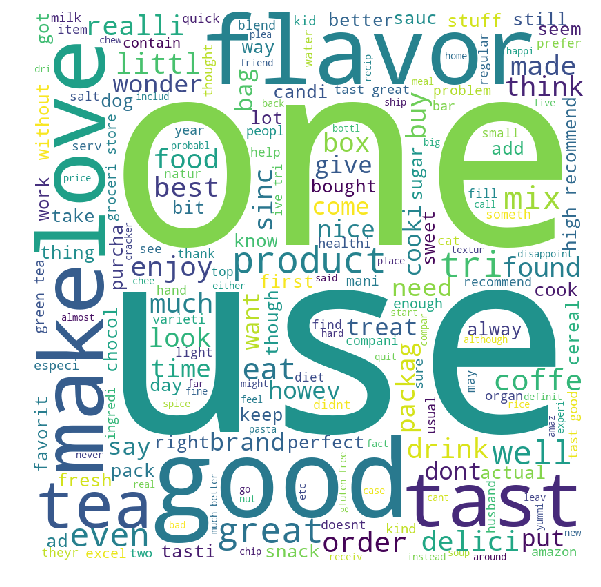

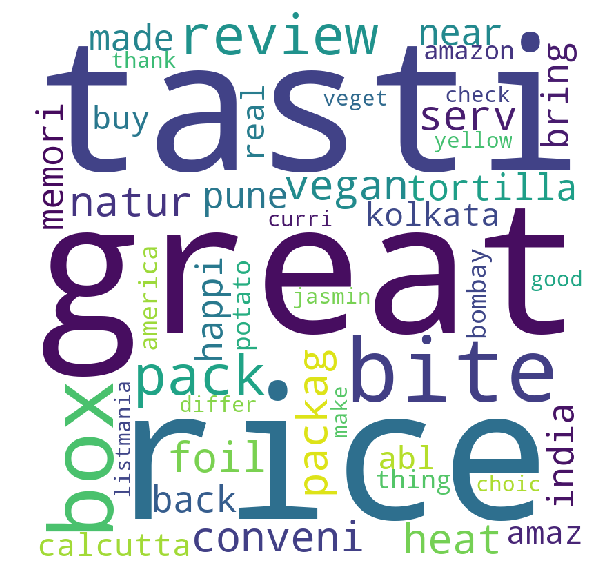

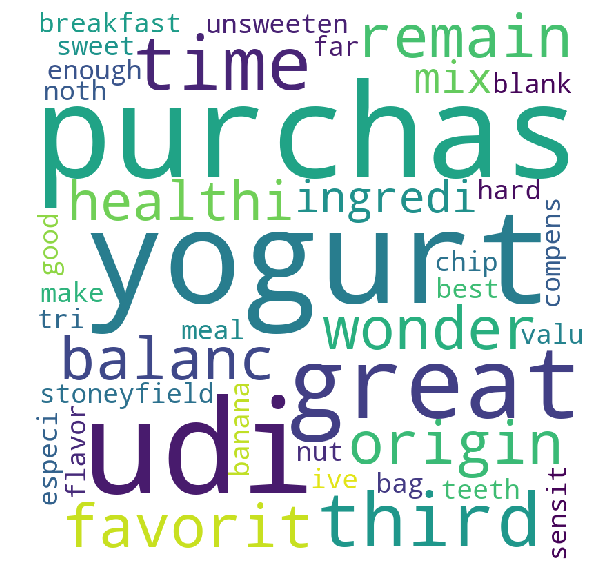

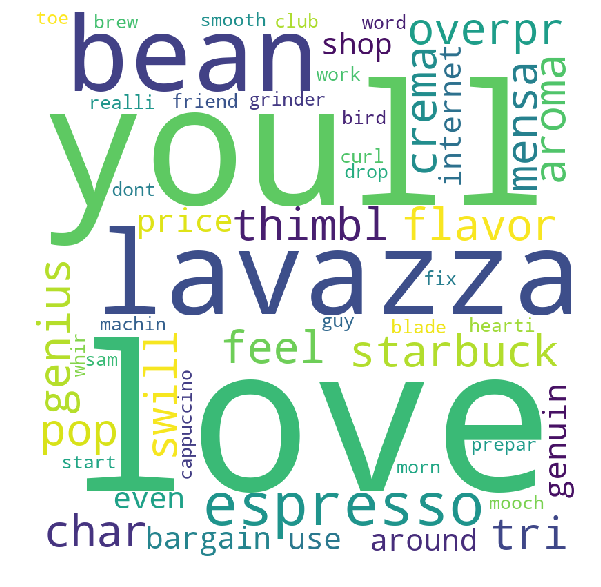

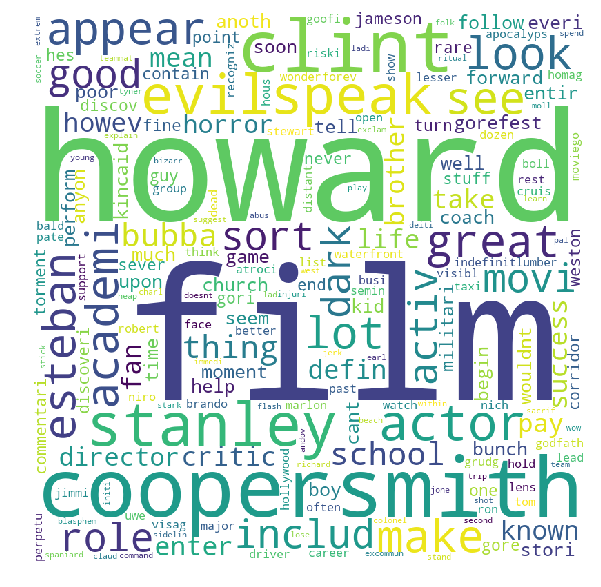

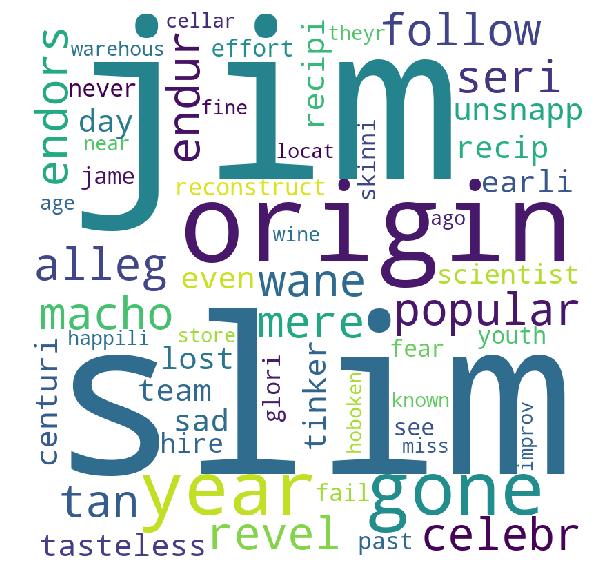

ValueError: We need at least 1 word to plot a word cloud, got 0.

In [282]:
wordcloud_print(clean_text_all_tfidf)

## K-Means on avgW2V

<function matplotlib.pyplot.show(*args, **kw)>

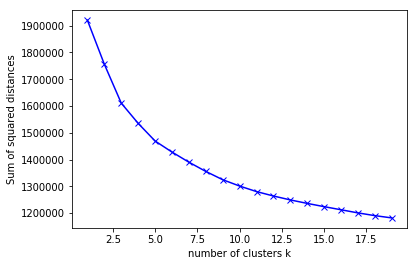

In [38]:
sum_squared_dist_avgw2v = []
K = range(1,20)
for k in K:
    km_avgw2v = KMeans(n_clusters=k, random_state=0)
    km_avgw2v = km_avgw2v.fit(train_avgw2v, y_train)
    sum_squared_dist_avgw2v.append(km_avgw2v.inertia_)
plt.plot(K, sum_squared_dist_avgw2v, 'bx-')
plt.xlabel('number of clusters k')
plt.ylabel('Sum of squared distances')
plt.show

In [48]:
joblib.dump(sum_squared_dist_avgw2v,"sum_squared_dist_avgw2v.pkl")
joblib.dump(km_avgw2v,"km_avgw2v.pkl")

['km_avgw2v.pkl']

In [49]:
sum_squared_dist_avgw2v = joblib.load("sum_squared_dist_avgw2v.pkl")
km_avgw2v = joblib.load("km_avgw2v.pkl")

In [297]:
#taking K=6 in for avgW2V
km_avgw2v_best = KMeans(n_clusters=6, random_state=0)
km_avgw2v_best = km_avgw2v_best.fit(train_avgw2v, y_train)

In [298]:
joblib.dump(km_avgw2v_best,"km_avgw2v_best.pkl")

['km_avgw2v_best.pkl']

In [299]:
km_avgw2v_best = joblib.load("km_avgw2v_best.pkl")

In [300]:
labels_avgw2v = km_avgw2v_best.labels_ 
print(np.shape(labels_avgw2v))
print(type(labels_avgw2v))
labels_avgw2v_df = pd.DataFrame(labels_avgw2v)
print(type(labels_avgw2v_df))
print(np.shape(labels_avgw2v_df))

(38400,)
<class 'numpy.ndarray'>
<class 'pandas.core.frame.DataFrame'>
(38400, 1)


In [301]:
#matching the number of rows
final3 = final2[0:38400]
print(type(final3))
print(final3.shape)
#final3

<class 'pandas.core.frame.DataFrame'>
(38400, 11)


In [302]:
#adding the values of labels in the data frame
final4 = final3
print(type(final4))
final4.reindex(columns=[*final4.columns.tolist(), 'labels'],fill_value=1)
final4['labels']=labels_avgw2v_df.values
final4

<class 'pandas.core.frame.DataFrame'>


,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,CleanedText,labels
138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,1,939340800,EVERY book is educational,this witty little book makes my son laugh at l...,witti littl book make son laugh loud recit car...,2
138683,150501,0006641040,AJ46FKXOVC7NR,Nicholas A Mesiano,2,2,1,940809600,This whole series is great way to spend time w...,I can remember seeing the show when it aired o...,rememb see show air televis year ago child sis...,2
417839,451856,B00004CXX9,AIUWLEQ1ADEG5,Elizabeth Medina,0,0,1,944092800,Entertainingl Funny!,Beetlejuice is a well written movie ..... ever...,beetlejuic well written movi everyth excel act...,2
417859,451878,B00004CXX9,A344SMIA5JECGM,Vincent P. Ross,1,2,1,944438400,A modern day fairy tale,"A twist of rumplestiskin captured on film, sta...",twist rumplestiskin captur film star michael k...,2
417838,451855,B00004CXX9,AJH6LUC1UT1ON,The Phantom of the Opera,0,0,1,946857600,FANTASTIC!,Beetlejuice is an excellent and funny movie. K...,beetlejuic excel funni movi keaton hilari wack...,2
417927,451949,B00004CXX9,A1048CYU0OV4O8,Judy L. Eans,2,2,1,947376000,GREAT,THIS IS ONE MOVIE THAT SHOULD BE IN YOUR MOVIE...,one movi movi collect fill comedi action whate...,2
417847,451864,B00004CXX9,A1B2IZU1JLZA6,Wes,19,23,0,948240000,WARNING: CLAMSHELL EDITION IS EDITED TV VERSION,"I, myself always enjoyed this movie, it's very...",alway enjoy movi funni entertain didnt hesit p...,2
70688,76882,B00002N8SM,A32DW342WBJ6BX,Buttersugar,0,0,1,948672000,A sure death for flies,I bought a few of these after my apartment was...,bought apart infest fruit fli hour trap mani f...,1
346141,374450,B00004CI84,ACJR7EQF9S6FP,Jeremy Robertson,2,3,1,951523200,Bettlejuice...Bettlejuice...BETTLEJUICE!,What happens when you say his name three times...,happen say name three time michael keaten star...,2
417883,451903,B00004CXX9,A2DEE7F9XKP3ZR,jerome,0,1,1,959990400,Research,I'm getting crazy.<p>Is it really impossible t...,get crazi realli imposs today find french vhs ...,2


In [303]:
clean_text_all_avgw2v= list()

#copying all the data rows with label=0
clean_text_cat_0 = list()
for loop1 in range(0,38400):
    if (((final4['labels'].values)[loop1]) == 0):
        clean_text_cat_0.append(((final4['CleanedText'].values)[loop1]))     
clean_text_all_avgw2v.append(clean_text_cat_0)

#copying all the data rows with label=1
clean_text_cat_1 = list()
for loop1 in range(0,38400):
    if (((final4['labels'].values)[loop1]) == 1):
        clean_text_cat_1.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_1)

#copying all the data rows with label=2
clean_text_cat_2 = list()
for loop1 in range(0,38400):
    if (((final4['labels'].values)[loop1]) == 2):
        clean_text_cat_2.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_2)

#copying all the data rows with label=3
clean_text_cat_3 = list()
for loop1 in range(0,38400):
    if (((final4['labels'].values)[loop1]) == 3):
        clean_text_cat_3.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_3)

#copying all the data rows with label=4
clean_text_cat_4 = list()
for loop1 in range(0,38400):
    if (((final4['labels'].values)[loop1]) == 4):
        clean_text_cat_4.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_4)

#copying all the data rows with label=5
clean_text_cat_5 = list()
for loop1 in range(0,38400):
    if (((final4['labels'].values)[loop1]) == 5):
        clean_text_cat_5.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_5)

#copying all the data rows with label=6
clean_text_cat_6 = list()
for loop1 in range(0,38400):
    if (((final4['labels'].values)[loop1]) == 6):
        clean_text_cat_6.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_6)

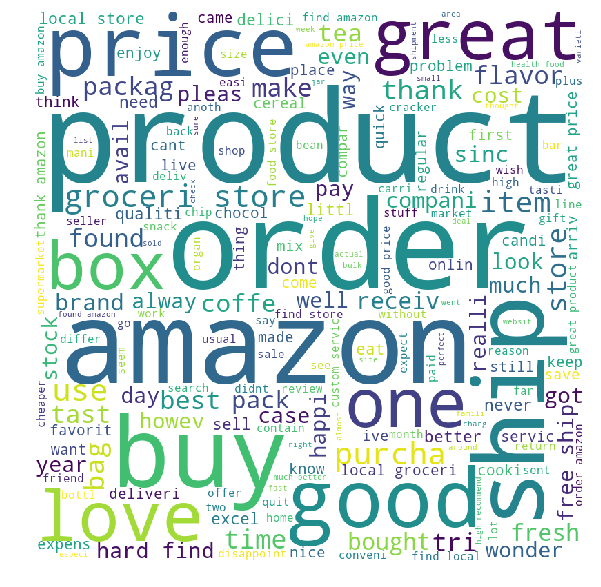

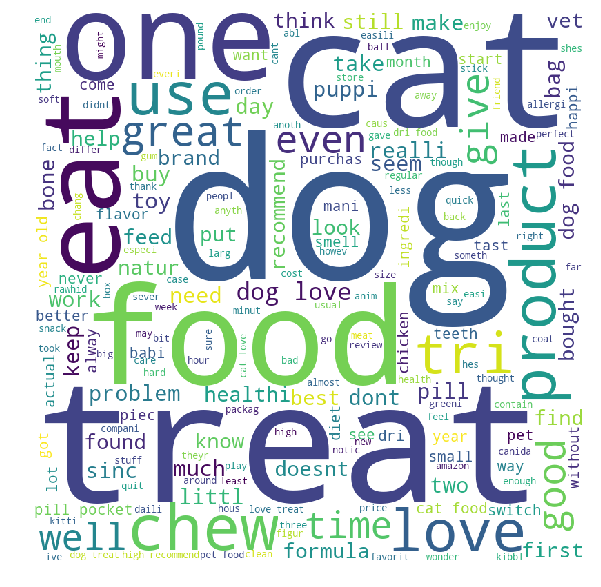

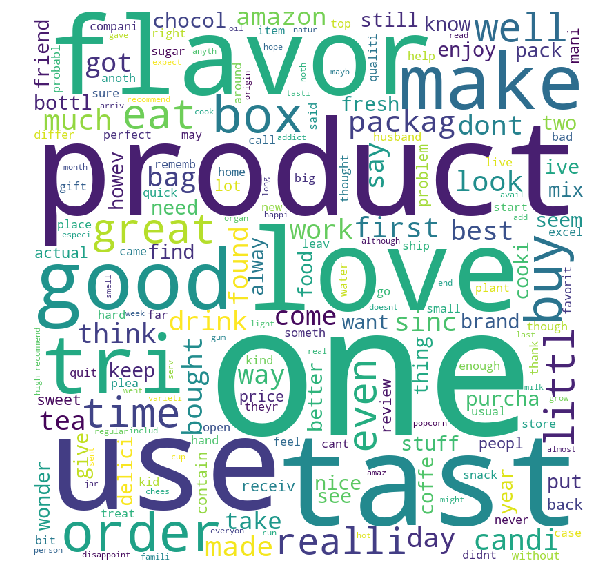

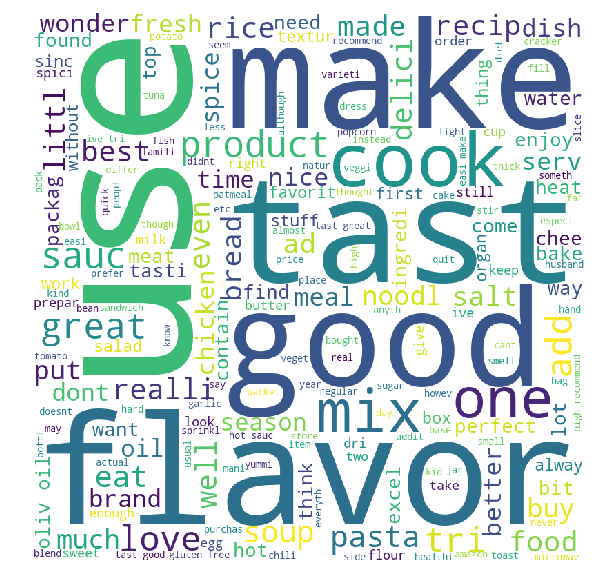

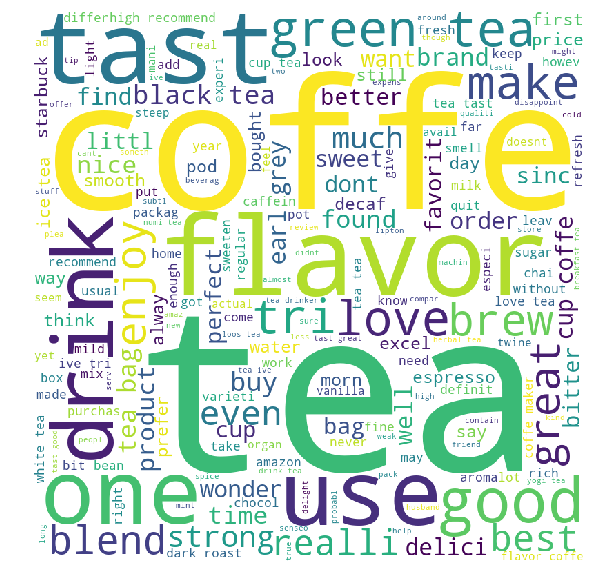

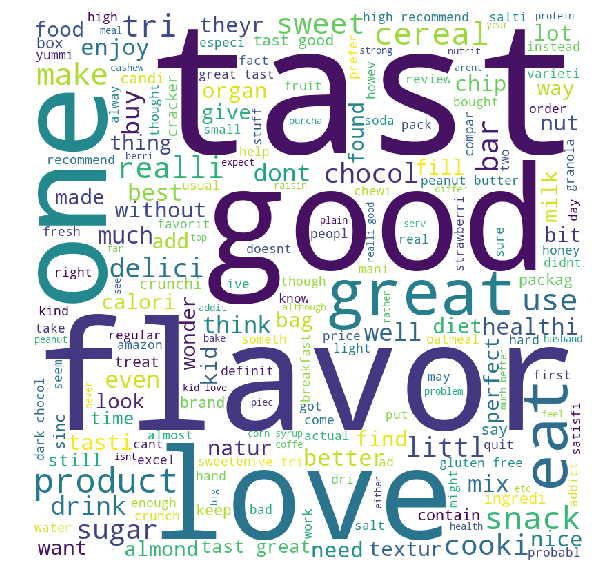

ValueError: We need at least 1 word to plot a word cloud, got 0.

In [304]:
wordcloud_print(clean_text_all_avgw2v)

## K-Means on tfidf-W-W2V

<function matplotlib.pyplot.show(*args, **kw)>

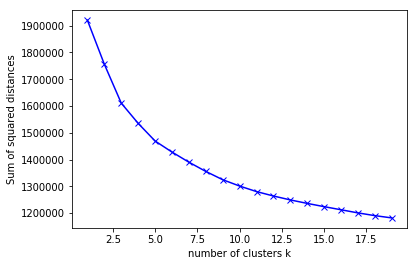

In [39]:
sum_squared_dist_tfidfww2v = []
K = range(1,20)
for k in K:
    km_tfidfww2v = KMeans(n_clusters=k, random_state=0)
    km_tfidfww2v = km_tfidfww2v.fit(train_tfidfww2v, y_train)
    sum_squared_dist_tfidfww2v.append(km_tfidfww2v.inertia_)
plt.plot(K, sum_squared_dist_tfidfww2v, 'bx-')
plt.xlabel('number of clusters k')
plt.ylabel('Sum of squared distances')
plt.show

In [46]:
joblib.dump(sum_squared_dist_tfidfww2v,"sum_squared_dist_tfidfww2v.pkl")
joblib.dump(km_tfidfww2v,"km_tfidfww2v.pkl")

['km_tfidfww2v.pkl']

In [47]:
sum_squared_dist_tfidfww2v = joblib.load("sum_squared_dist_tfidfww2v.pkl")
km_tfidfww2v = joblib.load("km_tfidfww2v.pkl")

In [305]:
#taking K=6 in for avgW2V
km_tfidfww2v_best = KMeans(n_clusters=6, random_state=0)
km_tfidfww2v_best = km_tfidfww2v_best.fit(train_tfidfww2v, y_train)

In [306]:
joblib.dump(km_tfidfww2v_best,"km_tfidfww2v_best.pkl")

['km_tfidfww2v_best.pkl']

In [307]:
km_tfidfww2v_best = joblib.load("km_tfidfww2v_best.pkl")

In [308]:
labels_tfidfww2v = km_tfidfww2v_best.labels_ 
print(np.shape(labels_tfidfww2v))
print(type(labels_tfidfww2v))
labels_tfidfww2v_df = pd.DataFrame(labels_tfidfww2v)
print(type(labels_tfidfww2v_df))
print(np.shape(labels_tfidfww2v_df))

(38400,)
<class 'numpy.ndarray'>
<class 'pandas.core.frame.DataFrame'>
(38400, 1)


In [309]:
#matching the number of rows
final3 = final2[0:38400]
print(type(final3))
print(final3.shape)
#final3

<class 'pandas.core.frame.DataFrame'>
(38400, 11)


In [310]:
#adding the values of labels in the data frame
final4 = final3
print(type(final4))
final4.reindex(columns=[*final4.columns.tolist(), 'labels'],fill_value=1)
final4['labels']=labels_tfidfww2v_df.values
final4

<class 'pandas.core.frame.DataFrame'>


,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,CleanedText,labels
138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,1,939340800,EVERY book is educational,this witty little book makes my son laugh at l...,witti littl book make son laugh loud recit car...,2
138683,150501,0006641040,AJ46FKXOVC7NR,Nicholas A Mesiano,2,2,1,940809600,This whole series is great way to spend time w...,I can remember seeing the show when it aired o...,rememb see show air televis year ago child sis...,2
417839,451856,B00004CXX9,AIUWLEQ1ADEG5,Elizabeth Medina,0,0,1,944092800,Entertainingl Funny!,Beetlejuice is a well written movie ..... ever...,beetlejuic well written movi everyth excel act...,2
417859,451878,B00004CXX9,A344SMIA5JECGM,Vincent P. Ross,1,2,1,944438400,A modern day fairy tale,"A twist of rumplestiskin captured on film, sta...",twist rumplestiskin captur film star michael k...,2
417838,451855,B00004CXX9,AJH6LUC1UT1ON,The Phantom of the Opera,0,0,1,946857600,FANTASTIC!,Beetlejuice is an excellent and funny movie. K...,beetlejuic excel funni movi keaton hilari wack...,2
417927,451949,B00004CXX9,A1048CYU0OV4O8,Judy L. Eans,2,2,1,947376000,GREAT,THIS IS ONE MOVIE THAT SHOULD BE IN YOUR MOVIE...,one movi movi collect fill comedi action whate...,2
417847,451864,B00004CXX9,A1B2IZU1JLZA6,Wes,19,23,0,948240000,WARNING: CLAMSHELL EDITION IS EDITED TV VERSION,"I, myself always enjoyed this movie, it's very...",alway enjoy movi funni entertain didnt hesit p...,2
70688,76882,B00002N8SM,A32DW342WBJ6BX,Buttersugar,0,0,1,948672000,A sure death for flies,I bought a few of these after my apartment was...,bought apart infest fruit fli hour trap mani f...,1
346141,374450,B00004CI84,ACJR7EQF9S6FP,Jeremy Robertson,2,3,1,951523200,Bettlejuice...Bettlejuice...BETTLEJUICE!,What happens when you say his name three times...,happen say name three time michael keaten star...,2
417883,451903,B00004CXX9,A2DEE7F9XKP3ZR,jerome,0,1,1,959990400,Research,I'm getting crazy.<p>Is it really impossible t...,get crazi realli imposs today find french vhs ...,2


In [311]:
clean_text_all_tfidfww2v = list()

#copying all the data rows with label=0
clean_text_cat_0 = list()
for loop1 in range(0,38400):
    if (((final4['labels'].values)[loop1]) == 0):
        clean_text_cat_0.append(((final4['CleanedText'].values)[loop1]))     
clean_text_all_tfidfww2v.append(clean_text_cat_0)

#copying all the data rows with label=1
clean_text_cat_1 = list()
for loop1 in range(0,38400):
    if (((final4['labels'].values)[loop1]) == 1):
        clean_text_cat_1.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_1)

#copying all the data rows with label=2
clean_text_cat_2 = list()
for loop1 in range(0,38400):
    if (((final4['labels'].values)[loop1]) == 2):
        clean_text_cat_2.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_2)

#copying all the data rows with label=3
clean_text_cat_3 = list()
for loop1 in range(0,38400):
    if (((final4['labels'].values)[loop1]) == 3):
        clean_text_cat_3.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_3)

#copying all the data rows with label=4
clean_text_cat_4 = list()
for loop1 in range(0,38400):
    if (((final4['labels'].values)[loop1]) == 4):
        clean_text_cat_4.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_4)

#copying all the data rows with label=5
clean_text_cat_5 = list()
for loop1 in range(0,38400):
    if (((final4['labels'].values)[loop1]) == 5):
        clean_text_cat_5.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_5)

#copying all the data rows with label=6
clean_text_cat_6 = list()
for loop1 in range(0,38400):
    if (((final4['labels'].values)[loop1]) == 6):
        clean_text_cat_6.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_6)

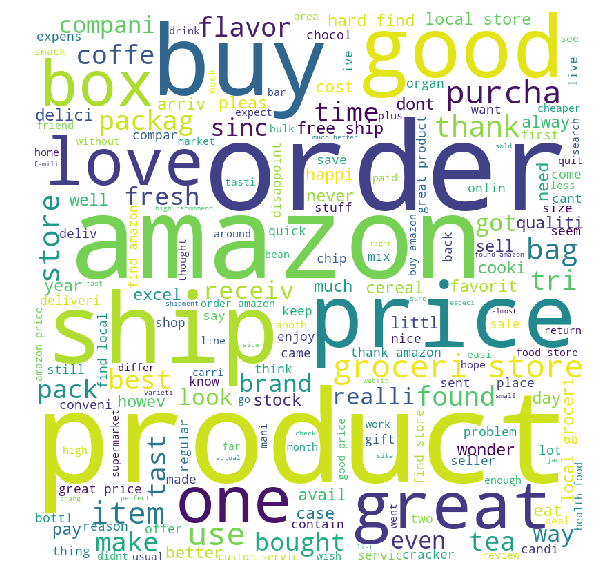

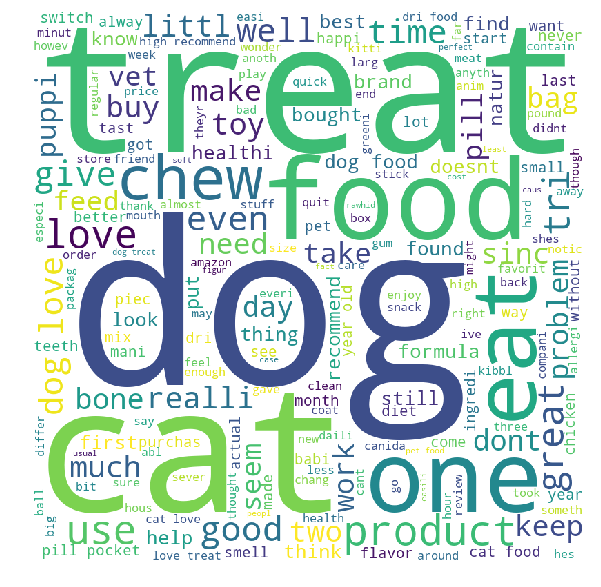

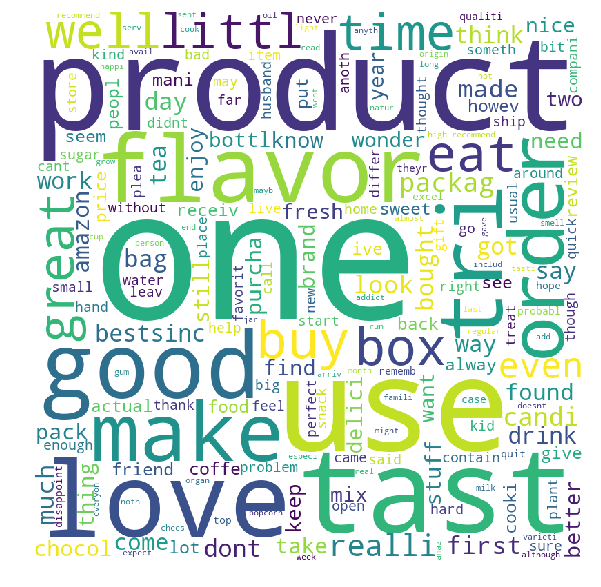

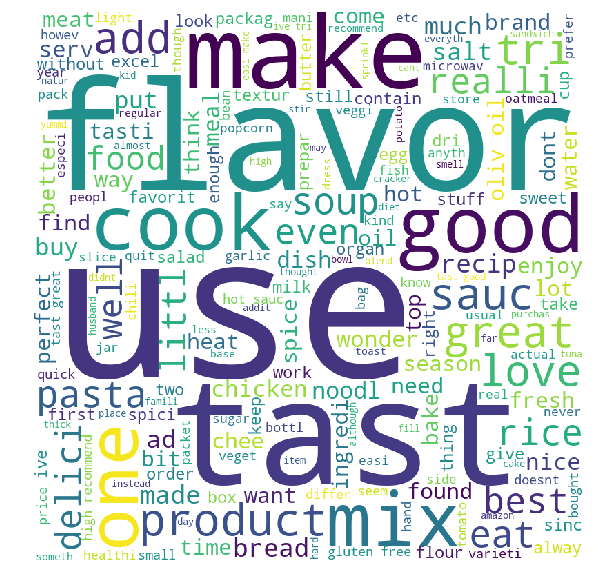

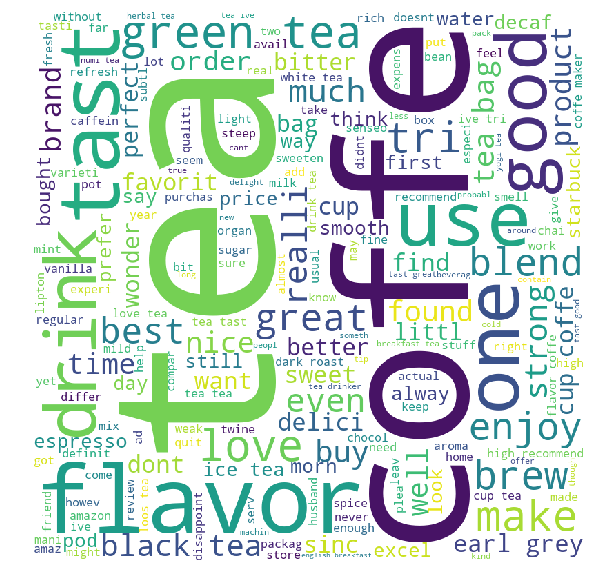

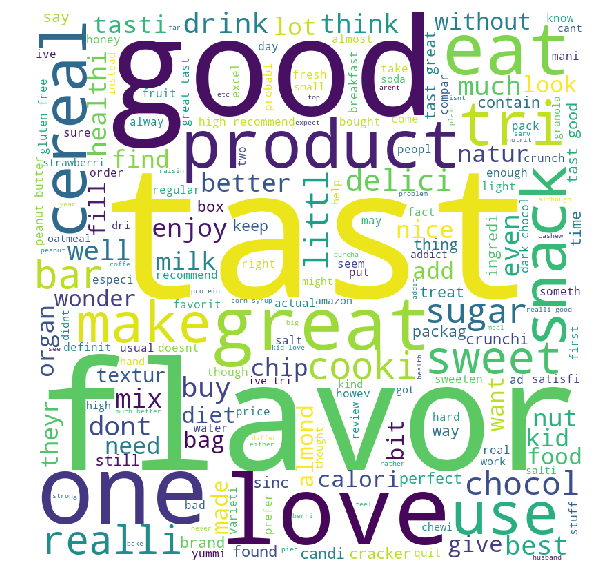

ValueError: We need at least 1 word to plot a word cloud, got 0.

In [312]:
wordcloud_print(clean_text_all_tfidfww2v)

## Loading 5K data from disk

In [313]:
fileObject = open("./train_to_file4.pkl",'rb') # we open the file for reading 
X_train_1 = pickle.load(fileObject) # load the object from the file

fileObject = open("./y_train_to_file4.pkl",'rb') # we open the file for reading 
y_train_1 = pickle.load(fileObject) # load the object from the file

In [314]:
fileObject = open("./final_to_file4.pkl",'rb') # we open the file for reading 
final = pickle.load(fileObject) # load the object from the file

## avgW2V

In [315]:
#w2v
# Train your own Word2Vec model using your own text corpus
i=0
list_of_sent=[]
for sent in final['CleanedText'].values:
    list_of_sent.append(sent.split())
    
print(type(list_of_sent))
print(final['CleanedText'].values[0])
print("*****************************************************************")
print(list_of_sent[0])

<class 'list'>
witti littl book make son laugh loud recit car drive along alway sing refrain hes learn whale india droop love new word book introduc silli classic book will bet son still abl recit memori colleg
*****************************************************************
['witti', 'littl', 'book', 'make', 'son', 'laugh', 'loud', 'recit', 'car', 'drive', 'along', 'alway', 'sing', 'refrain', 'hes', 'learn', 'whale', 'india', 'droop', 'love', 'new', 'word', 'book', 'introduc', 'silli', 'classic', 'book', 'will', 'bet', 'son', 'still', 'abl', 'recit', 'memori', 'colleg']


In [316]:
w2v_model=Word2Vec(list_of_sent,min_count=5,size=50, workers=4)
w2v_words = list(w2v_model.wv.vocab)

In [317]:
# average Word2Vec
# compute average word2vec for each review.
sent_vectors = []; # the avg-w2v for each sentence/review is stored in this list
for sent in list_of_sent: # for each review/sentence
    sent_vec = np.zeros(50) # as word vectors are of zero length
    cnt_words =0; # num of words with a valid vector in the sentence/review
    for word in sent: # for each word in a review/sentence
        if word in w2v_words:
            vec = w2v_model.wv[word]
            sent_vec += vec
            cnt_words += 1
    if cnt_words != 0:
        sent_vec /= cnt_words
    sent_vectors.append(sent_vec)
print(len(sent_vectors))
#print(len(sent_vectors[0]))
print(type(sent_vectors))

5000
<class 'list'>


In [318]:
# create design matrix X and target vector y
X = np.array(sent_vectors[::]) # end index is exclusive
y = np.array(final['Score']) # showing you two ways of indexing a pandas df

In [319]:
X_train_nstd = X[0:5000]
y_train_nstd = y[0:5000]

print(X_train_nstd.shape)
print(y_train_nstd.shape)

(5000, 50)
(5000,)


In [320]:
# Column Standardization of the tfidf non-standard vector
std_scal = StandardScaler(with_mean=False)
std_scal.fit(X_train_nstd)
train_avgw2v_1 = std_scal.transform(X_train_nstd)

## tfidf-W-W2V

In [321]:
# S = ["abc def pqr", "def def def abc", "pqr pqr def"]
model = TfidfVectorizer()
tf_idf_matrix = model.fit_transform(final['CleanedText'].values)
# we are converting a dictionary with word as a key, and the idf as a value
dictionary = dict(zip(model.get_feature_names(), list(model.idf_)))

In [322]:
# TF-IDF weighted Word2Vec
tfidf_feat = model.get_feature_names() # tfidf words/col-names
# final_tf_idf is the sparse matrix with row= sentence, col=word and cell_val = tfidf

tfidf_sent_vectors = []; # the tfidf-w2v for each sentence/review is stored in this list
row=0;
for sent in (list_of_sent): # for each review/sentence 
    sent_vec = np.zeros(50) # as word vectors are of zero length
    weight_sum =0; # num of words with a valid vector in the sentence/review
    for word in sent: # for each word in a review/sentence
        if word in w2v_words:
            vec = w2v_model.wv[word]
#             tf_idf = tf_idf_matrix[row, tfidf_feat.index(word)]
            # to reduce the computation we are 
            # dictionary[word] = idf value of word in whole courpus
            # sent.count(word) = tf valeus of word in this review
            tf_idf = dictionary[word]*(sent.count(word)/len(sent))
            sent_vec += (vec * tf_idf)
            weight_sum += tf_idf
    if weight_sum != 0:
        sent_vec /= weight_sum
    tfidf_sent_vectors.append(sent_vec)
    row += 1

In [323]:
print(len(tfidf_sent_vectors))
print(np.shape(tfidf_sent_vectors))
print(type(tfidf_sent_vectors))

5000
(5000, 50)
<class 'list'>


In [324]:
# create design matrix X and target vector y
X = np.array(sent_vectors[::]) # end index is exclusive
y = np.array(final['Score']) # showing you two ways of indexing a pandas df

In [325]:
X_train_nstd = X[0:5000]
y_train_nstd = y[0:5000]

print(X_train_nstd.shape)
print(y_train_nstd.shape)

(5000, 50)
(5000,)


In [326]:
# Column Standardization of the tfidf non-standard vector
std_scal = StandardScaler(with_mean=False)
std_scal.fit(X_train_nstd)
train_tfidfww2v_1 = std_scal.transform(X_train_nstd)

## Agglomerative Clustering on avgW2V

In [329]:
clf_agc_1 = AgglomerativeClustering(n_clusters = 2) #No. clusters = 2
labels_avgw2v_c2 = clf_agc_1.fit_predict(train_avgw2v_1,y_train_1)
labels_avgw2v_c2

array([0, 0, 0, ..., 0, 0, 1], dtype=int64)

In [338]:
print(type(labels_avgw2v_c2))
labels_avgw2v_c2_df = pd.DataFrame(labels_avgw2v_c2)
print(type(labels_avgw2v_c2_df))

#matching the number of rows
final3 = final2[0:5000]
print(type(final3))
print(final3.shape)
#final3

#adding the values of labels in the data frame
final4 = final3
print(type(final4))
final4.reindex(columns=[*final4.columns.tolist(), 'labels'],fill_value=1)
final4['labels']=labels_avgw2v_c2_df.values
final4

<class 'numpy.ndarray'>
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>
(5000, 11)
<class 'pandas.core.frame.DataFrame'>


,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,CleanedText,labels
138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,1,939340800,EVERY book is educational,this witty little book makes my son laugh at l...,witti littl book make son laugh loud recit car...,0
138683,150501,0006641040,AJ46FKXOVC7NR,Nicholas A Mesiano,2,2,1,940809600,This whole series is great way to spend time w...,I can remember seeing the show when it aired o...,rememb see show air televis year ago child sis...,0
417839,451856,B00004CXX9,AIUWLEQ1ADEG5,Elizabeth Medina,0,0,1,944092800,Entertainingl Funny!,Beetlejuice is a well written movie ..... ever...,beetlejuic well written movi everyth excel act...,0
417859,451878,B00004CXX9,A344SMIA5JECGM,Vincent P. Ross,1,2,1,944438400,A modern day fairy tale,"A twist of rumplestiskin captured on film, sta...",twist rumplestiskin captur film star michael k...,0
417838,451855,B00004CXX9,AJH6LUC1UT1ON,The Phantom of the Opera,0,0,1,946857600,FANTASTIC!,Beetlejuice is an excellent and funny movie. K...,beetlejuic excel funni movi keaton hilari wack...,0
417927,451949,B00004CXX9,A1048CYU0OV4O8,Judy L. Eans,2,2,1,947376000,GREAT,THIS IS ONE MOVIE THAT SHOULD BE IN YOUR MOVIE...,one movi movi collect fill comedi action whate...,0
417847,451864,B00004CXX9,A1B2IZU1JLZA6,Wes,19,23,0,948240000,WARNING: CLAMSHELL EDITION IS EDITED TV VERSION,"I, myself always enjoyed this movie, it's very...",alway enjoy movi funni entertain didnt hesit p...,0
70688,76882,B00002N8SM,A32DW342WBJ6BX,Buttersugar,0,0,1,948672000,A sure death for flies,I bought a few of these after my apartment was...,bought apart infest fruit fli hour trap mani f...,0
346141,374450,B00004CI84,ACJR7EQF9S6FP,Jeremy Robertson,2,3,1,951523200,Bettlejuice...Bettlejuice...BETTLEJUICE!,What happens when you say his name three times...,happen say name three time michael keaten star...,0
417883,451903,B00004CXX9,A2DEE7F9XKP3ZR,jerome,0,1,1,959990400,Research,I'm getting crazy.<p>Is it really impossible t...,get crazi realli imposs today find french vhs ...,0


In [340]:
clean_text_all_avgw2v= list()

#copying all the data rows with label=0
clean_text_cat_0 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 0):
        clean_text_cat_0.append(((final4['CleanedText'].values)[loop1]))     
clean_text_all_avgw2v.append(clean_text_cat_0)

#copying all the data rows with label=1
clean_text_cat_1 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 1):
        clean_text_cat_1.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_1)

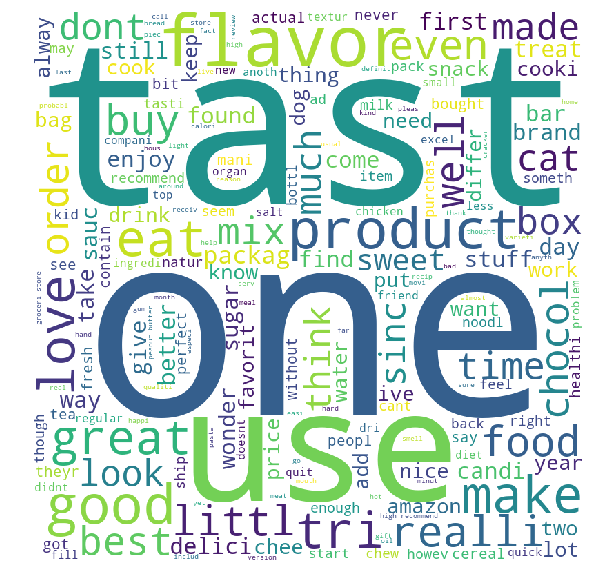

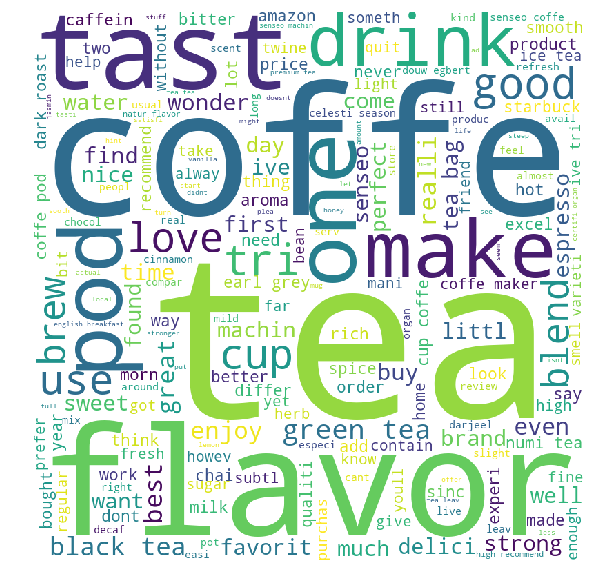

In [343]:
wordcloud_print(clean_text_all_avgw2v)

In [330]:
clf_agc_2 = AgglomerativeClustering(n_clusters = 3) #No. clusters = 3
labels_avgw2v_c3 = clf_agc_2.fit_predict(train_avgw2v_1,y_train_1)

In [346]:
print(type(labels_avgw2v_c3))
labels_avgw2v_c3_df = pd.DataFrame(labels_avgw2v_c3)
print(type(labels_avgw2v_c3_df))

#matching the number of rows
final3 = final2[0:5000]
print(type(final3))
print(final3.shape)
#final3

#adding the values of labels in the data frame
final4 = final3
print(type(final4))
final4.reindex(columns=[*final4.columns.tolist(), 'labels'],fill_value=1)
final4['labels']=labels_avgw2v_c3_df.values
final4

<class 'numpy.ndarray'>
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>
(5000, 11)
<class 'pandas.core.frame.DataFrame'>


,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,CleanedText,labels
138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,1,939340800,EVERY book is educational,this witty little book makes my son laugh at l...,witti littl book make son laugh loud recit car...,1
138683,150501,0006641040,AJ46FKXOVC7NR,Nicholas A Mesiano,2,2,1,940809600,This whole series is great way to spend time w...,I can remember seeing the show when it aired o...,rememb see show air televis year ago child sis...,1
417839,451856,B00004CXX9,AIUWLEQ1ADEG5,Elizabeth Medina,0,0,1,944092800,Entertainingl Funny!,Beetlejuice is a well written movie ..... ever...,beetlejuic well written movi everyth excel act...,1
417859,451878,B00004CXX9,A344SMIA5JECGM,Vincent P. Ross,1,2,1,944438400,A modern day fairy tale,"A twist of rumplestiskin captured on film, sta...",twist rumplestiskin captur film star michael k...,1
417838,451855,B00004CXX9,AJH6LUC1UT1ON,The Phantom of the Opera,0,0,1,946857600,FANTASTIC!,Beetlejuice is an excellent and funny movie. K...,beetlejuic excel funni movi keaton hilari wack...,1
417927,451949,B00004CXX9,A1048CYU0OV4O8,Judy L. Eans,2,2,1,947376000,GREAT,THIS IS ONE MOVIE THAT SHOULD BE IN YOUR MOVIE...,one movi movi collect fill comedi action whate...,1
417847,451864,B00004CXX9,A1B2IZU1JLZA6,Wes,19,23,0,948240000,WARNING: CLAMSHELL EDITION IS EDITED TV VERSION,"I, myself always enjoyed this movie, it's very...",alway enjoy movi funni entertain didnt hesit p...,1
70688,76882,B00002N8SM,A32DW342WBJ6BX,Buttersugar,0,0,1,948672000,A sure death for flies,I bought a few of these after my apartment was...,bought apart infest fruit fli hour trap mani f...,1
346141,374450,B00004CI84,ACJR7EQF9S6FP,Jeremy Robertson,2,3,1,951523200,Bettlejuice...Bettlejuice...BETTLEJUICE!,What happens when you say his name three times...,happen say name three time michael keaten star...,1
417883,451903,B00004CXX9,A2DEE7F9XKP3ZR,jerome,0,1,1,959990400,Research,I'm getting crazy.<p>Is it really impossible t...,get crazi realli imposs today find french vhs ...,1


In [347]:
clean_text_all_avgw2v= list()

#copying all the data rows with label=0
clean_text_cat_0 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 0):
        clean_text_cat_0.append(((final4['CleanedText'].values)[loop1]))     
clean_text_all_avgw2v.append(clean_text_cat_0)

#copying all the data rows with label=1
clean_text_cat_1 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 1):
        clean_text_cat_1.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_1)

#copying all the data rows with label=2
clean_text_cat_2 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 2):
        clean_text_cat_2.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_2)

In [348]:
print(np.shape(clean_text_all_avgw2v))

(3,)


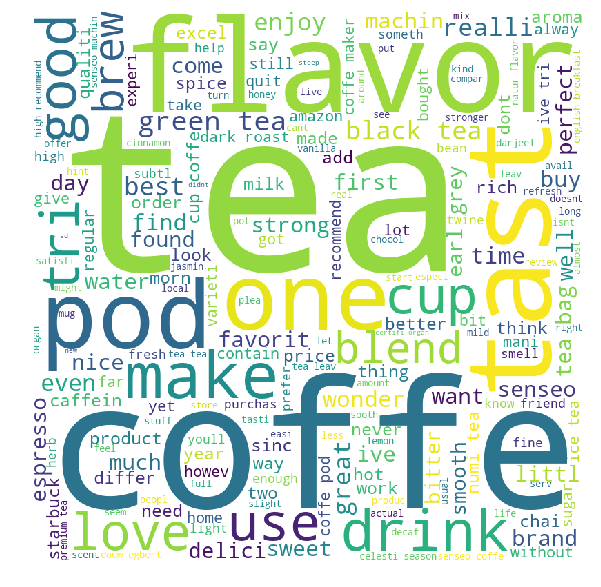

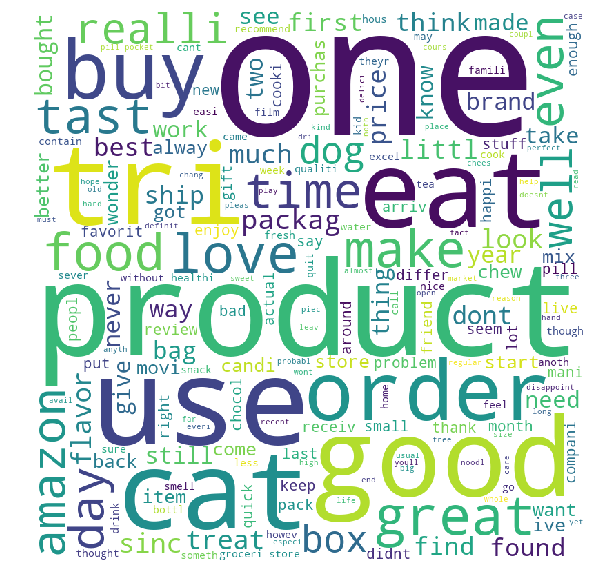

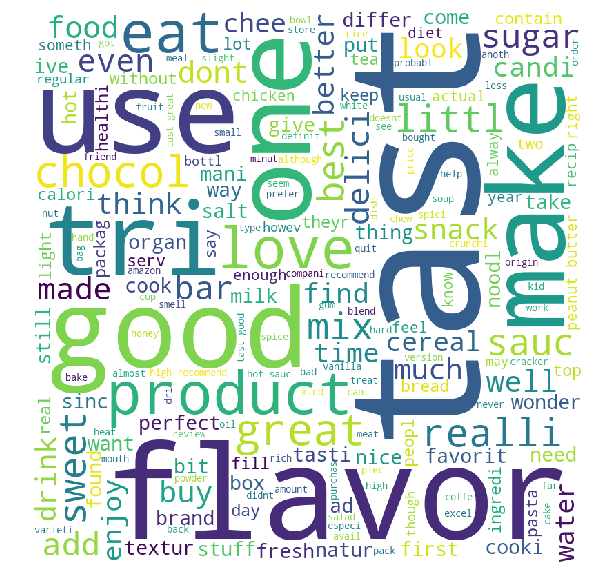

In [349]:
wordcloud_print(clean_text_all_avgw2v)

In [331]:
clf_agc_3 = AgglomerativeClustering(n_clusters = 4) #No. of clusters = 4
labels_avgw2v_c4 = clf_agc_3.fit_predict(train_avgw2v_1,y_train_1)

In [350]:
print(type(labels_avgw2v_c4))
labels_avgw2v_c4_df = pd.DataFrame(labels_avgw2v_c4)
print(type(labels_avgw2v_c4_df))

#matching the number of rows
final3 = final2[0:5000]
print(type(final3))
print(final3.shape)
#final3

#adding the values of labels in the data frame
final4 = final3
print(type(final4))
final4.reindex(columns=[*final4.columns.tolist(), 'labels'],fill_value=1)
final4['labels']=labels_avgw2v_c4_df.values
final4

<class 'numpy.ndarray'>
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>
(5000, 11)
<class 'pandas.core.frame.DataFrame'>


,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,CleanedText,labels
138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,1,939340800,EVERY book is educational,this witty little book makes my son laugh at l...,witti littl book make son laugh loud recit car...,0
138683,150501,0006641040,AJ46FKXOVC7NR,Nicholas A Mesiano,2,2,1,940809600,This whole series is great way to spend time w...,I can remember seeing the show when it aired o...,rememb see show air televis year ago child sis...,0
417839,451856,B00004CXX9,AIUWLEQ1ADEG5,Elizabeth Medina,0,0,1,944092800,Entertainingl Funny!,Beetlejuice is a well written movie ..... ever...,beetlejuic well written movi everyth excel act...,0
417859,451878,B00004CXX9,A344SMIA5JECGM,Vincent P. Ross,1,2,1,944438400,A modern day fairy tale,"A twist of rumplestiskin captured on film, sta...",twist rumplestiskin captur film star michael k...,0
417838,451855,B00004CXX9,AJH6LUC1UT1ON,The Phantom of the Opera,0,0,1,946857600,FANTASTIC!,Beetlejuice is an excellent and funny movie. K...,beetlejuic excel funni movi keaton hilari wack...,0
417927,451949,B00004CXX9,A1048CYU0OV4O8,Judy L. Eans,2,2,1,947376000,GREAT,THIS IS ONE MOVIE THAT SHOULD BE IN YOUR MOVIE...,one movi movi collect fill comedi action whate...,0
417847,451864,B00004CXX9,A1B2IZU1JLZA6,Wes,19,23,0,948240000,WARNING: CLAMSHELL EDITION IS EDITED TV VERSION,"I, myself always enjoyed this movie, it's very...",alway enjoy movi funni entertain didnt hesit p...,0
70688,76882,B00002N8SM,A32DW342WBJ6BX,Buttersugar,0,0,1,948672000,A sure death for flies,I bought a few of these after my apartment was...,bought apart infest fruit fli hour trap mani f...,0
346141,374450,B00004CI84,ACJR7EQF9S6FP,Jeremy Robertson,2,3,1,951523200,Bettlejuice...Bettlejuice...BETTLEJUICE!,What happens when you say his name three times...,happen say name three time michael keaten star...,0
417883,451903,B00004CXX9,A2DEE7F9XKP3ZR,jerome,0,1,1,959990400,Research,I'm getting crazy.<p>Is it really impossible t...,get crazi realli imposs today find french vhs ...,0


In [353]:
clean_text_all_avgw2v= list()

#copying all the data rows with label=0
clean_text_cat_0 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 0):
        clean_text_cat_0.append(((final4['CleanedText'].values)[loop1]))     
clean_text_all_avgw2v.append(clean_text_cat_0)

#copying all the data rows with label=1
clean_text_cat_1 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 1):
        clean_text_cat_1.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_1)

#copying all the data rows with label=2
clean_text_cat_2 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 2):
        clean_text_cat_2.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_2)

#copying all the data rows with label=3
clean_text_cat_3 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 3):
        clean_text_cat_3.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_3)

In [354]:
print(np.shape(clean_text_all_avgw2v))

(4,)


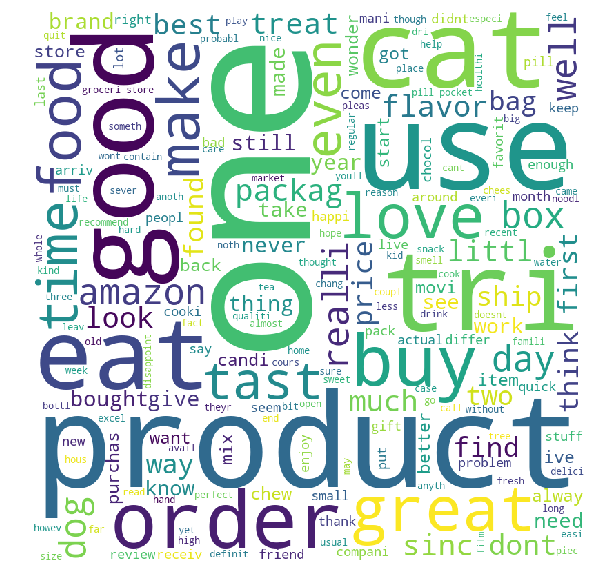

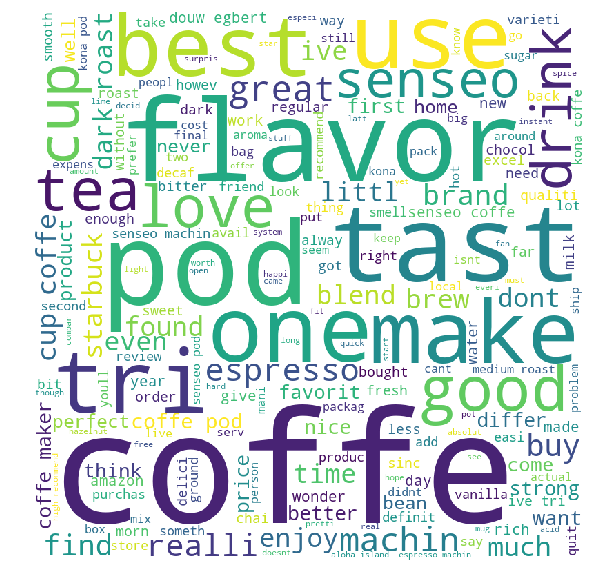

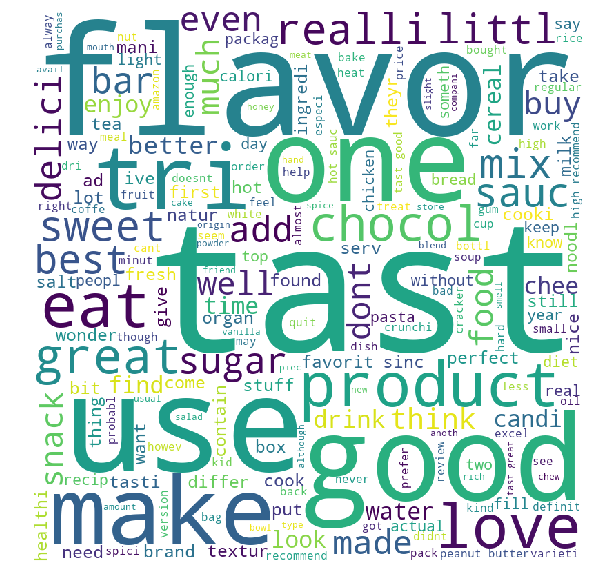

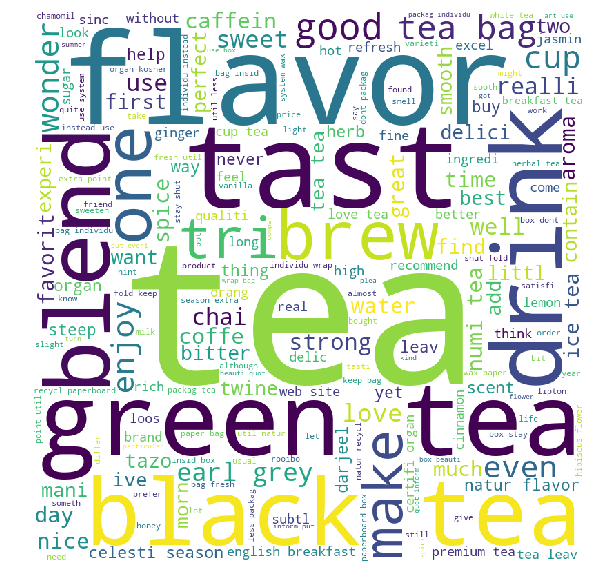

In [355]:
wordcloud_print(clean_text_all_avgw2v)

In [332]:
clf_agc_4 = AgglomerativeClustering(n_clusters = 5) #No. of clusters = 5
labels_avgw2v_c5 = clf_agc_4.fit_predict(train_avgw2v_1,y_train_1)

In [356]:
print(type(labels_avgw2v_c5))
labels_avgw2v_c5_df = pd.DataFrame(labels_avgw2v_c5)
print(type(labels_avgw2v_c5_df))

#matching the number of rows
final3 = final2[0:5000]
print(type(final3))
print(final3.shape)
#final3

#adding the values of labels in the data frame
final4 = final3
print(type(final4))
final4.reindex(columns=[*final4.columns.tolist(), 'labels'],fill_value=1)
final4['labels']=labels_avgw2v_c5_df.values
final4

<class 'numpy.ndarray'>
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>
(5000, 11)
<class 'pandas.core.frame.DataFrame'>


,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,CleanedText,labels
138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,1,939340800,EVERY book is educational,this witty little book makes my son laugh at l...,witti littl book make son laugh loud recit car...,2
138683,150501,0006641040,AJ46FKXOVC7NR,Nicholas A Mesiano,2,2,1,940809600,This whole series is great way to spend time w...,I can remember seeing the show when it aired o...,rememb see show air televis year ago child sis...,4
417839,451856,B00004CXX9,AIUWLEQ1ADEG5,Elizabeth Medina,0,0,1,944092800,Entertainingl Funny!,Beetlejuice is a well written movie ..... ever...,beetlejuic well written movi everyth excel act...,2
417859,451878,B00004CXX9,A344SMIA5JECGM,Vincent P. Ross,1,2,1,944438400,A modern day fairy tale,"A twist of rumplestiskin captured on film, sta...",twist rumplestiskin captur film star michael k...,2
417838,451855,B00004CXX9,AJH6LUC1UT1ON,The Phantom of the Opera,0,0,1,946857600,FANTASTIC!,Beetlejuice is an excellent and funny movie. K...,beetlejuic excel funni movi keaton hilari wack...,2
417927,451949,B00004CXX9,A1048CYU0OV4O8,Judy L. Eans,2,2,1,947376000,GREAT,THIS IS ONE MOVIE THAT SHOULD BE IN YOUR MOVIE...,one movi movi collect fill comedi action whate...,2
417847,451864,B00004CXX9,A1B2IZU1JLZA6,Wes,19,23,0,948240000,WARNING: CLAMSHELL EDITION IS EDITED TV VERSION,"I, myself always enjoyed this movie, it's very...",alway enjoy movi funni entertain didnt hesit p...,2
70688,76882,B00002N8SM,A32DW342WBJ6BX,Buttersugar,0,0,1,948672000,A sure death for flies,I bought a few of these after my apartment was...,bought apart infest fruit fli hour trap mani f...,2
346141,374450,B00004CI84,ACJR7EQF9S6FP,Jeremy Robertson,2,3,1,951523200,Bettlejuice...Bettlejuice...BETTLEJUICE!,What happens when you say his name three times...,happen say name three time michael keaten star...,4
417883,451903,B00004CXX9,A2DEE7F9XKP3ZR,jerome,0,1,1,959990400,Research,I'm getting crazy.<p>Is it really impossible t...,get crazi realli imposs today find french vhs ...,4


In [357]:
clean_text_all_avgw2v= list()

#copying all the data rows with label=0
clean_text_cat_0 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 0):
        clean_text_cat_0.append(((final4['CleanedText'].values)[loop1]))     
clean_text_all_avgw2v.append(clean_text_cat_0)

#copying all the data rows with label=1
clean_text_cat_1 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 1):
        clean_text_cat_1.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_1)

#copying all the data rows with label=2
clean_text_cat_2 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 2):
        clean_text_cat_2.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_2)

#copying all the data rows with label=3
clean_text_cat_3 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 3):
        clean_text_cat_3.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_3)

#copying all the data rows with label=4
clean_text_cat_4 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 4):
        clean_text_cat_4.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_4)

In [358]:
print(np.shape(clean_text_all_avgw2v))

(5,)


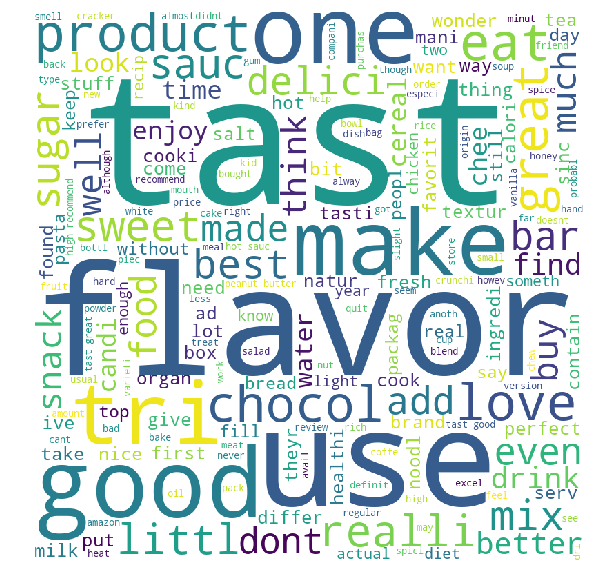

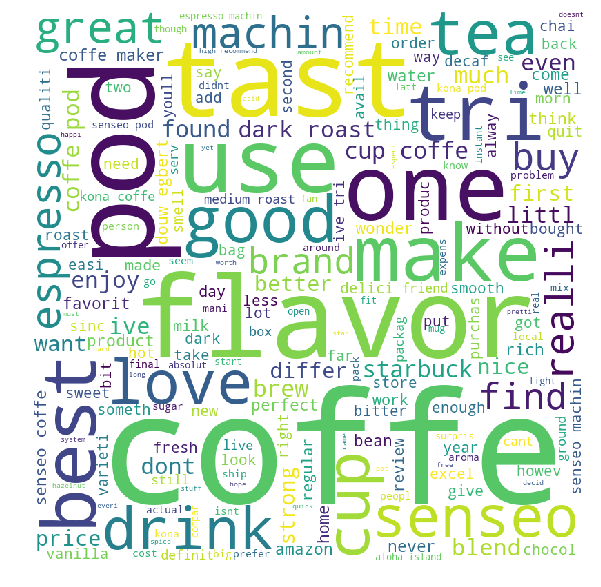

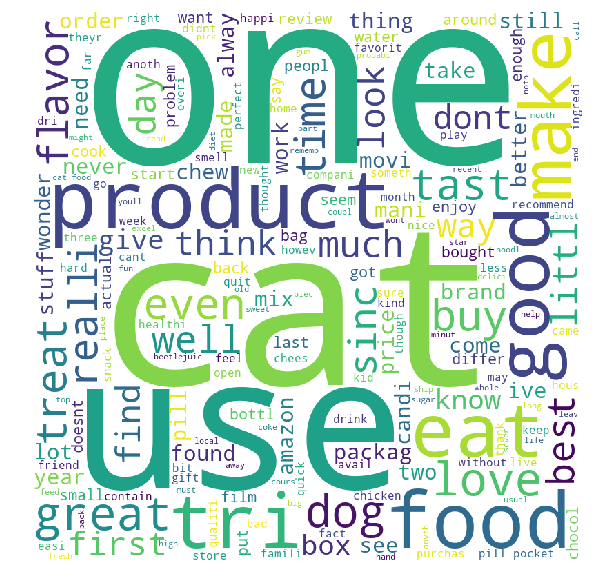

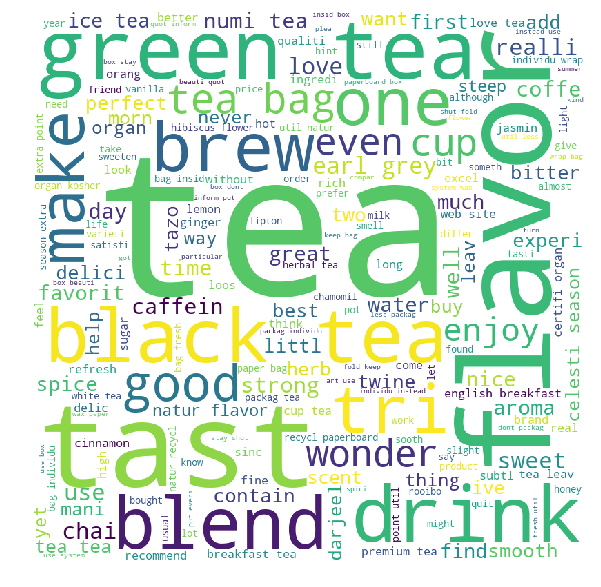

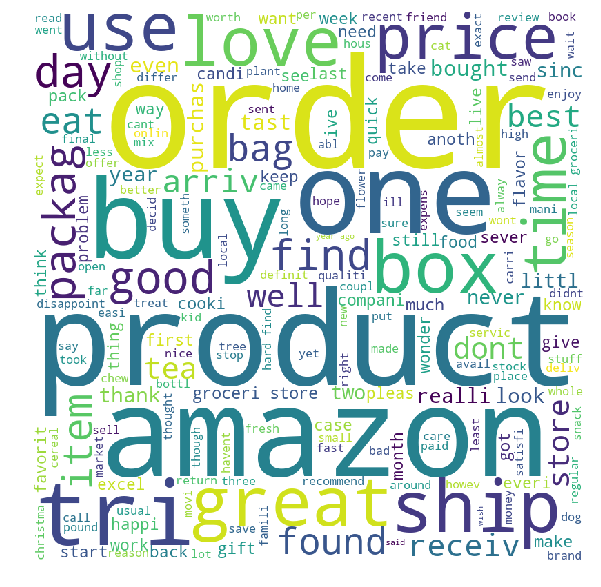

In [359]:
wordcloud_print(clean_text_all_avgw2v)

## Agglomerative Clustering on tfidf-W-W2V

In [360]:
clf_agc_1_tfidfww2v = AgglomerativeClustering(n_clusters = 2) #No. of clusters = 2
labels_tfidfww2v_c2 = clf_agc_1_tfidfww2v.fit_predict(train_tfidfww2v_1,y_train_1)

In [362]:
print(type(labels_tfidfww2v_c2))
labels_tfidfww2v_c2_df = pd.DataFrame(labels_tfidfww2v_c2)
print(type(labels_tfidfww2v_c2_df))

#matching the number of rows
final3 = final2[0:5000]
print(type(final3))
print(final3.shape)
#final3

#adding the values of labels in the data frame
final4 = final3
print(type(final4))
final4.reindex(columns=[*final4.columns.tolist(), 'labels'],fill_value=1)
final4['labels']=labels_tfidfww2v_c2_df.values
final4

<class 'numpy.ndarray'>
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>
(5000, 11)
<class 'pandas.core.frame.DataFrame'>


,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,CleanedText,labels
138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,1,939340800,EVERY book is educational,this witty little book makes my son laugh at l...,witti littl book make son laugh loud recit car...,0
138683,150501,0006641040,AJ46FKXOVC7NR,Nicholas A Mesiano,2,2,1,940809600,This whole series is great way to spend time w...,I can remember seeing the show when it aired o...,rememb see show air televis year ago child sis...,0
417839,451856,B00004CXX9,AIUWLEQ1ADEG5,Elizabeth Medina,0,0,1,944092800,Entertainingl Funny!,Beetlejuice is a well written movie ..... ever...,beetlejuic well written movi everyth excel act...,0
417859,451878,B00004CXX9,A344SMIA5JECGM,Vincent P. Ross,1,2,1,944438400,A modern day fairy tale,"A twist of rumplestiskin captured on film, sta...",twist rumplestiskin captur film star michael k...,0
417838,451855,B00004CXX9,AJH6LUC1UT1ON,The Phantom of the Opera,0,0,1,946857600,FANTASTIC!,Beetlejuice is an excellent and funny movie. K...,beetlejuic excel funni movi keaton hilari wack...,0
417927,451949,B00004CXX9,A1048CYU0OV4O8,Judy L. Eans,2,2,1,947376000,GREAT,THIS IS ONE MOVIE THAT SHOULD BE IN YOUR MOVIE...,one movi movi collect fill comedi action whate...,0
417847,451864,B00004CXX9,A1B2IZU1JLZA6,Wes,19,23,0,948240000,WARNING: CLAMSHELL EDITION IS EDITED TV VERSION,"I, myself always enjoyed this movie, it's very...",alway enjoy movi funni entertain didnt hesit p...,0
70688,76882,B00002N8SM,A32DW342WBJ6BX,Buttersugar,0,0,1,948672000,A sure death for flies,I bought a few of these after my apartment was...,bought apart infest fruit fli hour trap mani f...,0
346141,374450,B00004CI84,ACJR7EQF9S6FP,Jeremy Robertson,2,3,1,951523200,Bettlejuice...Bettlejuice...BETTLEJUICE!,What happens when you say his name three times...,happen say name three time michael keaten star...,0
417883,451903,B00004CXX9,A2DEE7F9XKP3ZR,jerome,0,1,1,959990400,Research,I'm getting crazy.<p>Is it really impossible t...,get crazi realli imposs today find french vhs ...,0


In [363]:
clean_text_all_tfidfww2v = list()

#copying all the data rows with label=0
clean_text_cat_0 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 0):
        clean_text_cat_0.append(((final4['CleanedText'].values)[loop1]))     
clean_text_all_tfidfww2v.append(clean_text_cat_0)

#copying all the data rows with label=1
clean_text_cat_1 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 1):
        clean_text_cat_1.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_1)

In [364]:
print(np.shape(clean_text_all_tfidfww2v))

(2,)


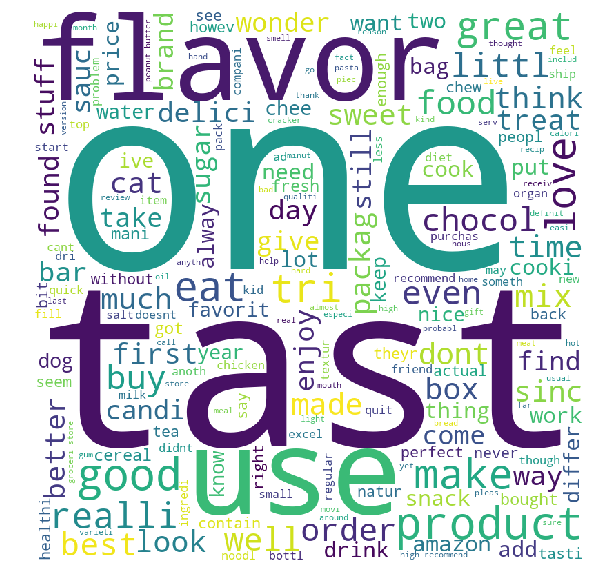

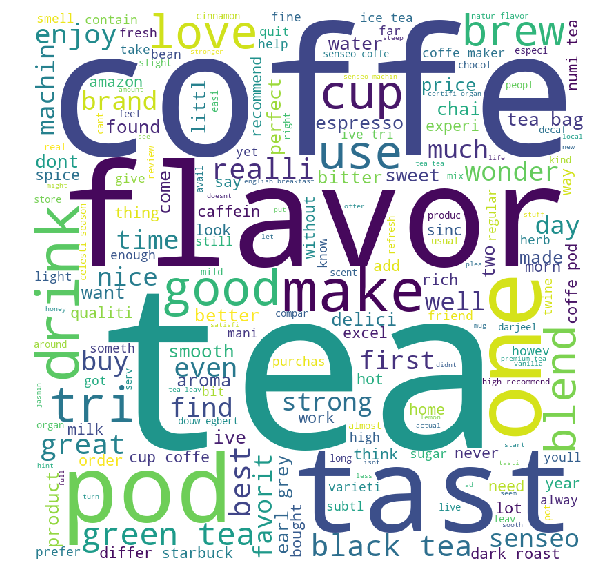

In [365]:
wordcloud_print(clean_text_all_tfidfww2v)

In [367]:
clf_agc_2_tfidfww2v = AgglomerativeClustering(n_clusters = 3) #No. of clusters = 3
labels_tfidfww2v_c3 = clf_agc_2_tfidfww2v.fit_predict(train_tfidfww2v_1,y_train_1)

In [368]:
print(type(labels_tfidfww2v_c3))
labels_tfidfww2v_c3_df = pd.DataFrame(labels_tfidfww2v_c3)
print(type(labels_tfidfww2v_c3_df))

#matching the number of rows
final3 = final2[0:5000]
print(type(final3))
print(final3.shape)
#final3

#adding the values of labels in the data frame
final4 = final3
print(type(final4))
final4.reindex(columns=[*final4.columns.tolist(), 'labels'],fill_value=1)
final4['labels']=labels_tfidfww2v_c3_df.values
final4

<class 'numpy.ndarray'>
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>
(5000, 11)
<class 'pandas.core.frame.DataFrame'>


,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,CleanedText,labels
138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,1,939340800,EVERY book is educational,this witty little book makes my son laugh at l...,witti littl book make son laugh loud recit car...,1
138683,150501,0006641040,AJ46FKXOVC7NR,Nicholas A Mesiano,2,2,1,940809600,This whole series is great way to spend time w...,I can remember seeing the show when it aired o...,rememb see show air televis year ago child sis...,1
417839,451856,B00004CXX9,AIUWLEQ1ADEG5,Elizabeth Medina,0,0,1,944092800,Entertainingl Funny!,Beetlejuice is a well written movie ..... ever...,beetlejuic well written movi everyth excel act...,1
417859,451878,B00004CXX9,A344SMIA5JECGM,Vincent P. Ross,1,2,1,944438400,A modern day fairy tale,"A twist of rumplestiskin captured on film, sta...",twist rumplestiskin captur film star michael k...,1
417838,451855,B00004CXX9,AJH6LUC1UT1ON,The Phantom of the Opera,0,0,1,946857600,FANTASTIC!,Beetlejuice is an excellent and funny movie. K...,beetlejuic excel funni movi keaton hilari wack...,1
417927,451949,B00004CXX9,A1048CYU0OV4O8,Judy L. Eans,2,2,1,947376000,GREAT,THIS IS ONE MOVIE THAT SHOULD BE IN YOUR MOVIE...,one movi movi collect fill comedi action whate...,1
417847,451864,B00004CXX9,A1B2IZU1JLZA6,Wes,19,23,0,948240000,WARNING: CLAMSHELL EDITION IS EDITED TV VERSION,"I, myself always enjoyed this movie, it's very...",alway enjoy movi funni entertain didnt hesit p...,1
70688,76882,B00002N8SM,A32DW342WBJ6BX,Buttersugar,0,0,1,948672000,A sure death for flies,I bought a few of these after my apartment was...,bought apart infest fruit fli hour trap mani f...,1
346141,374450,B00004CI84,ACJR7EQF9S6FP,Jeremy Robertson,2,3,1,951523200,Bettlejuice...Bettlejuice...BETTLEJUICE!,What happens when you say his name three times...,happen say name three time michael keaten star...,1
417883,451903,B00004CXX9,A2DEE7F9XKP3ZR,jerome,0,1,1,959990400,Research,I'm getting crazy.<p>Is it really impossible t...,get crazi realli imposs today find french vhs ...,1


In [369]:
clean_text_all_tfidfww2v = list()

#copying all the data rows with label=0
clean_text_cat_0 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 0):
        clean_text_cat_0.append(((final4['CleanedText'].values)[loop1]))     
clean_text_all_tfidfww2v.append(clean_text_cat_0)

#copying all the data rows with label=1
clean_text_cat_1 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 1):
        clean_text_cat_1.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_1)

#copying all the data rows with label=2
clean_text_cat_2 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 2):
        clean_text_cat_2.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_2)

In [370]:
print(np.shape(clean_text_all_tfidfww2v))

(3,)


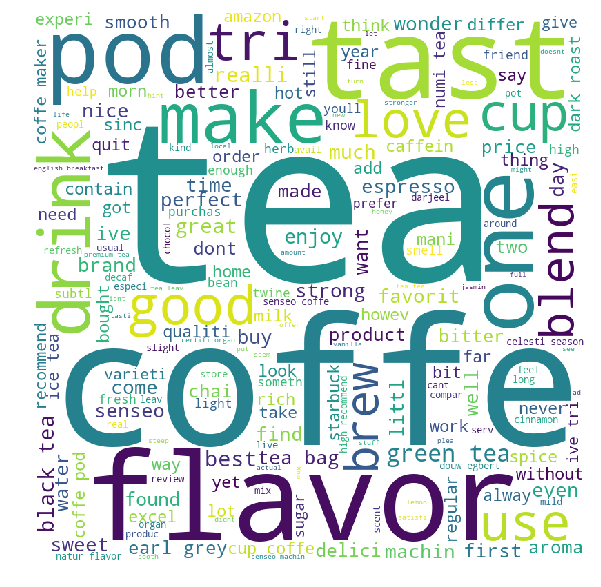

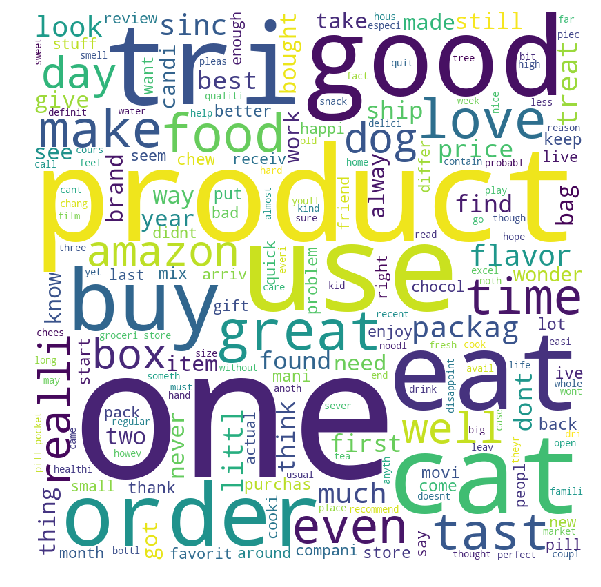

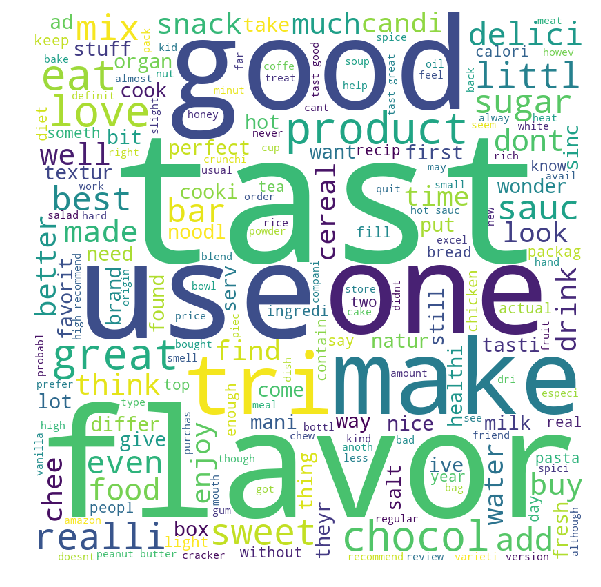

In [371]:
wordcloud_print(clean_text_all_tfidfww2v)

In [372]:
clf_agc_3_tfidfww2v = AgglomerativeClustering(n_clusters = 4) #No. of clusters = 4
labels_tfidfww2v_c4 = clf_agc_3_tfidfww2v.fit_predict(train_tfidfww2v_1,y_train_1)

In [373]:
print(type(labels_tfidfww2v_c4))
labels_tfidfww2v_c4_df = pd.DataFrame(labels_tfidfww2v_c4)
print(type(labels_tfidfww2v_c4_df))

#matching the number of rows
final3 = final2[0:5000]
print(type(final3))
print(final3.shape)
#final3

#adding the values of labels in the data frame
final4 = final3
print(type(final4))
final4.reindex(columns=[*final4.columns.tolist(), 'labels'],fill_value=1)
final4['labels']=labels_tfidfww2v_c4_df.values
final4

<class 'numpy.ndarray'>
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>
(5000, 11)
<class 'pandas.core.frame.DataFrame'>


,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,CleanedText,labels
138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,1,939340800,EVERY book is educational,this witty little book makes my son laugh at l...,witti littl book make son laugh loud recit car...,0
138683,150501,0006641040,AJ46FKXOVC7NR,Nicholas A Mesiano,2,2,1,940809600,This whole series is great way to spend time w...,I can remember seeing the show when it aired o...,rememb see show air televis year ago child sis...,0
417839,451856,B00004CXX9,AIUWLEQ1ADEG5,Elizabeth Medina,0,0,1,944092800,Entertainingl Funny!,Beetlejuice is a well written movie ..... ever...,beetlejuic well written movi everyth excel act...,0
417859,451878,B00004CXX9,A344SMIA5JECGM,Vincent P. Ross,1,2,1,944438400,A modern day fairy tale,"A twist of rumplestiskin captured on film, sta...",twist rumplestiskin captur film star michael k...,0
417838,451855,B00004CXX9,AJH6LUC1UT1ON,The Phantom of the Opera,0,0,1,946857600,FANTASTIC!,Beetlejuice is an excellent and funny movie. K...,beetlejuic excel funni movi keaton hilari wack...,0
417927,451949,B00004CXX9,A1048CYU0OV4O8,Judy L. Eans,2,2,1,947376000,GREAT,THIS IS ONE MOVIE THAT SHOULD BE IN YOUR MOVIE...,one movi movi collect fill comedi action whate...,0
417847,451864,B00004CXX9,A1B2IZU1JLZA6,Wes,19,23,0,948240000,WARNING: CLAMSHELL EDITION IS EDITED TV VERSION,"I, myself always enjoyed this movie, it's very...",alway enjoy movi funni entertain didnt hesit p...,0
70688,76882,B00002N8SM,A32DW342WBJ6BX,Buttersugar,0,0,1,948672000,A sure death for flies,I bought a few of these after my apartment was...,bought apart infest fruit fli hour trap mani f...,0
346141,374450,B00004CI84,ACJR7EQF9S6FP,Jeremy Robertson,2,3,1,951523200,Bettlejuice...Bettlejuice...BETTLEJUICE!,What happens when you say his name three times...,happen say name three time michael keaten star...,0
417883,451903,B00004CXX9,A2DEE7F9XKP3ZR,jerome,0,1,1,959990400,Research,I'm getting crazy.<p>Is it really impossible t...,get crazi realli imposs today find french vhs ...,0


In [374]:
clean_text_all_tfidfww2v = list()

#copying all the data rows with label=0
clean_text_cat_0 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 0):
        clean_text_cat_0.append(((final4['CleanedText'].values)[loop1]))     
clean_text_all_tfidfww2v.append(clean_text_cat_0)

#copying all the data rows with label=1
clean_text_cat_1 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 1):
        clean_text_cat_1.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_1)

#copying all the data rows with label=2
clean_text_cat_2 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 2):
        clean_text_cat_2.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_2)

#copying all the data rows with label=3
clean_text_cat_3 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 3):
        clean_text_cat_3.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_3)

In [375]:
print(np.shape(clean_text_all_tfidfww2v))

(4,)


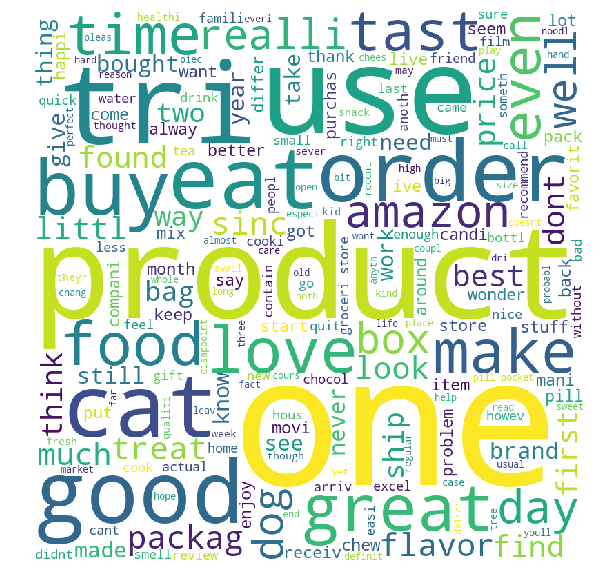

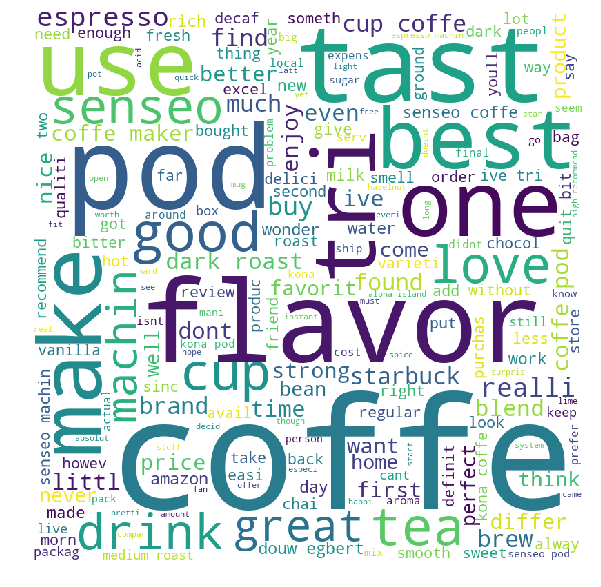

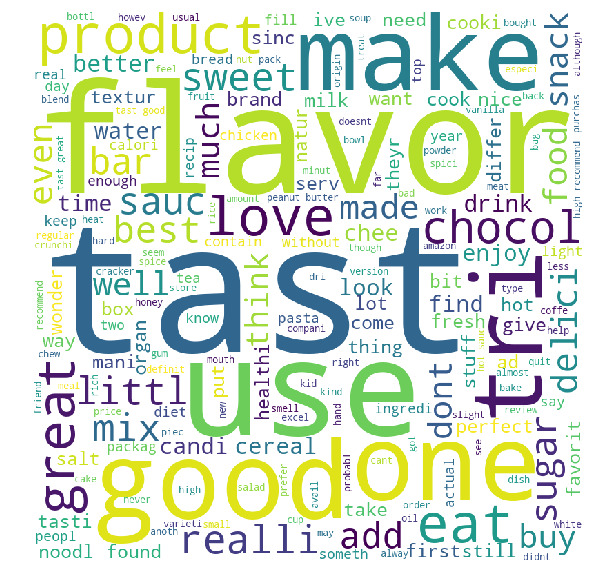

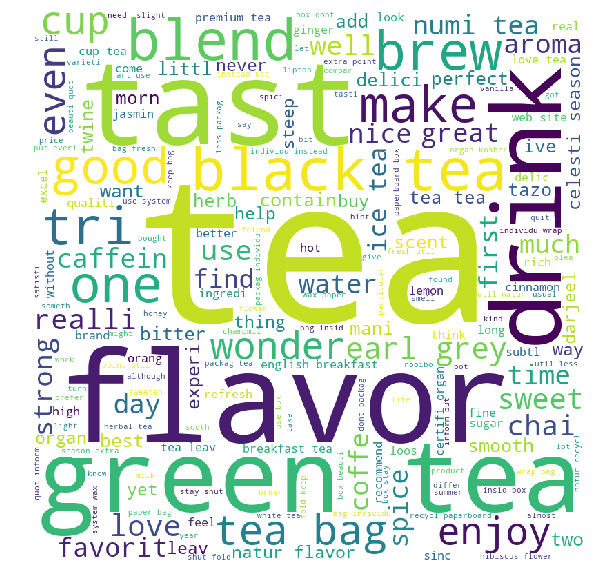

In [376]:
wordcloud_print(clean_text_all_tfidfww2v)

## Applying DBSCAN on avgW2V

In [377]:
clf_dbs_1 = DBSCAN(eps=3)
labels_avgw2v_e1 = clf_dbs_1.fit_predict(train_avgw2v_1,y_train_1)

In [381]:
print(type(labels_avgw2v_e1))
labels_avgw2v_e1_df = pd.DataFrame(labels_avgw2v_e1)
print(type(labels_avgw2v_e1_df))

#matching the number of rows
final3 = final2[0:5000]
print(type(final3))
print(final3.shape)
#final3

#adding the values of labels in the data frame
final4 = final3
print(type(final4))
final4.reindex(columns=[*final4.columns.tolist(), 'labels'],fill_value=1)
final4['labels']=labels_avgw2v_e1_df.values

n_clusters_ = len(set(labels_avgw2v_e1)) - (1 if -1 in labels_avgw2v_e1 else 0)
print ("No. of clusters formed = ",n_clusters_)

final4

<class 'numpy.ndarray'>
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>
(5000, 11)
<class 'pandas.core.frame.DataFrame'>
No. of clusters formed =  1


,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,CleanedText,labels
138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,1,939340800,EVERY book is educational,this witty little book makes my son laugh at l...,witti littl book make son laugh loud recit car...,0
138683,150501,0006641040,AJ46FKXOVC7NR,Nicholas A Mesiano,2,2,1,940809600,This whole series is great way to spend time w...,I can remember seeing the show when it aired o...,rememb see show air televis year ago child sis...,0
417839,451856,B00004CXX9,AIUWLEQ1ADEG5,Elizabeth Medina,0,0,1,944092800,Entertainingl Funny!,Beetlejuice is a well written movie ..... ever...,beetlejuic well written movi everyth excel act...,0
417859,451878,B00004CXX9,A344SMIA5JECGM,Vincent P. Ross,1,2,1,944438400,A modern day fairy tale,"A twist of rumplestiskin captured on film, sta...",twist rumplestiskin captur film star michael k...,0
417838,451855,B00004CXX9,AJH6LUC1UT1ON,The Phantom of the Opera,0,0,1,946857600,FANTASTIC!,Beetlejuice is an excellent and funny movie. K...,beetlejuic excel funni movi keaton hilari wack...,0
417927,451949,B00004CXX9,A1048CYU0OV4O8,Judy L. Eans,2,2,1,947376000,GREAT,THIS IS ONE MOVIE THAT SHOULD BE IN YOUR MOVIE...,one movi movi collect fill comedi action whate...,0
417847,451864,B00004CXX9,A1B2IZU1JLZA6,Wes,19,23,0,948240000,WARNING: CLAMSHELL EDITION IS EDITED TV VERSION,"I, myself always enjoyed this movie, it's very...",alway enjoy movi funni entertain didnt hesit p...,0
70688,76882,B00002N8SM,A32DW342WBJ6BX,Buttersugar,0,0,1,948672000,A sure death for flies,I bought a few of these after my apartment was...,bought apart infest fruit fli hour trap mani f...,0
346141,374450,B00004CI84,ACJR7EQF9S6FP,Jeremy Robertson,2,3,1,951523200,Bettlejuice...Bettlejuice...BETTLEJUICE!,What happens when you say his name three times...,happen say name three time michael keaten star...,0
417883,451903,B00004CXX9,A2DEE7F9XKP3ZR,jerome,0,1,1,959990400,Research,I'm getting crazy.<p>Is it really impossible t...,get crazi realli imposs today find french vhs ...,0


In [382]:
clean_text_all_avgw2v= list()

#copying all the data rows with label=0
clean_text_cat_0 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 0):
        clean_text_cat_0.append(((final4['CleanedText'].values)[loop1]))     
clean_text_all_avgw2v.append(clean_text_cat_0)

In [383]:
print(np.shape(clean_text_all_avgw2v))

(1, 4457)


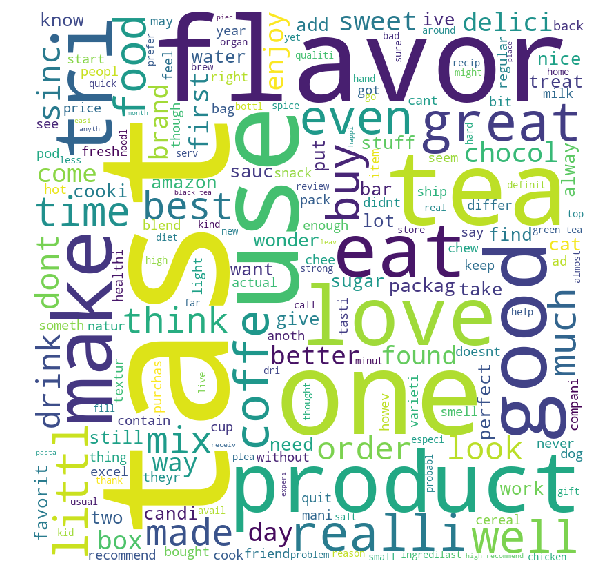

In [384]:
wordcloud_print(clean_text_all_avgw2v)

In [385]:
clf_dbs_2 = DBSCAN(eps=2)
labels_avgw2v_e2 = clf_dbs_2.fit_predict(train_avgw2v_1,y_train_1)

In [386]:
print(type(labels_avgw2v_e2))
labels_avgw2v_e2_df = pd.DataFrame(labels_avgw2v_e2)
print(type(labels_avgw2v_e2_df))

#matching the number of rows
final3 = final2[0:5000]
print(type(final3))
print(final3.shape)
#final3

#adding the values of labels in the data frame
final4 = final3
print(type(final4))
final4.reindex(columns=[*final4.columns.tolist(), 'labels'],fill_value=1)
final4['labels']=labels_avgw2v_e2_df.values

n_clusters_ = len(set(labels_avgw2v_e2)) - (1 if -1 in labels_avgw2v_e2 else 0)
print ("No. of clusters formed = ",n_clusters_)

final4

<class 'numpy.ndarray'>
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>
(5000, 11)
<class 'pandas.core.frame.DataFrame'>
No. of clusters formed =  12


,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,CleanedText,labels
138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,1,939340800,EVERY book is educational,this witty little book makes my son laugh at l...,witti littl book make son laugh loud recit car...,0
138683,150501,0006641040,AJ46FKXOVC7NR,Nicholas A Mesiano,2,2,1,940809600,This whole series is great way to spend time w...,I can remember seeing the show when it aired o...,rememb see show air televis year ago child sis...,0
417839,451856,B00004CXX9,AIUWLEQ1ADEG5,Elizabeth Medina,0,0,1,944092800,Entertainingl Funny!,Beetlejuice is a well written movie ..... ever...,beetlejuic well written movi everyth excel act...,0
417859,451878,B00004CXX9,A344SMIA5JECGM,Vincent P. Ross,1,2,1,944438400,A modern day fairy tale,"A twist of rumplestiskin captured on film, sta...",twist rumplestiskin captur film star michael k...,0
417838,451855,B00004CXX9,AJH6LUC1UT1ON,The Phantom of the Opera,0,0,1,946857600,FANTASTIC!,Beetlejuice is an excellent and funny movie. K...,beetlejuic excel funni movi keaton hilari wack...,0
417927,451949,B00004CXX9,A1048CYU0OV4O8,Judy L. Eans,2,2,1,947376000,GREAT,THIS IS ONE MOVIE THAT SHOULD BE IN YOUR MOVIE...,one movi movi collect fill comedi action whate...,0
417847,451864,B00004CXX9,A1B2IZU1JLZA6,Wes,19,23,0,948240000,WARNING: CLAMSHELL EDITION IS EDITED TV VERSION,"I, myself always enjoyed this movie, it's very...",alway enjoy movi funni entertain didnt hesit p...,0
70688,76882,B00002N8SM,A32DW342WBJ6BX,Buttersugar,0,0,1,948672000,A sure death for flies,I bought a few of these after my apartment was...,bought apart infest fruit fli hour trap mani f...,0
346141,374450,B00004CI84,ACJR7EQF9S6FP,Jeremy Robertson,2,3,1,951523200,Bettlejuice...Bettlejuice...BETTLEJUICE!,What happens when you say his name three times...,happen say name three time michael keaten star...,0
417883,451903,B00004CXX9,A2DEE7F9XKP3ZR,jerome,0,1,1,959990400,Research,I'm getting crazy.<p>Is it really impossible t...,get crazi realli imposs today find french vhs ...,0


In [388]:
clean_text_all_avgw2v = list()

#copying all the data rows with label=0
clean_text_cat_0 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 0):
        clean_text_cat_0.append(((final4['CleanedText'].values)[loop1]))     
clean_text_all_avgw2v.append(clean_text_cat_0)

#copying all the data rows with label=1
clean_text_cat_1 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 1):
        clean_text_cat_1.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_1)

#copying all the data rows with label=2
clean_text_cat_2 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 2):
        clean_text_cat_2.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_2)

#copying all the data rows with label=3
clean_text_cat_3 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 3):
        clean_text_cat_3.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_3)

#copying all the data rows with label=4
clean_text_cat_4 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 4):
        clean_text_cat_4.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_4)

#copying all the data rows with label=5
clean_text_cat_5 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 5):
        clean_text_cat_5.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_5)

#copying all the data rows with label=6
clean_text_cat_6 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 6):
        clean_text_cat_6.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_6)

#copying all the data rows with label=7
clean_text_cat_7 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 7):
        clean_text_cat_7.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_7)

#copying all the data rows with label=8
clean_text_cat_8 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 8):
        clean_text_cat_8.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_8)

#copying all the data rows with label=9
clean_text_cat_9 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 9):
        clean_text_cat_9.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_9)

#copying all the data rows with label=10
clean_text_cat_10 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 10):
        clean_text_cat_10.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_10)

#copying all the data rows with label=11
clean_text_cat_11 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 11):
        clean_text_cat_11.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_11)

In [389]:
print(np.shape(clean_text_all_avgw2v))

(13,)


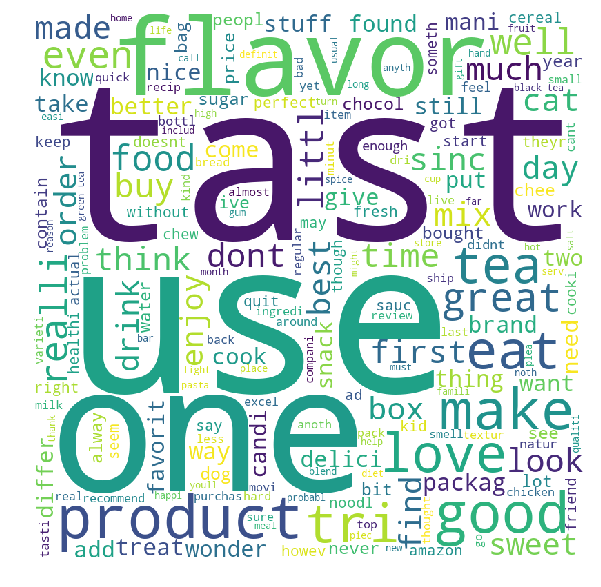

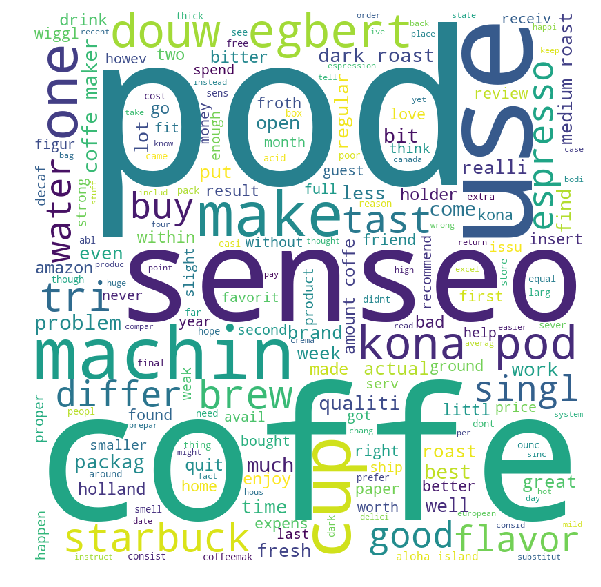

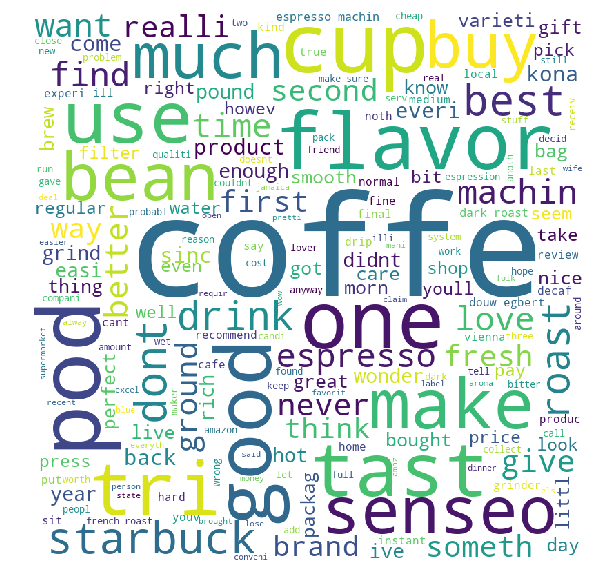

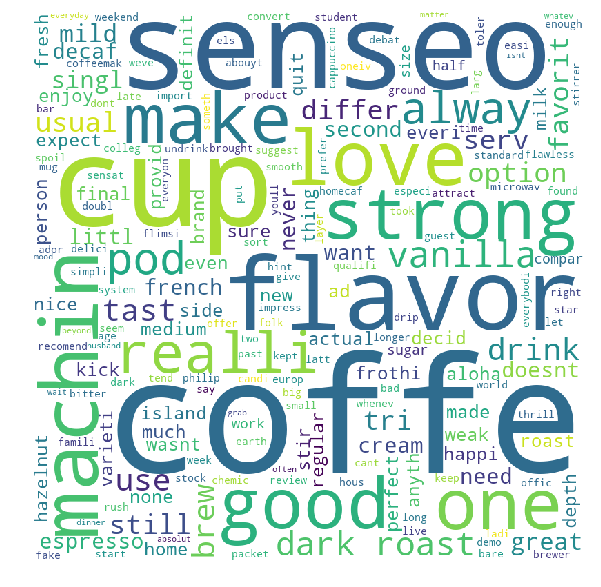

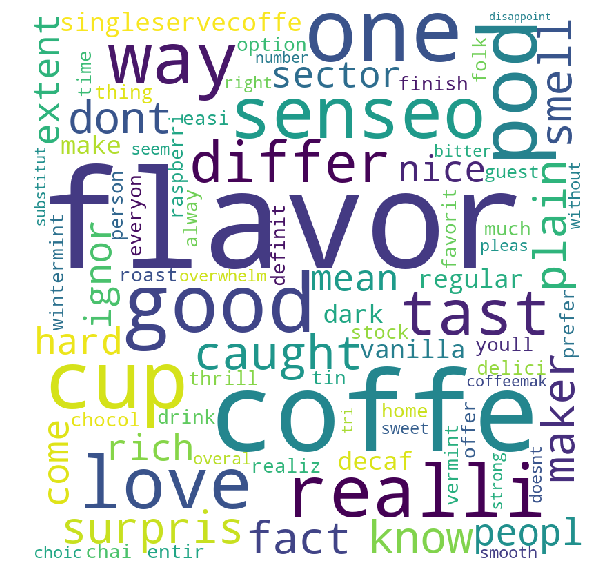

...

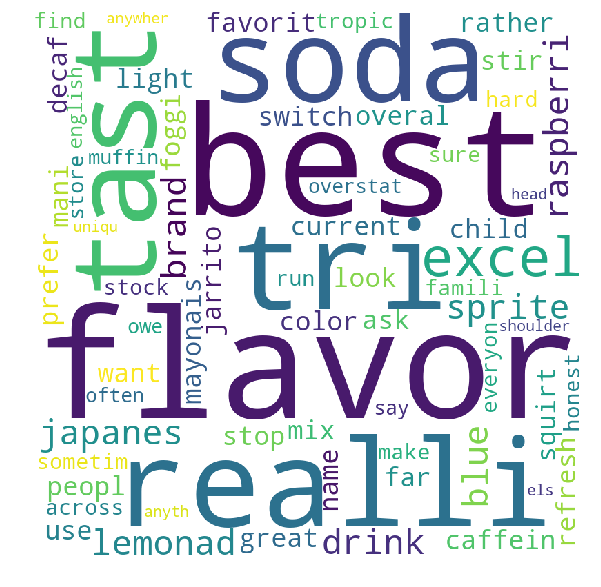

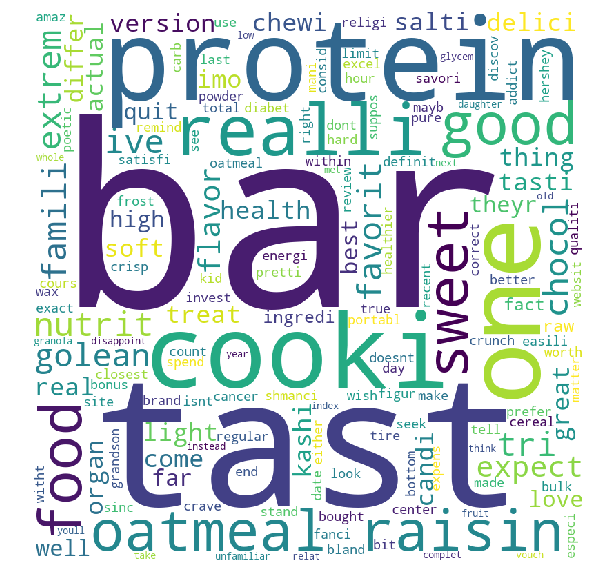

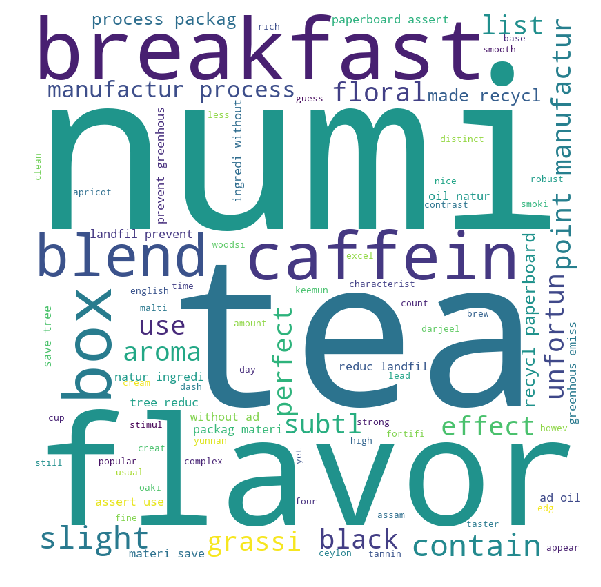

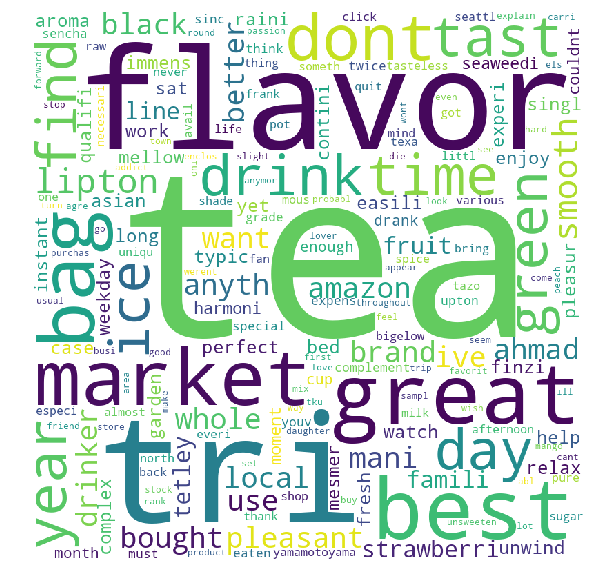

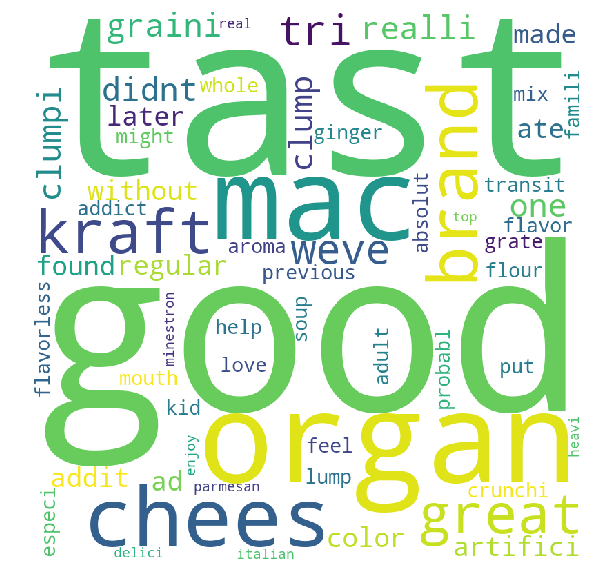

ValueError: We need at least 1 word to plot a word cloud, got 0.

In [390]:
wordcloud_print(clean_text_all_avgw2v)

In [391]:
clf_dbs_3 = DBSCAN(eps=1)
labels_avgw2v_e3 = clf_dbs_3.fit_predict(train_avgw2v_1,y_train_1)

In [392]:
print(type(labels_avgw2v_e3))
labels_avgw2v_e3_df = pd.DataFrame(labels_avgw2v_e3)
print(type(labels_avgw2v_e3_df))

#matching the number of rows
final3 = final2[0:5000]
print(type(final3))
print(final3.shape)
#final3

#adding the values of labels in the data frame
final4 = final3
print(type(final4))
final4.reindex(columns=[*final4.columns.tolist(), 'labels'],fill_value=1)
final4['labels']=labels_avgw2v_e3_df.values

n_clusters_ = len(set(labels_avgw2v_e3)) - (1 if -1 in labels_avgw2v_e3 else 0)
print ("No. of clusters formed = ",n_clusters_)

final4

<class 'numpy.ndarray'>
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>
(5000, 11)
<class 'pandas.core.frame.DataFrame'>
No. of clusters formed =  8


,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,CleanedText,labels
138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,1,939340800,EVERY book is educational,this witty little book makes my son laugh at l...,witti littl book make son laugh loud recit car...,0
138683,150501,0006641040,AJ46FKXOVC7NR,Nicholas A Mesiano,2,2,1,940809600,This whole series is great way to spend time w...,I can remember seeing the show when it aired o...,rememb see show air televis year ago child sis...,-1
417839,451856,B00004CXX9,AIUWLEQ1ADEG5,Elizabeth Medina,0,0,1,944092800,Entertainingl Funny!,Beetlejuice is a well written movie ..... ever...,beetlejuic well written movi everyth excel act...,-1
417859,451878,B00004CXX9,A344SMIA5JECGM,Vincent P. Ross,1,2,1,944438400,A modern day fairy tale,"A twist of rumplestiskin captured on film, sta...",twist rumplestiskin captur film star michael k...,-1
417838,451855,B00004CXX9,AJH6LUC1UT1ON,The Phantom of the Opera,0,0,1,946857600,FANTASTIC!,Beetlejuice is an excellent and funny movie. K...,beetlejuic excel funni movi keaton hilari wack...,-1
417927,451949,B00004CXX9,A1048CYU0OV4O8,Judy L. Eans,2,2,1,947376000,GREAT,THIS IS ONE MOVIE THAT SHOULD BE IN YOUR MOVIE...,one movi movi collect fill comedi action whate...,-1
417847,451864,B00004CXX9,A1B2IZU1JLZA6,Wes,19,23,0,948240000,WARNING: CLAMSHELL EDITION IS EDITED TV VERSION,"I, myself always enjoyed this movie, it's very...",alway enjoy movi funni entertain didnt hesit p...,2
70688,76882,B00002N8SM,A32DW342WBJ6BX,Buttersugar,0,0,1,948672000,A sure death for flies,I bought a few of these after my apartment was...,bought apart infest fruit fli hour trap mani f...,-1
346141,374450,B00004CI84,ACJR7EQF9S6FP,Jeremy Robertson,2,3,1,951523200,Bettlejuice...Bettlejuice...BETTLEJUICE!,What happens when you say his name three times...,happen say name three time michael keaten star...,-1
417883,451903,B00004CXX9,A2DEE7F9XKP3ZR,jerome,0,1,1,959990400,Research,I'm getting crazy.<p>Is it really impossible t...,get crazi realli imposs today find french vhs ...,-1


In [393]:
clean_text_all_avgw2v = list()

#copying all the data rows with label=0
clean_text_cat_0 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 0):
        clean_text_cat_0.append(((final4['CleanedText'].values)[loop1]))     
clean_text_all_avgw2v.append(clean_text_cat_0)

#copying all the data rows with label=1
clean_text_cat_1 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 1):
        clean_text_cat_1.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_1)

#copying all the data rows with label=2
clean_text_cat_2 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 2):
        clean_text_cat_2.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_2)

#copying all the data rows with label=3
clean_text_cat_3 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 3):
        clean_text_cat_3.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_3)

#copying all the data rows with label=4
clean_text_cat_4 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 4):
        clean_text_cat_4.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_4)

#copying all the data rows with label=5
clean_text_cat_5 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 5):
        clean_text_cat_5.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_5)

#copying all the data rows with label=6
clean_text_cat_6 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 6):
        clean_text_cat_6.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_6)

#copying all the data rows with label=7
clean_text_cat_7 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 7):
        clean_text_cat_7.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_7)

In [394]:
print(np.shape(clean_text_all_avgw2v))

(8,)


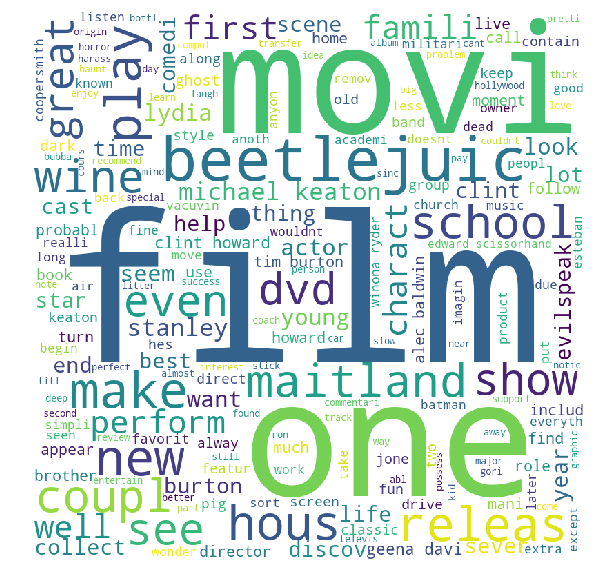

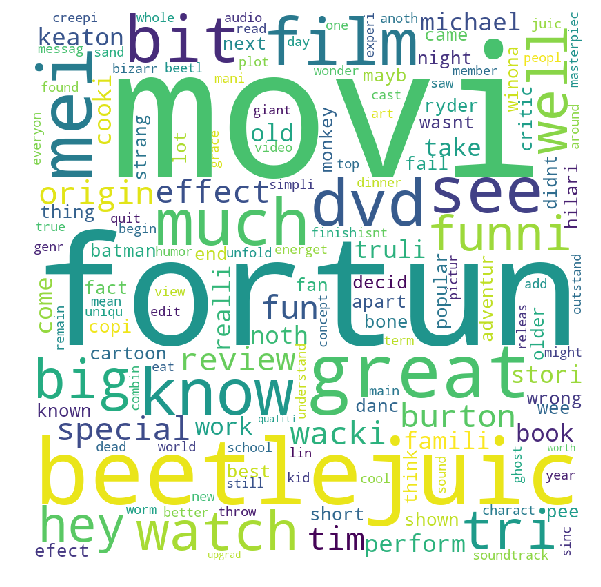

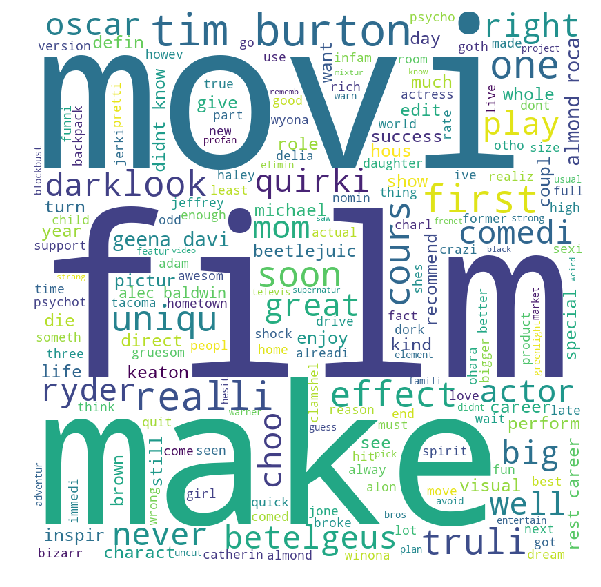

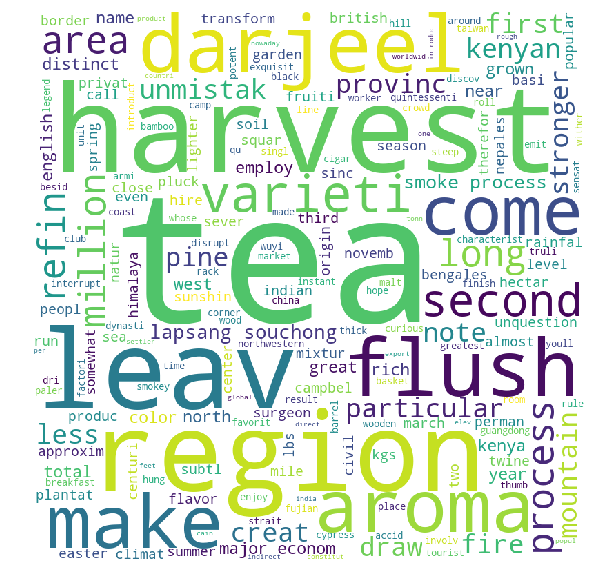

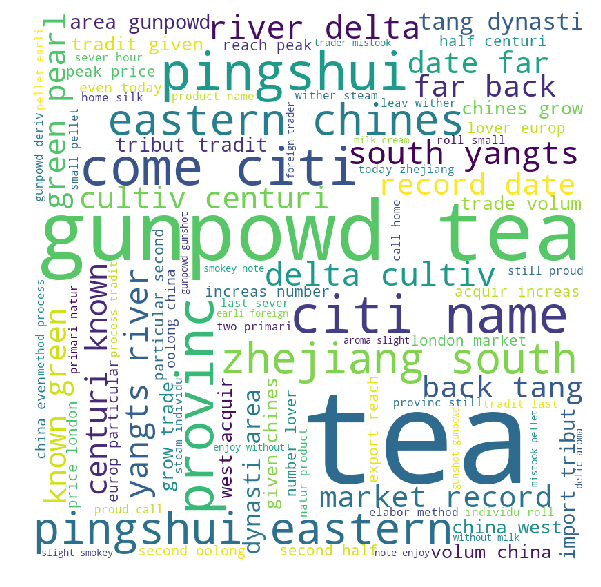

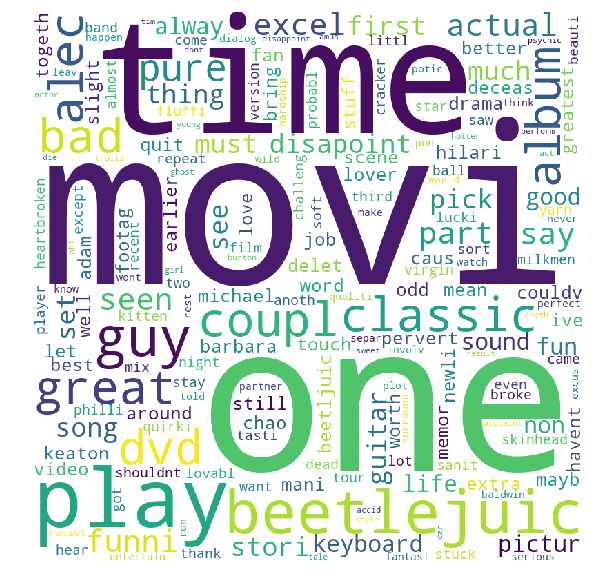

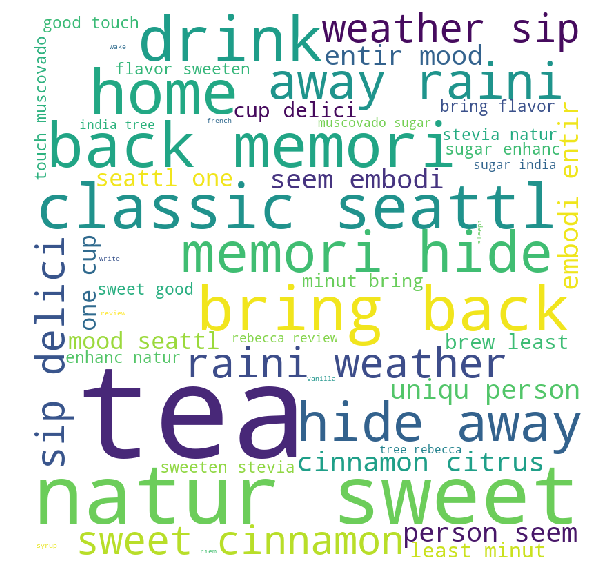

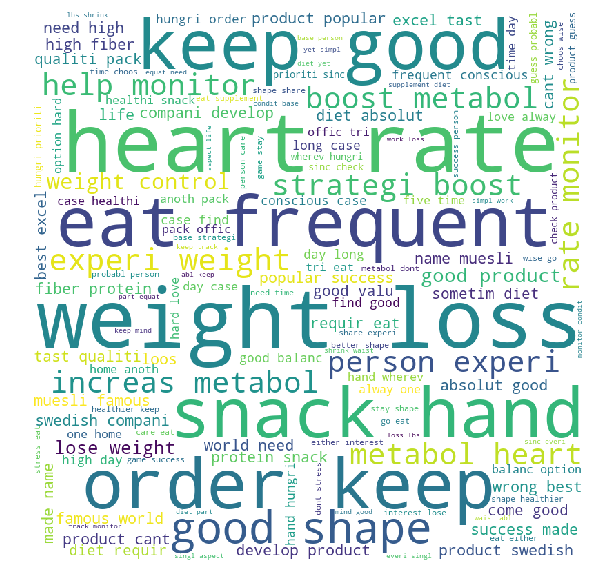

In [395]:
wordcloud_print(clean_text_all_avgw2v)

In [396]:
clf_dbs_4 = DBSCAN(eps=0.5)
labels_avgw2v_e4 = clf_dbs_4.fit_predict(train_avgw2v_1,y_train_1)

In [397]:
print(type(labels_avgw2v_e4))
labels_avgw2v_e4_df = pd.DataFrame(labels_avgw2v_e4)
print(type(labels_avgw2v_e4_df))

#matching the number of rows
final3 = final2[0:5000]
print(type(final3))
print(final3.shape)
#final3

#adding the values of labels in the data frame
final4 = final3
print(type(final4))
final4.reindex(columns=[*final4.columns.tolist(), 'labels'],fill_value=1)
final4['labels']=labels_avgw2v_e4_df.values

n_clusters_ = len(set(labels_avgw2v_e4)) - (1 if -1 in labels_avgw2v_e4 else 0)
print ("No. of clusters formed = ",n_clusters_)

final4

<class 'numpy.ndarray'>
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>
(5000, 11)
<class 'pandas.core.frame.DataFrame'>
No. of clusters formed =  2


,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,CleanedText,labels
138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,1,939340800,EVERY book is educational,this witty little book makes my son laugh at l...,witti littl book make son laugh loud recit car...,-1
138683,150501,0006641040,AJ46FKXOVC7NR,Nicholas A Mesiano,2,2,1,940809600,This whole series is great way to spend time w...,I can remember seeing the show when it aired o...,rememb see show air televis year ago child sis...,-1
417839,451856,B00004CXX9,AIUWLEQ1ADEG5,Elizabeth Medina,0,0,1,944092800,Entertainingl Funny!,Beetlejuice is a well written movie ..... ever...,beetlejuic well written movi everyth excel act...,-1
417859,451878,B00004CXX9,A344SMIA5JECGM,Vincent P. Ross,1,2,1,944438400,A modern day fairy tale,"A twist of rumplestiskin captured on film, sta...",twist rumplestiskin captur film star michael k...,-1
417838,451855,B00004CXX9,AJH6LUC1UT1ON,The Phantom of the Opera,0,0,1,946857600,FANTASTIC!,Beetlejuice is an excellent and funny movie. K...,beetlejuic excel funni movi keaton hilari wack...,-1
417927,451949,B00004CXX9,A1048CYU0OV4O8,Judy L. Eans,2,2,1,947376000,GREAT,THIS IS ONE MOVIE THAT SHOULD BE IN YOUR MOVIE...,one movi movi collect fill comedi action whate...,-1
417847,451864,B00004CXX9,A1B2IZU1JLZA6,Wes,19,23,0,948240000,WARNING: CLAMSHELL EDITION IS EDITED TV VERSION,"I, myself always enjoyed this movie, it's very...",alway enjoy movi funni entertain didnt hesit p...,-1
70688,76882,B00002N8SM,A32DW342WBJ6BX,Buttersugar,0,0,1,948672000,A sure death for flies,I bought a few of these after my apartment was...,bought apart infest fruit fli hour trap mani f...,-1
346141,374450,B00004CI84,ACJR7EQF9S6FP,Jeremy Robertson,2,3,1,951523200,Bettlejuice...Bettlejuice...BETTLEJUICE!,What happens when you say his name three times...,happen say name three time michael keaten star...,-1
417883,451903,B00004CXX9,A2DEE7F9XKP3ZR,jerome,0,1,1,959990400,Research,I'm getting crazy.<p>Is it really impossible t...,get crazi realli imposs today find french vhs ...,-1


In [398]:
clean_text_all_avgw2v = list()

#copying all the data rows with label=0
clean_text_cat_0 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 0):
        clean_text_cat_0.append(((final4['CleanedText'].values)[loop1]))     
clean_text_all_avgw2v.append(clean_text_cat_0)

#copying all the data rows with label=1
clean_text_cat_1 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 1):
        clean_text_cat_1.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_avgw2v.append(clean_text_cat_1)

In [402]:
print(np.shape(clean_text_all_avgw2v))

(2, 5)


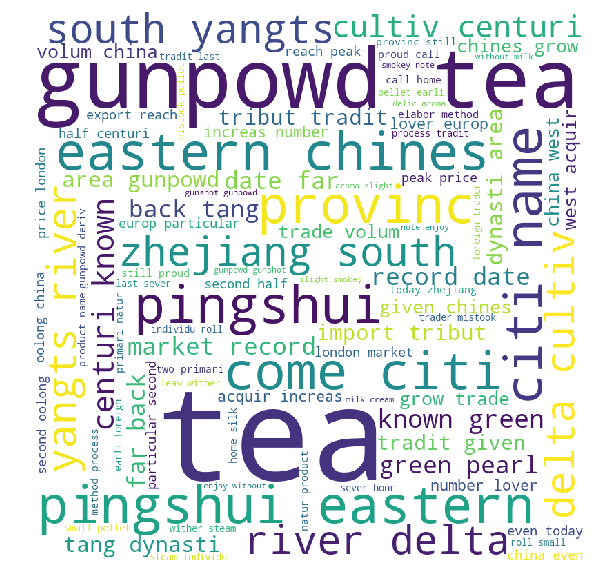

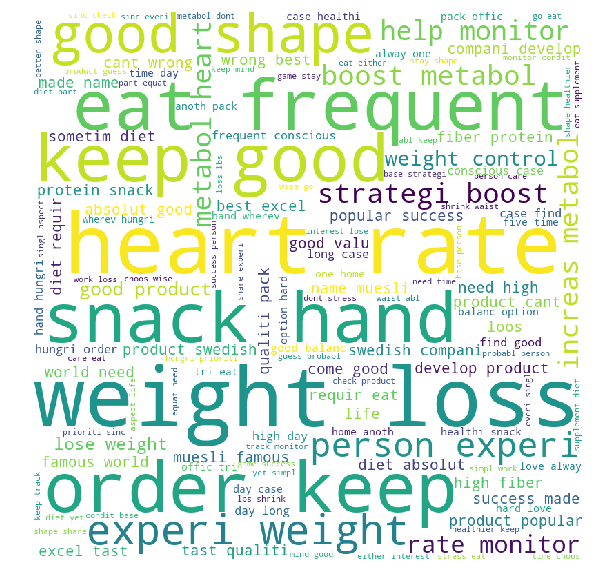

In [400]:
wordcloud_print(clean_text_all_avgw2v)

## Applying DBSCAN on tfidf-W-W2V

In [403]:
clf_dbs_1_tfidfww2v = DBSCAN(eps=3)
labels_tfidfww2v_e1 = clf_dbs_1_tfidfww2v.fit_predict(train_tfidfww2v_1,y_train_1)

In [404]:
print(type(labels_tfidfww2v_e1))
labels_tfidfww2v_e1_df = pd.DataFrame(labels_tfidfww2v_e1)
print(type(labels_tfidfww2v_e1_df))

#matching the number of rows
final3 = final2[0:5000]
print(type(final3))
print(final3.shape)
#final3

#adding the values of labels in the data frame
final4 = final3
print(type(final4))
final4.reindex(columns=[*final4.columns.tolist(), 'labels'],fill_value=1)
final4['labels']=labels_tfidfww2v_e1_df.values

n_clusters_ = len(set(labels_tfidfww2v_e1)) - (1 if -1 in labels_tfidfww2v_e1 else 0)
print ("No. of clusters formed = ",n_clusters_)

final4

<class 'numpy.ndarray'>
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>
(5000, 11)
<class 'pandas.core.frame.DataFrame'>
No. of clusters formed =  1


,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,CleanedText,labels
138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,1,939340800,EVERY book is educational,this witty little book makes my son laugh at l...,witti littl book make son laugh loud recit car...,0
138683,150501,0006641040,AJ46FKXOVC7NR,Nicholas A Mesiano,2,2,1,940809600,This whole series is great way to spend time w...,I can remember seeing the show when it aired o...,rememb see show air televis year ago child sis...,0
417839,451856,B00004CXX9,AIUWLEQ1ADEG5,Elizabeth Medina,0,0,1,944092800,Entertainingl Funny!,Beetlejuice is a well written movie ..... ever...,beetlejuic well written movi everyth excel act...,0
417859,451878,B00004CXX9,A344SMIA5JECGM,Vincent P. Ross,1,2,1,944438400,A modern day fairy tale,"A twist of rumplestiskin captured on film, sta...",twist rumplestiskin captur film star michael k...,0
417838,451855,B00004CXX9,AJH6LUC1UT1ON,The Phantom of the Opera,0,0,1,946857600,FANTASTIC!,Beetlejuice is an excellent and funny movie. K...,beetlejuic excel funni movi keaton hilari wack...,0
417927,451949,B00004CXX9,A1048CYU0OV4O8,Judy L. Eans,2,2,1,947376000,GREAT,THIS IS ONE MOVIE THAT SHOULD BE IN YOUR MOVIE...,one movi movi collect fill comedi action whate...,0
417847,451864,B00004CXX9,A1B2IZU1JLZA6,Wes,19,23,0,948240000,WARNING: CLAMSHELL EDITION IS EDITED TV VERSION,"I, myself always enjoyed this movie, it's very...",alway enjoy movi funni entertain didnt hesit p...,0
70688,76882,B00002N8SM,A32DW342WBJ6BX,Buttersugar,0,0,1,948672000,A sure death for flies,I bought a few of these after my apartment was...,bought apart infest fruit fli hour trap mani f...,0
346141,374450,B00004CI84,ACJR7EQF9S6FP,Jeremy Robertson,2,3,1,951523200,Bettlejuice...Bettlejuice...BETTLEJUICE!,What happens when you say his name three times...,happen say name three time michael keaten star...,0
417883,451903,B00004CXX9,A2DEE7F9XKP3ZR,jerome,0,1,1,959990400,Research,I'm getting crazy.<p>Is it really impossible t...,get crazi realli imposs today find french vhs ...,0


In [405]:
clean_text_all_tfidfww2v = list()

#copying all the data rows with label=0
clean_text_cat_0 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 0):
        clean_text_cat_0.append(((final4['CleanedText'].values)[loop1]))     
clean_text_all_tfidfww2v.append(clean_text_cat_0)

In [407]:
print(np.shape(clean_text_all_tfidfww2v))

(1, 4457)


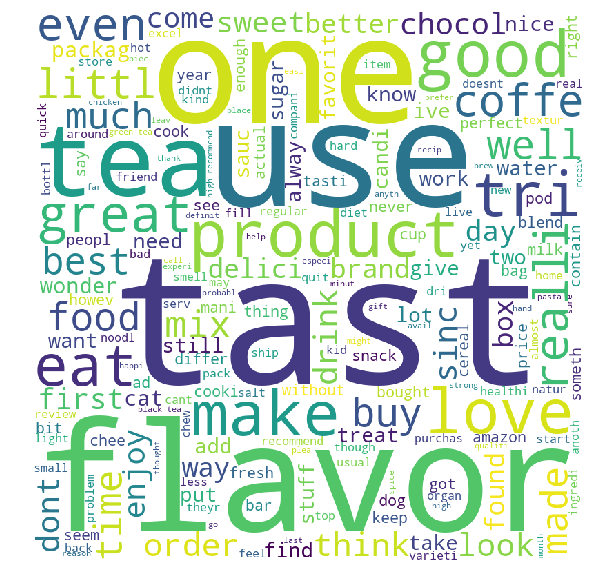

In [408]:
wordcloud_print(clean_text_all_tfidfww2v)

In [410]:
clf_dbs_2_tfidfww2v = DBSCAN(eps=2)
labels_tfidfww2v_e2 = clf_dbs_2_tfidfww2v.fit_predict(train_tfidfww2v_1,y_train_1)

In [411]:
print(type(labels_tfidfww2v_e2))
labels_tfidfww2v_e2_df = pd.DataFrame(labels_tfidfww2v_e2)
print(type(labels_tfidfww2v_e2_df))

#matching the number of rows
final3 = final2[0:5000]
print(type(final3))
print(final3.shape)
#final3

#adding the values of labels in the data frame
final4 = final3
print(type(final4))
final4.reindex(columns=[*final4.columns.tolist(), 'labels'],fill_value=1)
final4['labels']=labels_tfidfww2v_e2_df.values

n_clusters_ = len(set(labels_tfidfww2v_e2)) - (1 if -1 in labels_tfidfww2v_e2 else 0)
print ("No. of clusters formed = ",n_clusters_)

final4

<class 'numpy.ndarray'>
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>
(5000, 11)
<class 'pandas.core.frame.DataFrame'>
No. of clusters formed =  12


,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,CleanedText,labels
138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,1,939340800,EVERY book is educational,this witty little book makes my son laugh at l...,witti littl book make son laugh loud recit car...,0
138683,150501,0006641040,AJ46FKXOVC7NR,Nicholas A Mesiano,2,2,1,940809600,This whole series is great way to spend time w...,I can remember seeing the show when it aired o...,rememb see show air televis year ago child sis...,0
417839,451856,B00004CXX9,AIUWLEQ1ADEG5,Elizabeth Medina,0,0,1,944092800,Entertainingl Funny!,Beetlejuice is a well written movie ..... ever...,beetlejuic well written movi everyth excel act...,0
417859,451878,B00004CXX9,A344SMIA5JECGM,Vincent P. Ross,1,2,1,944438400,A modern day fairy tale,"A twist of rumplestiskin captured on film, sta...",twist rumplestiskin captur film star michael k...,0
417838,451855,B00004CXX9,AJH6LUC1UT1ON,The Phantom of the Opera,0,0,1,946857600,FANTASTIC!,Beetlejuice is an excellent and funny movie. K...,beetlejuic excel funni movi keaton hilari wack...,0
417927,451949,B00004CXX9,A1048CYU0OV4O8,Judy L. Eans,2,2,1,947376000,GREAT,THIS IS ONE MOVIE THAT SHOULD BE IN YOUR MOVIE...,one movi movi collect fill comedi action whate...,0
417847,451864,B00004CXX9,A1B2IZU1JLZA6,Wes,19,23,0,948240000,WARNING: CLAMSHELL EDITION IS EDITED TV VERSION,"I, myself always enjoyed this movie, it's very...",alway enjoy movi funni entertain didnt hesit p...,0
70688,76882,B00002N8SM,A32DW342WBJ6BX,Buttersugar,0,0,1,948672000,A sure death for flies,I bought a few of these after my apartment was...,bought apart infest fruit fli hour trap mani f...,0
346141,374450,B00004CI84,ACJR7EQF9S6FP,Jeremy Robertson,2,3,1,951523200,Bettlejuice...Bettlejuice...BETTLEJUICE!,What happens when you say his name three times...,happen say name three time michael keaten star...,0
417883,451903,B00004CXX9,A2DEE7F9XKP3ZR,jerome,0,1,1,959990400,Research,I'm getting crazy.<p>Is it really impossible t...,get crazi realli imposs today find french vhs ...,0


In [412]:
clean_text_all_tfidfww2v = list()

#copying all the data rows with label=0
clean_text_cat_0 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 0):
        clean_text_cat_0.append(((final4['CleanedText'].values)[loop1]))     
clean_text_all_tfidfww2v.append(clean_text_cat_0)

#copying all the data rows with label=1
clean_text_cat_1 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 1):
        clean_text_cat_1.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_1)

#copying all the data rows with label=2
clean_text_cat_2 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 2):
        clean_text_cat_2.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_2)

#copying all the data rows with label=3
clean_text_cat_3 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 3):
        clean_text_cat_3.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_3)

#copying all the data rows with label=4
clean_text_cat_4 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 4):
        clean_text_cat_4.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_4)

#copying all the data rows with label=5
clean_text_cat_5 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 5):
        clean_text_cat_5.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_5)

#copying all the data rows with label=6
clean_text_cat_6 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 6):
        clean_text_cat_6.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_6)

#copying all the data rows with label=7
clean_text_cat_7 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 7):
        clean_text_cat_7.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_7)

#copying all the data rows with label=8
clean_text_cat_8 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 8):
        clean_text_cat_8.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_8)

#copying all the data rows with label=9
clean_text_cat_9 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 9):
        clean_text_cat_9.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_9)

#copying all the data rows with label=10
clean_text_cat_10 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 10):
        clean_text_cat_10.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_10)

#copying all the data rows with label=11
clean_text_cat_11 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 11):
        clean_text_cat_11.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_11)

In [413]:
print(np.shape(clean_text_all_tfidfww2v))

(12,)


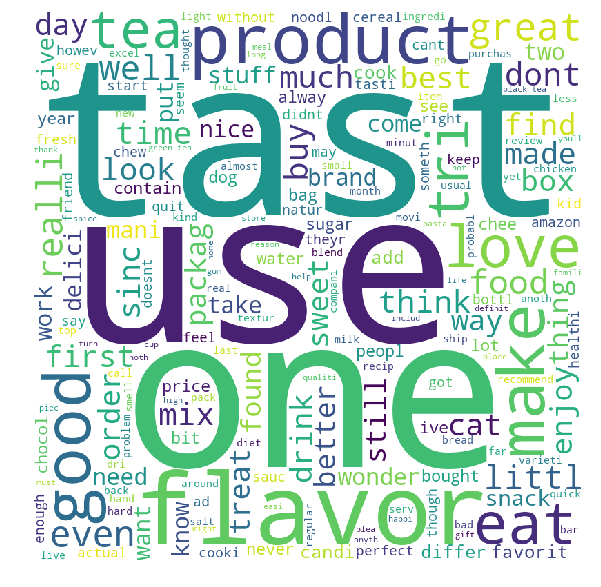

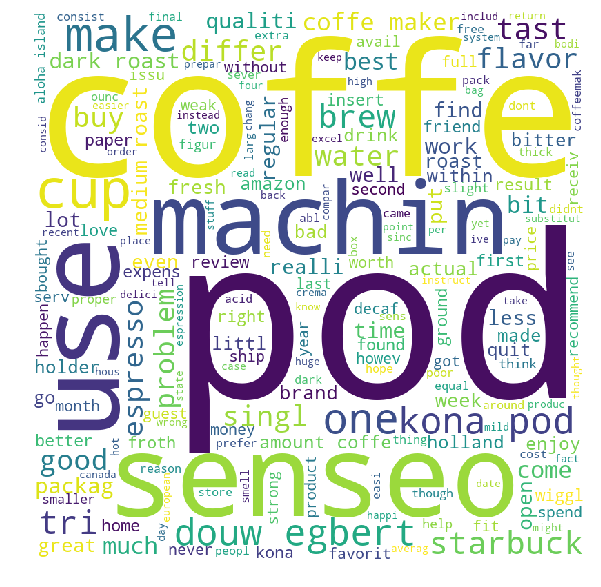

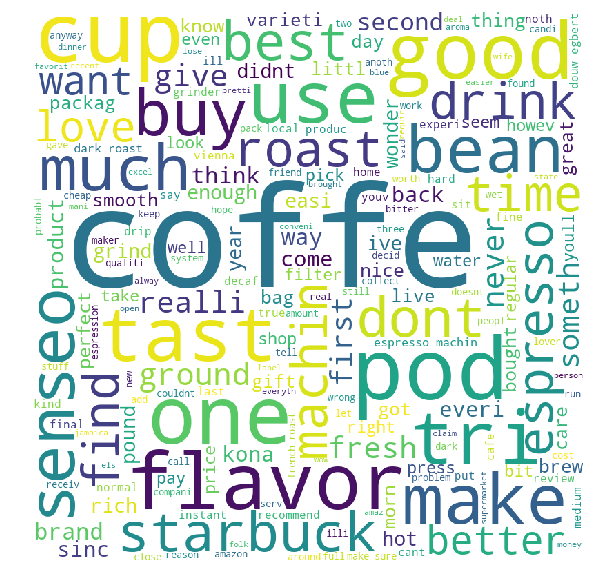

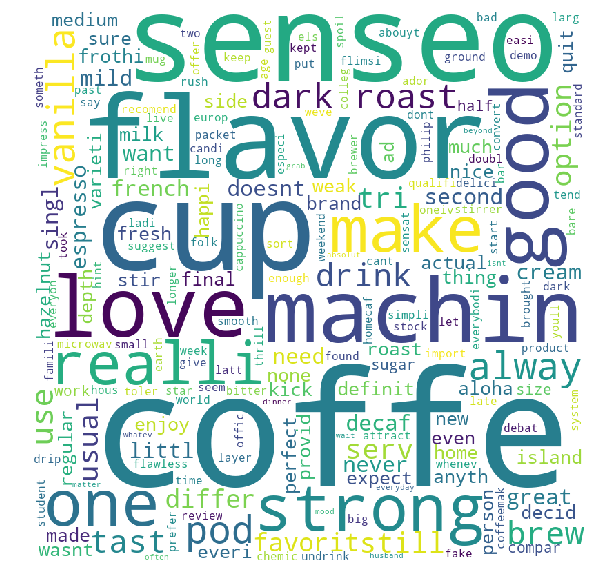

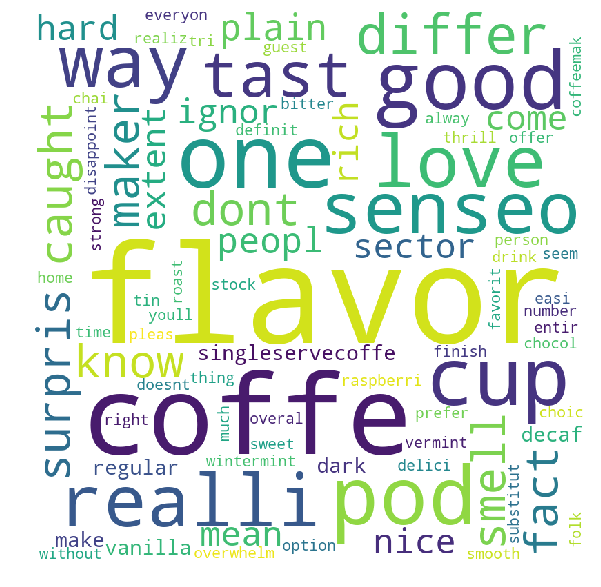

...

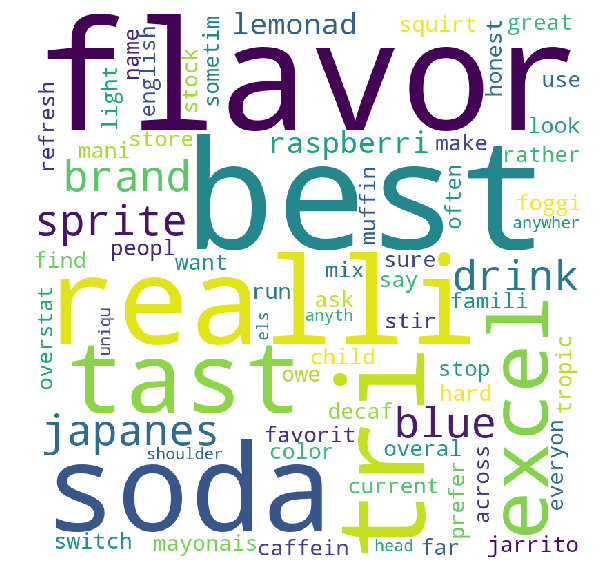

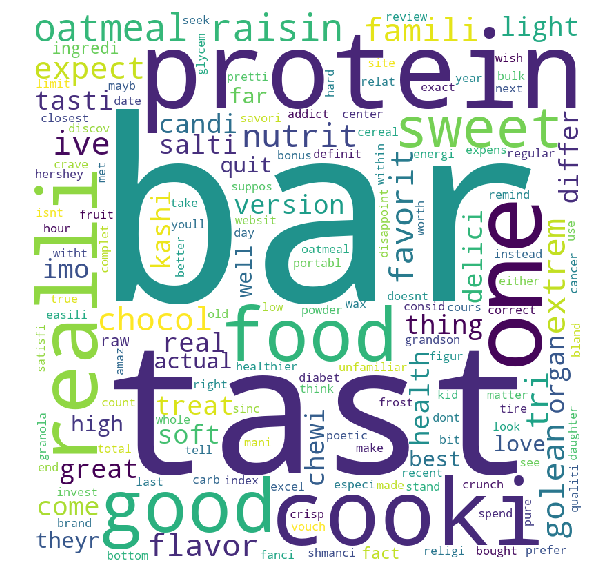

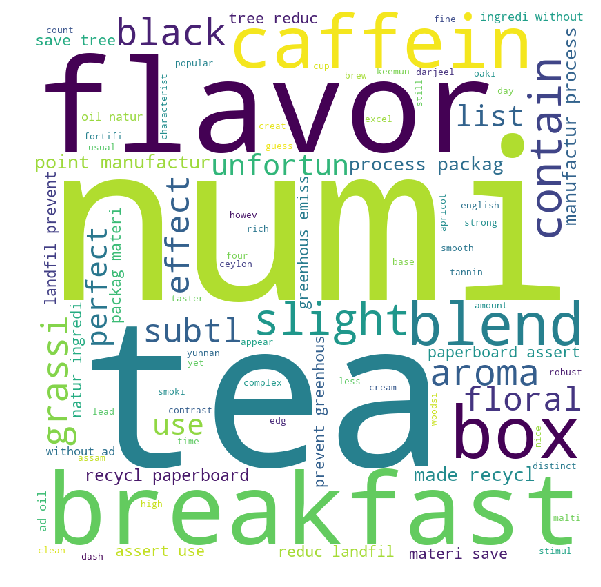

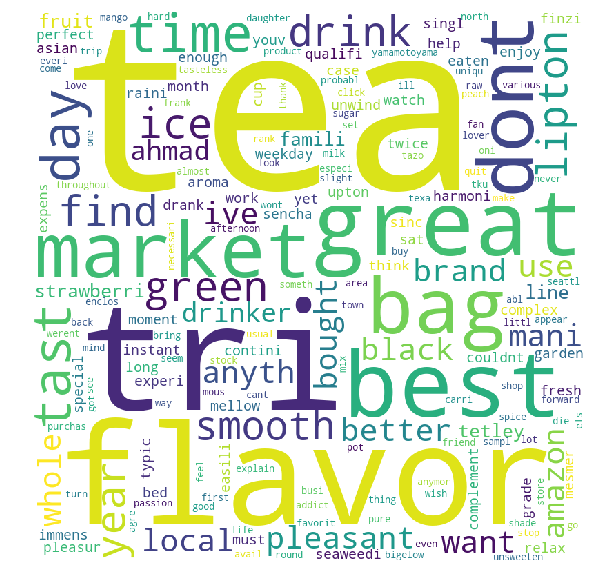

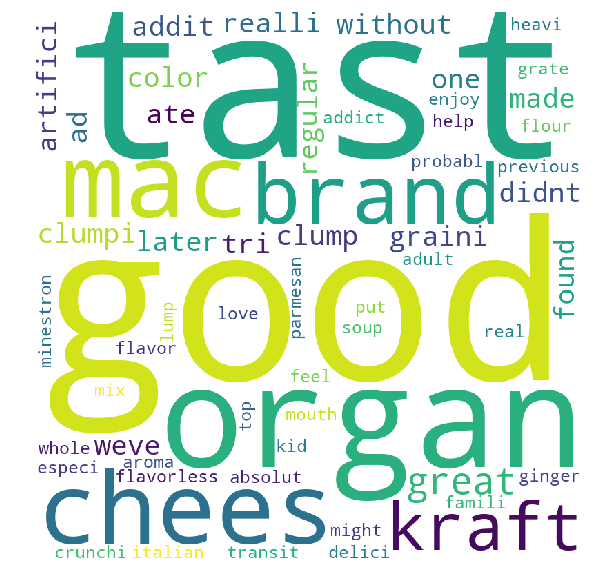

In [414]:
wordcloud_print(clean_text_all_tfidfww2v)

In [415]:
clf_dbs_3_tfidfww2v = DBSCAN(eps=1)
labels_tfidfww2v_e3 = clf_dbs_3_tfidfww2v.fit_predict(train_tfidfww2v_1,y_train_1)

In [416]:
print(type(labels_tfidfww2v_e3))
labels_tfidfww2v_e3_df = pd.DataFrame(labels_tfidfww2v_e3)
print(type(labels_tfidfww2v_e3_df))

#matching the number of rows
final3 = final2[0:5000]
print(type(final3))
print(final3.shape)
#final3

#adding the values of labels in the data frame
final4 = final3
print(type(final4))
final4.reindex(columns=[*final4.columns.tolist(), 'labels'],fill_value=1)
final4['labels']=labels_tfidfww2v_e3_df.values

n_clusters_ = len(set(labels_tfidfww2v_e3)) - (1 if -1 in labels_tfidfww2v_e3 else 0)
print ("No. of clusters formed = ",n_clusters_)

final4

<class 'numpy.ndarray'>
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>
(5000, 11)
<class 'pandas.core.frame.DataFrame'>
No. of clusters formed =  8


,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,CleanedText,labels
138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,1,939340800,EVERY book is educational,this witty little book makes my son laugh at l...,witti littl book make son laugh loud recit car...,0
138683,150501,0006641040,AJ46FKXOVC7NR,Nicholas A Mesiano,2,2,1,940809600,This whole series is great way to spend time w...,I can remember seeing the show when it aired o...,rememb see show air televis year ago child sis...,-1
417839,451856,B00004CXX9,AIUWLEQ1ADEG5,Elizabeth Medina,0,0,1,944092800,Entertainingl Funny!,Beetlejuice is a well written movie ..... ever...,beetlejuic well written movi everyth excel act...,-1
417859,451878,B00004CXX9,A344SMIA5JECGM,Vincent P. Ross,1,2,1,944438400,A modern day fairy tale,"A twist of rumplestiskin captured on film, sta...",twist rumplestiskin captur film star michael k...,-1
417838,451855,B00004CXX9,AJH6LUC1UT1ON,The Phantom of the Opera,0,0,1,946857600,FANTASTIC!,Beetlejuice is an excellent and funny movie. K...,beetlejuic excel funni movi keaton hilari wack...,-1
417927,451949,B00004CXX9,A1048CYU0OV4O8,Judy L. Eans,2,2,1,947376000,GREAT,THIS IS ONE MOVIE THAT SHOULD BE IN YOUR MOVIE...,one movi movi collect fill comedi action whate...,-1
417847,451864,B00004CXX9,A1B2IZU1JLZA6,Wes,19,23,0,948240000,WARNING: CLAMSHELL EDITION IS EDITED TV VERSION,"I, myself always enjoyed this movie, it's very...",alway enjoy movi funni entertain didnt hesit p...,2
70688,76882,B00002N8SM,A32DW342WBJ6BX,Buttersugar,0,0,1,948672000,A sure death for flies,I bought a few of these after my apartment was...,bought apart infest fruit fli hour trap mani f...,-1
346141,374450,B00004CI84,ACJR7EQF9S6FP,Jeremy Robertson,2,3,1,951523200,Bettlejuice...Bettlejuice...BETTLEJUICE!,What happens when you say his name three times...,happen say name three time michael keaten star...,-1
417883,451903,B00004CXX9,A2DEE7F9XKP3ZR,jerome,0,1,1,959990400,Research,I'm getting crazy.<p>Is it really impossible t...,get crazi realli imposs today find french vhs ...,-1


In [417]:
clean_text_all_tfidfww2v = list()

#copying all the data rows with label=0
clean_text_cat_0 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 0):
        clean_text_cat_0.append(((final4['CleanedText'].values)[loop1]))     
clean_text_all_tfidfww2v.append(clean_text_cat_0)

#copying all the data rows with label=1
clean_text_cat_1 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 1):
        clean_text_cat_1.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_1)

#copying all the data rows with label=2
clean_text_cat_2 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 2):
        clean_text_cat_2.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_2)

#copying all the data rows with label=3
clean_text_cat_3 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 3):
        clean_text_cat_3.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_3)

#copying all the data rows with label=4
clean_text_cat_4 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 4):
        clean_text_cat_4.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_4)

#copying all the data rows with label=5
clean_text_cat_5 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 5):
        clean_text_cat_5.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_5)

#copying all the data rows with label=6
clean_text_cat_6 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 6):
        clean_text_cat_6.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_6)

#copying all the data rows with label=7
clean_text_cat_7 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 7):
        clean_text_cat_7.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_7)

In [418]:
print(np.shape(clean_text_all_tfidfww2v))

(8,)


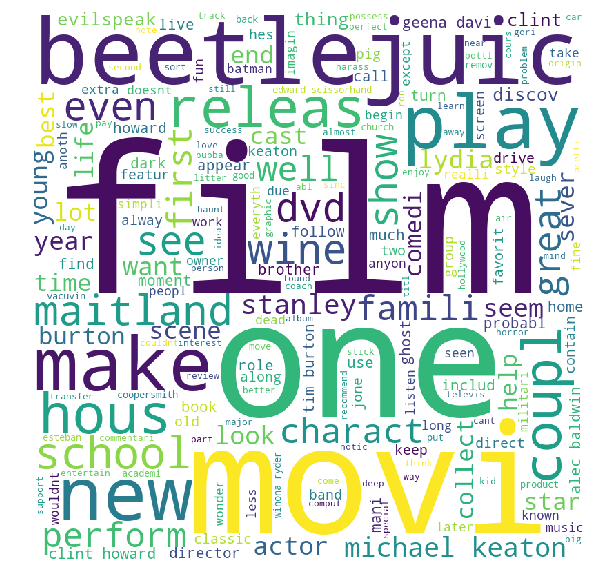

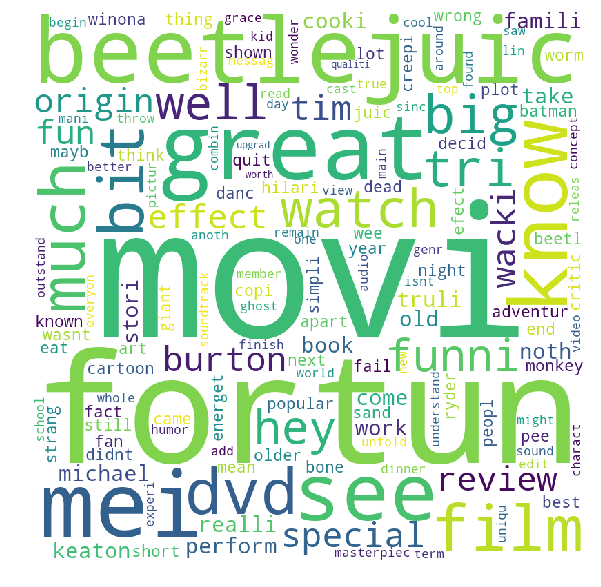

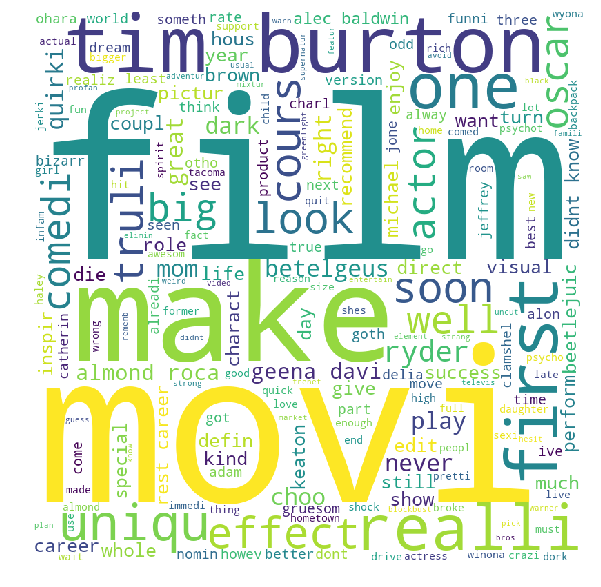

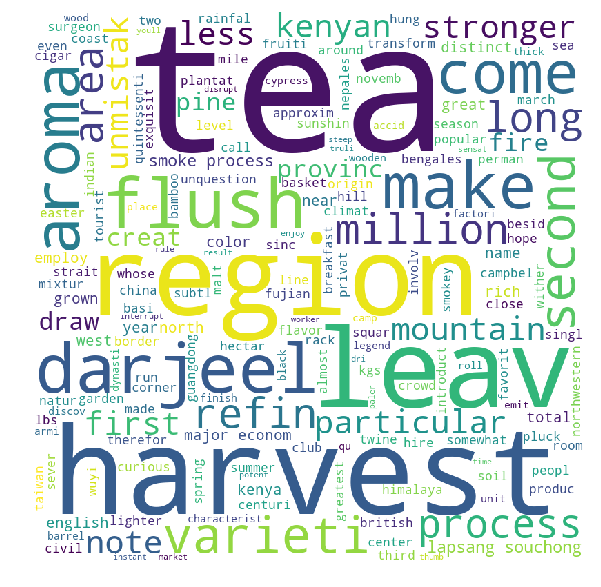

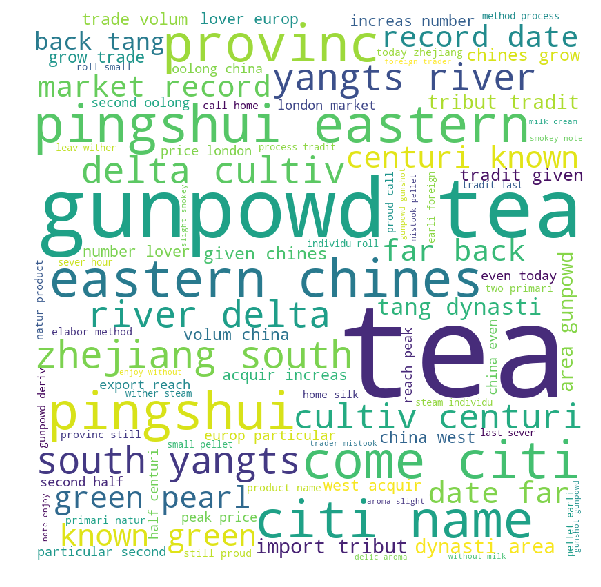

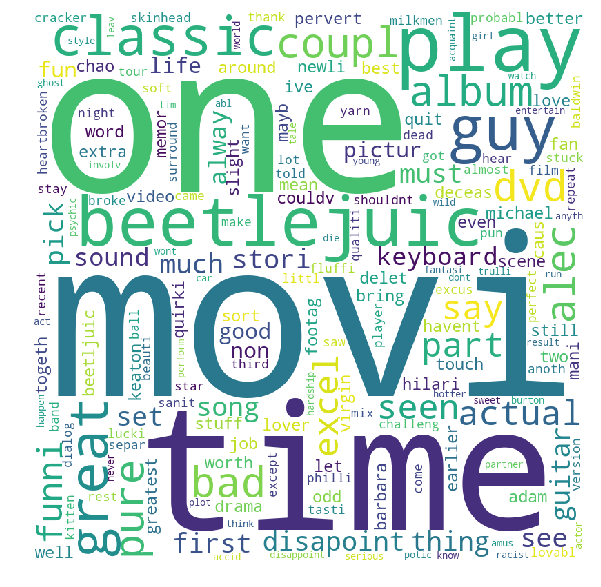

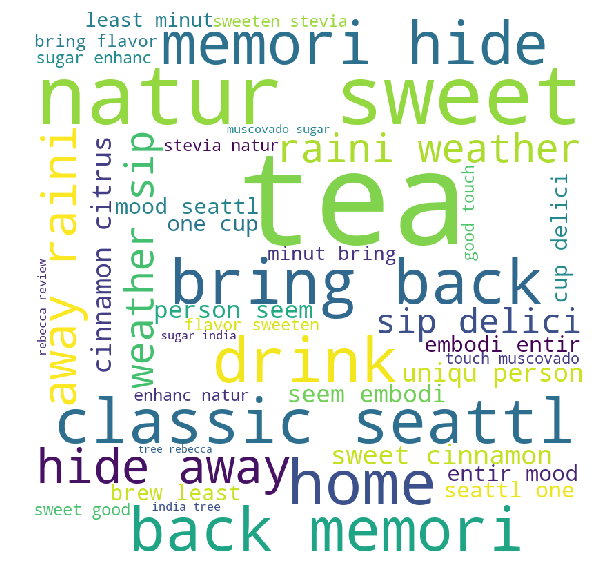

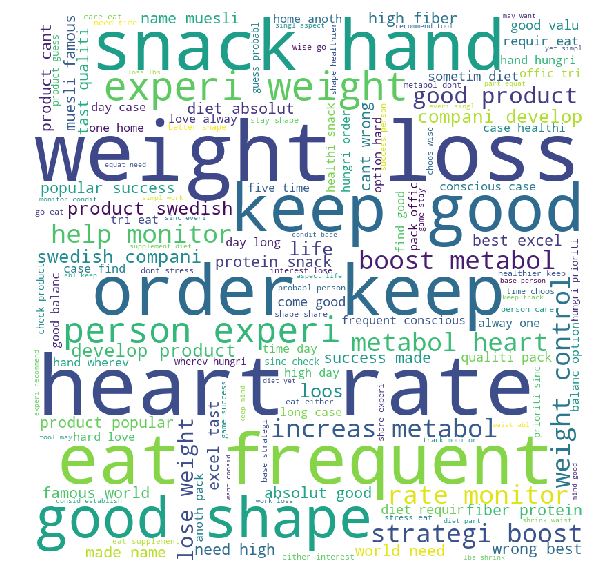

In [419]:
wordcloud_print(clean_text_all_tfidfww2v)

In [420]:
clf_dbs_4_tfidfww2v = DBSCAN(eps=0.5)
labels_tfidfww2v_e4 = clf_dbs_4_tfidfww2v.fit_predict(train_tfidfww2v_1,y_train_1)

In [421]:
print(type(labels_tfidfww2v_e4))
labels_tfidfww2v_e4_df = pd.DataFrame(labels_tfidfww2v_e4)
print(type(labels_tfidfww2v_e4_df))

#matching the number of rows
final3 = final2[0:5000]
print(type(final3))
print(final3.shape)
#final3

#adding the values of labels in the data frame
final4 = final3
print(type(final4))
final4.reindex(columns=[*final4.columns.tolist(), 'labels'],fill_value=1)
final4['labels']=labels_tfidfww2v_e4_df.values

n_clusters_ = len(set(labels_tfidfww2v_e4)) - (1 if -1 in labels_tfidfww2v_e4 else 0)
print ("No. of clusters formed = ",n_clusters_)

final4

<class 'numpy.ndarray'>
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.frame.DataFrame'>
(5000, 11)
<class 'pandas.core.frame.DataFrame'>
No. of clusters formed =  2


,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,CleanedText,labels
138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,1,939340800,EVERY book is educational,this witty little book makes my son laugh at l...,witti littl book make son laugh loud recit car...,-1
138683,150501,0006641040,AJ46FKXOVC7NR,Nicholas A Mesiano,2,2,1,940809600,This whole series is great way to spend time w...,I can remember seeing the show when it aired o...,rememb see show air televis year ago child sis...,-1
417839,451856,B00004CXX9,AIUWLEQ1ADEG5,Elizabeth Medina,0,0,1,944092800,Entertainingl Funny!,Beetlejuice is a well written movie ..... ever...,beetlejuic well written movi everyth excel act...,-1
417859,451878,B00004CXX9,A344SMIA5JECGM,Vincent P. Ross,1,2,1,944438400,A modern day fairy tale,"A twist of rumplestiskin captured on film, sta...",twist rumplestiskin captur film star michael k...,-1
417838,451855,B00004CXX9,AJH6LUC1UT1ON,The Phantom of the Opera,0,0,1,946857600,FANTASTIC!,Beetlejuice is an excellent and funny movie. K...,beetlejuic excel funni movi keaton hilari wack...,-1
417927,451949,B00004CXX9,A1048CYU0OV4O8,Judy L. Eans,2,2,1,947376000,GREAT,THIS IS ONE MOVIE THAT SHOULD BE IN YOUR MOVIE...,one movi movi collect fill comedi action whate...,-1
417847,451864,B00004CXX9,A1B2IZU1JLZA6,Wes,19,23,0,948240000,WARNING: CLAMSHELL EDITION IS EDITED TV VERSION,"I, myself always enjoyed this movie, it's very...",alway enjoy movi funni entertain didnt hesit p...,-1
70688,76882,B00002N8SM,A32DW342WBJ6BX,Buttersugar,0,0,1,948672000,A sure death for flies,I bought a few of these after my apartment was...,bought apart infest fruit fli hour trap mani f...,-1
346141,374450,B00004CI84,ACJR7EQF9S6FP,Jeremy Robertson,2,3,1,951523200,Bettlejuice...Bettlejuice...BETTLEJUICE!,What happens when you say his name three times...,happen say name three time michael keaten star...,-1
417883,451903,B00004CXX9,A2DEE7F9XKP3ZR,jerome,0,1,1,959990400,Research,I'm getting crazy.<p>Is it really impossible t...,get crazi realli imposs today find french vhs ...,-1


In [422]:
clean_text_all_tfidfww2v = list()

#copying all the data rows with label=0
clean_text_cat_0 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 0):
        clean_text_cat_0.append(((final4['CleanedText'].values)[loop1]))     
clean_text_all_tfidfww2v.append(clean_text_cat_0)

#copying all the data rows with label=1
clean_text_cat_1 = list()
for loop1 in range(0,5000):
    if (((final4['labels'].values)[loop1]) == 1):
        clean_text_cat_1.append(((final4['CleanedText'].values)[loop1]))
clean_text_all_tfidfww2v.append(clean_text_cat_1)

In [423]:
print(np.shape(clean_text_all_tfidfww2v))

(2, 5)


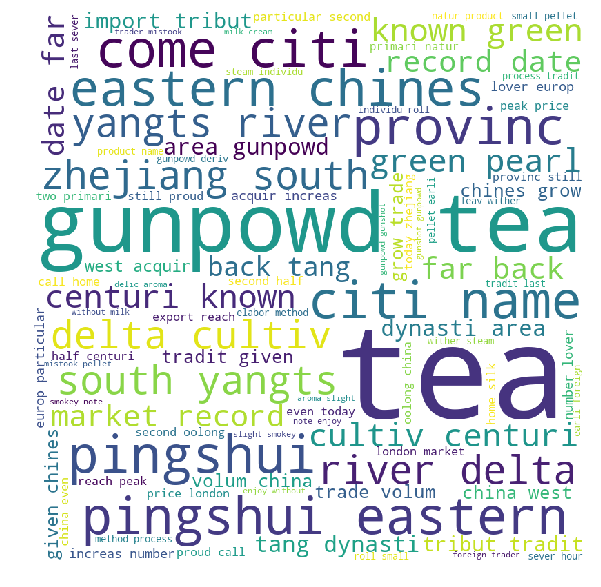

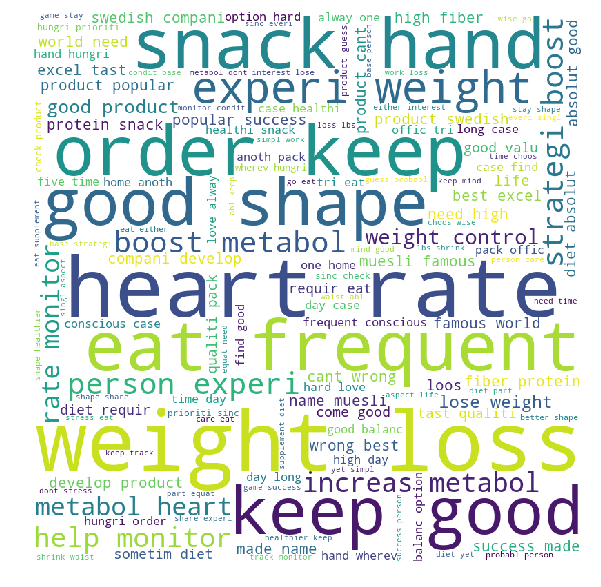

In [424]:
wordcloud_print(clean_text_all_tfidfww2v)

In [425]:
x = PrettyTable()
x.field_names = ["Paramters/Models","BoW", "TFIDF", "AvgW2V", "TFIDF-W-W2V"]

x.add_row(["No. of clusters(best)(KMeans) : ","6","6","6","6" ])
x.add_row(["No. of clusters(taken)(Aggloremative): ", "-","-","2,3,4,5","2,3,4,5"])
x.add_row(["No. of clusters(eps=3)(DBSCAN): ", "-", "-", "1", "1" ])
x.add_row(["No. of clusters(eps=2)(DBSCAN): ", "-", "-", "12", "12" ])
x.add_row(["No. of clusters(eps=1)(DBSCAN): ", "-", "-", "8","8" ])
x.add_row(["No. of clusters(eps=0.5)(DBSCAN): ", "-", "-", "2", "2" ])

print(x)

+-----------------------------------------+-----+-------+---------+-------------+
|             Paramters/Models            | BoW | TFIDF |  AvgW2V | TFIDF-W-W2V |
+-----------------------------------------+-----+-------+---------+-------------+
|     No. of clusters(best)(KMeans) :     |  6  |   6   |    6    |      6      |
| No. of clusters(taken)(Aggloremative):  |  -  |   -   | 2,3,4,5 |   2,3,4,5   |
|     No. of clusters(eps=3)(DBSCAN):     |  -  |   -   |    1    |      1      |
|     No. of clusters(eps=2)(DBSCAN):     |  -  |   -   |    12   |      12     |
|     No. of clusters(eps=1)(DBSCAN):     |  -  |   -   |    8    |      8      |
|    No. of clusters(eps=0.5)(DBSCAN):    |  -  |   -   |    2    |      2      |
+-----------------------------------------+-----+-------+---------+-------------+


In [ ]:
#Rough work
#print(final3[1:4:].ProductId)
#print(final3[1:2:1])
#print((final3['CleanedText'].values)[0])
#print((final3['Text'].values)[0])
#print((final4['labels'].values)[0])
#labels_2[38400-1]
#final4.loc[2,:]   

In [ ]:
#copying all the data rows with label=1    Rough
clean_text_cat_1 = list()
clean_test_all_1 = np.array(clean_test_all)
print(type(clean_test_all_1))
loop3 = 0
loop2 = 0
for loop1 in range(0,38400):
    if (loop2<6):
        if (((final4['labels'].values)[loop1]) == loop2):
            clean_text_cat_1.append(((final4['CleanedText'].values)[loop1]))
        #clean_test_all_1[loop3].append(clean_text_cat_1)
        np.concatenate((clean_test_all_1,clean_text_cat_1))
        loop3+=1
        clean_text_cat_1 = list()
    loop2+=1